# Estudio de técnicas de modelización analítica en el mercado de divisas

## 1. Preprocessing y organización del proyecto

Para comenzar, importaré las librerías que se utilizarán a lo largo del estudio, desde las más básicas hasta las utilizadas en el desarrollo de los métodos de machine learning.

In [59]:
# Tratamiento de datos
# ==============================================================================
import numpy as np
import pandas as pd
import scipy.stats as ss
from scipy.stats import shapiro

# Gráficos
# ==============================================================================
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
%matplotlib inline
plt.style.use('fivethirtyeight')
#pip install style
#style.use('ggplot') or plt.style.use('ggplot')
plt.rcParams['image.cmap'] = "bwr"
plt.rcParams['savefig.bbox'] = "tight"
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Modelado
# ==============================================================================
from sklearn.datasets import make_blobs
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
import multiprocessing
from sklearn.neural_network import MLPRegressor
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.compose import make_column_selector
from sklearn.pipeline import Pipeline
from sklearn import set_config

# Indicadores
# ==============================================================================
# pip install pandas_ta
import pandas_ta as ta

# Configuración warnings
# ==============================================================================
import warnings
warnings.filterwarnings('ignore')

# Métricas
# ==============================================================================
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import make_scorer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Algoritmos
# ==============================================================================
import statsmodels.api as sm
from statsmodels.formula.api import logit, glm, ols
import statsmodels.formula.api as smf
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor

Cargamos nuestra base de datos descargada previamente de https://es.investing.com/ en un dataframe que nos permita trabajar con los datos.

In [60]:
data = pd.read_csv('eurusdg.csv',sep=';',encoding='utf-8')
data=data.drop('% var.',axis=1)
data

,Fecha,Último,Apertura,Máximo,Mínimo,var
0,27/06/2022,1.0604,1.0567,1.0615,1.0550,0.35
1,26/06/2022,1.0567,1.0555,1.0575,1.0552,0.10
2,24/06/2022,1.0556,1.0526,1.0572,1.0511,0.31
3,23/06/2022,1.0523,1.0567,1.0582,1.0482,-0.40
4,22/06/2022,1.0565,1.0527,1.0606,1.0468,0.38
...,...,...,...,...,...,...
11019,03/01/1980,1.5177,1.5177,1.5177,1.5177,0.18
11020,02/01/1980,1.5149,1.5149,1.5149,1.5149,0.45
11021,31/12/1979,1.5081,1.5081,1.5081,1.5081,0.03
11022,28/12/1979,1.5076,1.5076,1.5076,1.5076,0.01


Observamos que la serie temporal se encuentra al revés, los datos más nuevos se encuentran al principio y los antiguos al final. Hay que darle la vuelta a esto. 

In [61]:
data['Fecha'] = pd.to_datetime(data['Fecha'], format='%d/%m/%Y') 
data = data.sort_values(by='Fecha')
data

,Fecha,Último,Apertura,Máximo,Mínimo,var
11023,1979-12-27,1.5074,1.5074,1.5074,1.5074,0.41
11022,1979-12-28,1.5076,1.5076,1.5076,1.5076,0.01
11021,1979-12-31,1.5081,1.5081,1.5081,1.5081,0.03
11020,1980-01-02,1.5149,1.5149,1.5149,1.5149,0.45
11019,1980-01-03,1.5177,1.5177,1.5177,1.5177,0.18
...,...,...,...,...,...,...
4,2022-06-22,1.0565,1.0527,1.0606,1.0468,0.38
3,2022-06-23,1.0523,1.0567,1.0582,1.0482,-0.40
2,2022-06-24,1.0556,1.0526,1.0572,1.0511,0.31
1,2022-06-26,1.0567,1.0555,1.0575,1.0552,0.10


Ya, con la serie temporal en orden, representémosla.

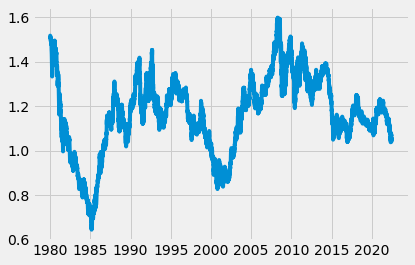

In [62]:
serie = pd.DataFrame({'Fecha':data['Fecha'], 'Último':data['Último']})
plt.plot(data['Fecha'],data['Último'])

Una vez un profesor me dijo que si no eras capaz de ser tú capaz de trazar con el dedo e intuitivamente el recorrido de una serie temporal en el futuro, tenemos un problema para predecirla. Como se puede ver esta serie temporal parece completamente impredecible. Ya podemos ir observando algunos de los problemas a los que nos enfrentamos.

Hagamos una pequeña exploración de la calidad de los datos.

In [63]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11024 entries, 11023 to 0
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Fecha     11024 non-null  datetime64[ns]
 1   Último    11024 non-null  float64       
 2   Apertura  11024 non-null  float64       
 3   Máximo    11024 non-null  float64       
 4   Mínimo    11024 non-null  float64       
 5   var       11024 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 602.9 KB


Observemos que, al menos, el dataset no presenta nulos y todas las variables son de tipo float64. Esto nos va a reducir notablemente el preprocessing pues no se va a tener que hacer la imputación de missings ni la transformación de variables categóricas.

In [64]:
data.describe()

,Último,Apertura,Máximo,Mínimo,var
count,11024.000000,11024.000000,11024.000000,11024.000000,11024.000000
mean,1.166065,1.166059,1.170573,1.161447,-0.001243
std,0.171122,0.171111,0.172310,0.169930,0.622501
min,0.644400,0.644400,0.644400,0.644400,-3.620000
25%,1.084275,1.084200,1.089200,1.080000,-0.350000
50%,1.175100,1.175100,1.179700,1.170350,0.000000
75%,1.281600,1.281325,1.287725,1.275000,0.340000
max,1.598800,1.600000,1.603900,1.586500,4.840000


### Creación de nuevas variables explicativas

A partir de los datos que tenemos podemos crear ciertas variables que van a ofrecer algo más de información sobre las variaciones del mercado.

#### Pips

In [65]:
data['Pips'] = (data['Último']-data['Apertura'])*10000
data.tail()

,Fecha,Último,Apertura,Máximo,Mínimo,var,Pips
4,2022-06-22,1.0565,1.0527,1.0606,1.0468,0.38,38.0
3,2022-06-23,1.0523,1.0567,1.0582,1.0482,-0.40,-44.0
2,2022-06-24,1.0556,1.0526,1.0572,1.0511,0.31,30.0
1,2022-06-26,1.0567,1.0555,1.0575,1.0552,0.10,12.0
0,2022-06-27,1.0604,1.0567,1.0615,1.0550,0.35,37.0


#### Variación

In [66]:
data['Variacion'] = (data['Máximo']-data['Mínimo'])*10000
data.tail()

,Fecha,Último,Apertura,Máximo,Mínimo,var,Pips,Variacion
4,2022-06-22,1.0565,1.0527,1.0606,1.0468,0.38,38.0,138.0
3,2022-06-23,1.0523,1.0567,1.0582,1.0482,-0.40,-44.0,100.0
2,2022-06-24,1.0556,1.0526,1.0572,1.0511,0.31,30.0,61.0
1,2022-06-26,1.0567,1.0555,1.0575,1.0552,0.10,12.0,23.0
0,2022-06-27,1.0604,1.0567,1.0615,1.0550,0.35,37.0,65.0


## 1979 - Primera prueba

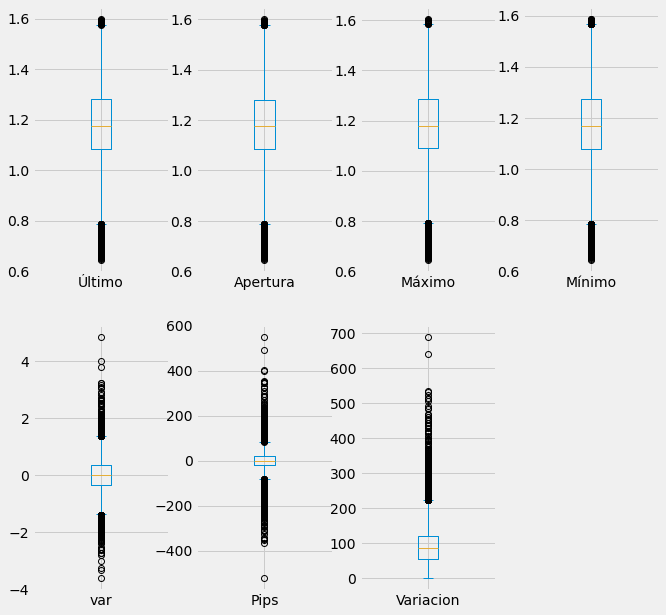

In [67]:
data.plot(figsize=(10,10),kind='box', subplots=True,layout=(2,4),sharex=False, sharey=False)
plt.show()

Observemos ciertos outliers a ver si podemos obtener algo de información.

In [68]:
data[data['var']>3.5]

,Fecha,Último,Apertura,Máximo,Mínimo,var,Pips,Variacion
9716,1985-02-27,0.6703,0.6703,0.6703,0.6703,4.02,0.0,0.0
9573,1985-09-23,0.8064,0.8064,0.8064,0.8064,4.84,0.0,0.0
3464,2009-03-18,1.3508,1.3015,1.3520,1.2987,3.80,493.0,533.0


In [69]:
data[data['var']<-3]

,Fecha,Último,Apertura,Máximo,Mínimo,var,Pips,Variacion
8980,1988-01-15,1.2254,1.2254,1.2662,1.2241,-3.25,0.0,421.0
7943,1992-01-09,1.3040,1.3040,1.3490,1.2985,-3.33,0.0,505.0
7764,1992-09-16,1.2980,1.3503,1.3523,1.2883,-3.62,-523.0,640.0


In [70]:
data[data['Variacion']>600]

,Fecha,Último,Apertura,Máximo,Mínimo,var,Pips,Variacion
7764,1992-09-16,1.298,1.3503,1.3523,1.2883,-3.62,-523.0,640.0
7763,1992-09-17,1.327,1.2722,1.3341,1.2653,2.23,548.0,688.0


https://investorsconundrum.com/2012/05/23/6221/

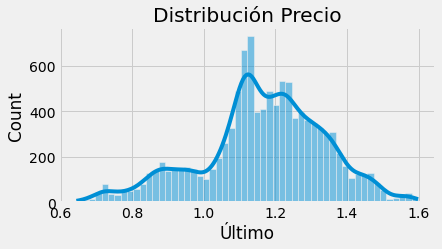

In [71]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 3))
sns.histplot(data=data, x='Último', kde=True,ax=ax)
ax.set_title("Distribución Precio")
ax.set_xlabel('Último');

In [72]:

shapiro (data['Último'])

ShapiroResult(statistic=0.9845447540283203, pvalue=7.305676819209377e-33)

### Creación de variables a predecir

In [73]:
data['UpDown'] = data['Último']>=data['Apertura']  
data['UpDown'] = data['UpDown'].replace(True,1)  
data['UpDown'] = data['UpDown'].replace(False,0)  

In [74]:
data['UpDownPred'] = data['UpDown']
for i in range(1, len(data['UpDown'])):
    data['UpDownPred'][i] = data['UpDown'][i-1]

In [75]:
data['ÚltimoPred'] = data['Último']
for i in range(1, len(data['ÚltimoPred'])):
    data['ÚltimoPred'][i] = data['Último'][i-1]

In [76]:
# Eliminamos la última observación pues no tenemos el dato del día siguiente
data=data.drop(0)
data.tail(5)

,Fecha,Último,Apertura,Máximo,Mínimo,var,Pips,Variacion,UpDown,UpDownPred,ÚltimoPred
5,2022-06-21,1.0525,1.0510,1.0583,1.0508,0.15,15.0,75.0,1,1,1.0565
4,2022-06-22,1.0565,1.0527,1.0606,1.0468,0.38,38.0,138.0,1,0,1.0523
3,2022-06-23,1.0523,1.0567,1.0582,1.0482,-0.40,-44.0,100.0,0,1,1.0556
2,2022-06-24,1.0556,1.0526,1.0572,1.0511,0.31,30.0,61.0,1,1,1.0567
1,2022-06-26,1.0567,1.0555,1.0575,1.0552,0.10,12.0,23.0,1,1,1.0604


<AxesSubplot:>

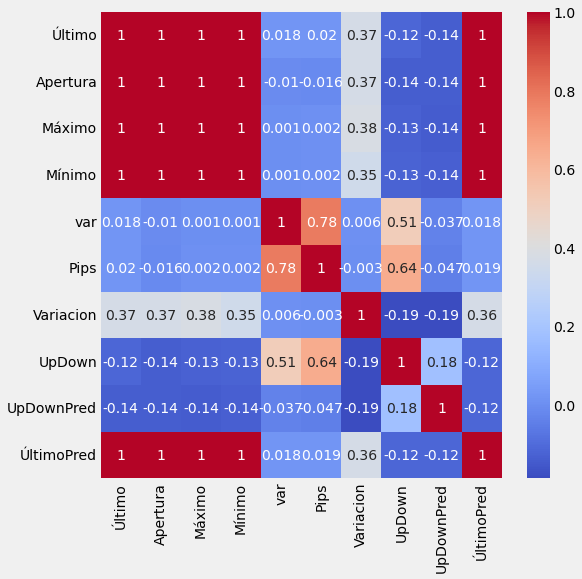

In [77]:
plt.figure(figsize=(8,8))
sns.heatmap(data.corr().round(3),annot=True,cmap='coolwarm')

Tenemos unas correlaciones muy bajas para la variable a predecir UpDownPred, eso va a hacer que los métodos de predicción lineales nos den resultados muy malos. En este primer ejemplo probaremos directamente con una red neuronal.

No hay patrones entre las variables, no se aprecia homocedastticidad entre nuestra variable objetivo y ninguna de nuestras variables descriptivas.

In [78]:
data_Price = data['UpDownPred']\
        .value_counts(normalize=True)\
        .mul(100).rename('percent').reset_index()

data_Price_conteo =data['UpDownPred'].value_counts().reset_index()
data_Price_pc = pd.merge(data_Price, 
                                  data_Price_conteo, on=['index'], how='inner')

fig = px.histogram(data_Price_pc, x="index", y=['percent'])
fig.show()

Hay casi un 65% de observaciones que presentan un 1 en UpDownPred. Esto va a hacer que para que nuestro modelo sea válido se debe superar ese umbral de referencia. Pues si no, un modelo que diga siempre unos obtendría un porcentaje de acierto del 64'89%. Más adelante haremos transformaciones a los datos para cambiar esto.

## Estandarización y train-test 

In [79]:
# Debemos tirar la variable fecha
fechas=data['Fecha']
data= data.drop('Fecha', axis=1)

In [80]:
escala = StandardScaler()
a = escala.fit_transform(data.drop(["UpDownPred", 'ÚltimoPred'],axis=1))
datastd = pd.DataFrame(a, columns= data.drop(["UpDownPred",'ÚltimoPred'],axis=1).columns)
aux1 = pd.DataFrame(data['UpDownPred'])
aux1.reset_index(inplace=True)
aux2 = pd.DataFrame(data['ÚltimoPred'])
aux2.reset_index(inplace=True)
datastd['UpDownPred']=aux1['UpDownPred']
datastd['ÚltimoPred']=aux2['ÚltimoPred']
datastd.std()

Último        1.000045
Apertura      1.000045
Máximo        1.000045
Mínimo        1.000045
var           1.000045
Pips          1.000045
Variacion     1.000045
UpDown        1.000045
UpDownPred    0.477331
ÚltimoPred    0.171099
dtype: float64

In [81]:
# Reparto de datos en train y test
# ==============================================================================


X_train, X_test, y_train, y_test = train_test_split(
                                        datastd.drop(['UpDownPred', 'ÚltimoPred'],axis=1), 
                                        datastd['UpDownPred'], 
                                        test_size=0.05,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [82]:
print("Partición de entrenamento")
print("-----------------------")
display(y_train.describe())
display(X_train.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(y_test.describe())
display(X_test.describe())

Partición de entrenamento
-----------------------


count    10471.000000
mean         0.657148
std          0.474685
min          0.000000
25%          0.000000
50%          1.000000
75%          1.000000
max          1.000000
Name: UpDownPred, dtype: float64

,Último,Apertura,Máximo,Mínimo,var,Pips,Variacion,UpDown
count,10471.000000,10471.000000,10471.000000,10471.000000,10471.000000,10471.000000,10471.000000,10471.000000
mean,0.002502,0.002436,0.002631,0.002211,0.000157,0.001843,0.011911,0.017248
std,1.024058,1.024069,1.024129,1.024012,1.014330,1.009893,1.018633,0.994502
min,-3.048595,-3.048766,-3.053757,-3.042822,-5.813284,-8.601641,-1.402184,-1.359529
25%,-0.503298,-0.501253,-0.499300,-0.504961,-0.576273,-0.313384,-0.557163,-1.359529
50%,0.057421,0.056289,0.057556,0.052044,0.002048,-0.000929,-0.080879,0.735549
75%,0.720116,0.716398,0.724681,0.713507,0.548239,0.327970,0.502954,0.735549
max,2.528793,2.536009,2.514803,2.501338,7.777242,9.010906,9.168257,0.735549


 
Partición de test
-----------------------


count    552.000000
mean       0.492754
std        0.500401
min        0.000000
25%        0.000000
50%        0.000000
75%        1.000000
max        1.000000
Name: UpDownPred, dtype: float64

,Último,Apertura,Máximo,Mínimo,var,Pips,Variacion,UpDown
count,552.000000,552.000000,552.000000,552.000000,552.000000,552.000000,552.000000,552.000000
mean,-0.047455,-0.046216,-0.049901,-0.041946,-0.002987,-0.034951,-0.225946,-0.327172
std,0.275624,0.275073,0.270127,0.279752,0.674629,0.790270,0.484845,1.048379
min,-0.749033,-0.749050,-0.745663,-0.744182,-2.022073,-2.336113,-1.294636,-1.359529
25%,-0.216364,-0.215615,-0.217100,-0.211893,-0.399564,-0.494278,-0.572527,-1.359529
50%,0.043396,0.044308,0.037243,0.053810,0.002048,-0.033819,-0.311339,-1.359529
75%,0.143764,0.144976,0.132713,0.149439,0.435788,0.492419,-0.004059,0.735549
max,0.388184,0.389412,0.373853,0.382776,2.588424,2.827603,1.993263,0.735549


La partición no nos deja con datasets con las mismas propiedades estadísticas pues lo que hacemos es separar los años 2021 y 2022 como test y dejar el resto como entrenamiento. 

Ya podemos crear nuestra primera red neuronal, utilizaremos validación cruzada y realizaremos un grid search para descubrir qué red neuronal da mejores resultados y cuáles son los mejores hiperparámetros.

In [83]:
# Espacio de búsqueda de cada hiperparámetro
# ==============================================================================
param_distributions = {
    'modelo__hidden_layer_sizes': [(10,10,10,10),(10,20,20,10),(10,10,10,10,10)],
    'modelo__alpha': np.logspace(-3, 3, 10),
    'modelo__learning_rate_init': [0.001, 0.01],
}

# Pipeline que definirá el modelo
# ==============================================================================
pipe = Pipeline([('modelo', MLPRegressor(solver = 'adam', activation = 'logistic', max_iter= 200))])

# Búsqueda por validación cruzada
# ==============================================================================
grid = RandomizedSearchCV(
        estimator  = pipe,
        param_distributions = param_distributions,
        n_iter     = 50,
        scoring    = 'neg_mean_squared_error',
        n_jobs     = multiprocessing.cpu_count() - 1,
        cv         = 5, 
        verbose    = 0,
        random_state = 43,
        return_train_score = True
       )

grid.fit(X = X_train, y = y_train)

# Resultados del grid
# ==============================================================================
resultados = pd.DataFrame(grid.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False)\
    .head(10)


,param_modelo__learning_rate_init,param_modelo__hidden_layer_sizes,param_modelo__alpha,mean_test_score,std_test_score,mean_train_score,std_train_score
43,0.01,"(10, 10, 10, 10)",0.001,-0.200644,0.066726,-0.177052,0.024848
9,0.01,"(10, 10, 10, 10, 10)",0.001,-0.207974,0.059448,-0.178306,0.024767
19,0.01,"(10, 20, 20, 10)",0.001,-0.211658,0.055033,-0.177565,0.025486
25,0.01,"(10, 10, 10, 10)",0.004642,-0.221837,0.048969,-0.180446,0.025911
32,0.01,"(10, 20, 20, 10)",0.004642,-0.225947,0.047693,-0.180954,0.025798
22,0.001,"(10, 20, 20, 10)",0.004642,-0.240306,0.039559,-0.189494,0.030261
14,0.01,"(10, 10, 10, 10)",0.021544,-0.240937,0.027589,-0.186708,0.032644
11,0.01,"(10, 20, 20, 10)",2.154435,-0.241280,0.054972,-0.223333,0.014399
48,0.01,"(10, 10, 10, 10, 10)",0.1,-0.241792,0.059170,-0.223281,0.014395
23,0.01,"(10, 20, 20, 10)",0.021544,-0.242133,0.032993,-0.187394,0.032367


In [84]:
neural_final = grid.best_estimator_
neural_final['modelo'].get_params()

{'activation': 'logistic',
 'alpha': 0.001,
 'batch_size': 'auto',
 'beta_1': 0.9,
 'beta_2': 0.999,
 'early_stopping': False,
 'epsilon': 1e-08,
 'hidden_layer_sizes': (10, 10, 10, 10),
 'learning_rate': 'constant',
 'learning_rate_init': 0.01,
 'max_fun': 15000,
 'max_iter': 200,
 'momentum': 0.9,
 'n_iter_no_change': 10,
 'nesterovs_momentum': True,
 'power_t': 0.5,
 'random_state': None,
 'shuffle': True,
 'solver': 'adam',
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': False,
 'warm_start': False}

Nos sale que los mejores resultados los obtenemos con:

    1. Una red neuronal de 4 capas ocultas de 10 neuronas cada una
    2. Un valor de alpha de 0.001
    3. Un learning_rate_init de 0.01

In [85]:
neural_final_pred = neural_final.predict(X = X_test)

In [86]:
def acc(test, predicciones):
    test_rounded = list(np.round(test))
    acc = np.mean(np.array(test)==np.round(predicciones))*100
    return np.round(acc, 3)

#Recogemos esto en dos funciones:

def metricas(test, pred):
    # Error Absoluto Medio
    print("Mean Absolute Error", mean_absolute_error(test, pred))
    # Error Cuadrado Medio
    print("Mean squared error:", mean_squared_error(test, pred))
    print("Root Mean squared error:", np.sqrt(mean_squared_error(test, pred)))
    # Evaluamos el puntaje de varianza (siendo 1.0 el mejor posible)
    print('Variance score: %.2f' % r2_score(test, pred))
    
def acc_funct(test,pred):
    print('Acertamos exactamente el', acc(test, pred),'% de las predicciones.')

In [87]:
#METRICAS 

metricas(y_test, neural_final_pred)

acc_funct(y_test, neural_final_pred)

Mean Absolute Error 0.5008280999349366
Mean squared error: 0.2627447909359929
Root Mean squared error: 0.5125863741224428
Variance score: -0.05
Acertamos exactamente el 49.275 % de las predicciones.


In [88]:
predict = []
for i in range(len(neural_final_pred)-1):
    predict.append([list(y_test)[i], neural_final_pred[i]])
predict

[[1, 0.5588988210905708],
 [1, 0.5263304366949253],
 [1, 0.5721022846947841],
 [0, 0.5281250760049951],
 [0, 0.6089427757960708],
 [0, 0.6193098140515552],
 [1, 0.5488952493325421],
 [1, 0.526381536617764],
 [1, 0.5311764151941496],
 [1, 0.526544974309221],
 [1, 0.532534057245108],
 [1, 0.5290409878158531],
 [1, 0.5285857960928653],
 [1, 0.5268099281714806],
 [0, 0.5259273713196619],
 [1, 0.6143902086604653],
 [1, 0.7586645353378745],
 [1, 0.5268159111714545],
 [0, 0.5278742693413805],
 [0, 0.6174428484705723],
 [1, 0.6106956854206709],
 [0, 0.5257529940431673],
 [0, 0.6140376252262674],
 [0, 0.5944932518923387],
 [0, 0.6157778249073242],
 [1, 0.6064163341695703],
 [1, 0.526895001620515],
 [0, 0.5265754700281853],
 [0, 0.6210651307113304],
 [0, 0.6126127029320192],
 [1, 0.5441492317401886],
 [0, 0.5457028523480263],
 [1, 0.5705282777630889],
 [0, 0.5335849004265796],
 [1, 0.5786972349325394],
 [1, 0.5890704868673431],
 [0, 0.5259981559621207],
 [1, 0.614273194564718],
 [0, 0.5268270112

In [89]:
total79 = neural_final.predict(X = datastd.drop(['UpDownPred', 'ÚltimoPred'],axis=1))

In [90]:
prediction = pd.DataFrame()
prediction['date'] = fechas
prediction['open'] = data['Apertura']
prediction['real'] = data['UpDownPred']
prediction['79'] = np.round(total79)
prediction['prob_79']= total79
prediction

,date,open,real,79,prob_79
11023,1979-12-27,1.5074,1,1.0,1.130609
11022,1979-12-28,1.5076,1,1.0,1.109631
11021,1979-12-31,1.5081,1,1.0,1.109652
11020,1980-01-02,1.5149,1,1.0,1.133229
11019,1980-01-03,1.5177,1,1.0,1.119022
...,...,...,...,...,...
5,2022-06-21,1.0510,1,1.0,0.538146
4,2022-06-22,1.0527,0,1.0,0.527038
3,2022-06-23,1.0567,1,1.0,0.614322
2,2022-06-24,1.0526,1,1.0,0.532055


In [91]:
acc_funct(prediction['real'], prediction['79'])

Acertamos exactamente el 64.892 % de las predicciones.


In [92]:
print('Acertamos exactamente el', sum(prediction[prediction['prob_79'] > 0.9]['real'])*100/len(prediction[prediction['prob_79'] > 0.9]['real']),'% de las predicciones.')

Acertamos exactamente el 98.18796068796068 % de las predicciones.


In [93]:
prediction[prediction['prob_79'] > 0.9]

,date,open,real,79,prob_79
11023,1979-12-27,1.5074,1,1.0,1.130609
11022,1979-12-28,1.5076,1,1.0,1.109631
11021,1979-12-31,1.5081,1,1.0,1.109652
11020,1980-01-02,1.5149,1,1.0,1.133229
11019,1980-01-03,1.5177,1,1.0,1.119022
...,...,...,...,...,...
283,2021-05-27,1.2192,0,1.0,0.980074
262,2021-06-25,1.1932,0,1.0,0.911713
224,2021-08-18,1.1710,0,1.0,0.969006
183,2021-10-14,1.1593,1,1.0,0.909238


Veamos con más de 0.6 de acierto:

In [94]:
print('Acertamos exactamente el', sum(prediction[prediction['prob_79'] > 0.6]['real'])*100/len(prediction[prediction['prob_79'] > 0.6]['real']),'% de las predicciones.')

Acertamos exactamente el 77.16975111678366 % de las predicciones.


In [95]:
six=list()
for i in predict:
    if i[1]>0.9:
        six.append(i[0])
sum(six)/len(six)

0.4444444444444444

In [96]:
prediction[prediction['prob_79'] > 0.6]

,date,open,real,79,prob_79
11023,1979-12-27,1.5074,1,1.0,1.130609
11022,1979-12-28,1.5076,1,1.0,1.109631
11021,1979-12-31,1.5081,1,1.0,1.109652
11020,1980-01-02,1.5149,1,1.0,1.133229
11019,1980-01-03,1.5177,1,1.0,1.119022
...,...,...,...,...,...
12,2022-06-10,1.0617,0,1.0,0.620925
11,2022-06-13,1.0513,1,1.0,0.626602
10,2022-06-14,1.0411,1,1.0,0.690442
7,2022-06-17,1.0548,1,1.0,0.614206


Vamos a hacer la prueba ahora para predecir el precio de cierre.

In [97]:
# Reparto de datos en train y test
# ==============================================================================
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
                                        datastd.drop(['UpDownPred', 'ÚltimoPred'],axis=1), 
                                        datastd['ÚltimoPred'], 
                                        test_size=0.05,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [98]:
# Espacio de búsqueda de cada hiperparámetro
# ==============================================================================
param_distributions = {
    'modelo__hidden_layer_sizes': [(10,20,30),(10, 20, 20, 10), (10,20,30,40),(10,20,30,40,50)],
    'modelo__alpha': np.logspace(-3, 3, 10),
    'modelo__learning_rate_init': [0.001, 0.01],
}

# Pipeline que definirá el modelo
# ==============================================================================
pipe = Pipeline([('modelo', MLPRegressor(solver = 'adam', max_iter= 200))])

# Búsqueda por validación cruzada
# ==============================================================================
grid = RandomizedSearchCV(
        estimator  = pipe,
        param_distributions = param_distributions,
        n_iter     = 50,
        scoring    = 'neg_mean_squared_error',
        n_jobs     = multiprocessing.cpu_count() - 1,
        cv         = 5, 
        verbose    = 0,
        random_state = 43,
        return_train_score = True
       )

grid.fit(X = X_train, y = y_train)

# Resultados del grid
# ==============================================================================
resultados = pd.DataFrame(grid.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False)\
    .head(10)


,param_modelo__learning_rate_init,param_modelo__hidden_layer_sizes,param_modelo__alpha,mean_test_score,std_test_score,mean_train_score,std_train_score
0,0.01,"(10, 20, 30, 40, 50)",0.021544,-0.000268,0.000333,-0.000074,0.000008
26,0.01,"(10, 20, 20, 10)",0.021544,-0.000295,0.000327,-0.000089,0.000015
12,0.01,"(10, 20, 30, 40, 50)",0.004642,-0.000324,0.000350,-0.000083,0.000012
32,0.01,"(10, 20, 20, 10)",0.1,-0.000375,0.000567,-0.000075,0.000006
15,0.01,"(10, 20, 30, 40)",0.001,-0.000455,0.000352,-0.000103,0.000016
11,0.01,"(10, 20, 30, 40)",0.004642,-0.000460,0.000407,-0.000118,0.000020
37,0.01,"(10, 20, 30, 40)",0.1,-0.000637,0.001042,-0.000084,0.000015
27,0.001,"(10, 20, 30, 40, 50)",0.021544,-0.000641,0.000561,-0.000198,0.000052
36,0.001,"(10, 20, 20, 10)",0.1,-0.000652,0.000981,-0.000102,0.000008
46,0.001,"(10, 20, 30, 40)",0.1,-0.000657,0.000988,-0.000093,0.000020


In [99]:
neural_final = grid.best_estimator_
neural_final_pred = neural_final.predict(X = X_test)

In [100]:
datastd['ÚltimoPred']

0        1.5076
1        1.5081
2        1.5149
3        1.5177
4        1.5129
          ...  
11018    1.0565
11019    1.0523
11020    1.0556
11021    1.0567
11022    1.0604
Name: ÚltimoPred, Length: 11023, dtype: float64

In [101]:
total79close = neural_final.predict(X = datastd.drop(['UpDownPred', 'ÚltimoPred'],axis=1))
prediction['realClose'] = data['ÚltimoPred']
prediction['79Close'] = np.round(total79close,4)
prediction

,date,open,real,79,prob_79,realClose,79Close
11023,1979-12-27,1.5074,1,1.0,1.130609,1.5076,1.5020
11022,1979-12-28,1.5076,1,1.0,1.109631,1.5081,1.5005
11021,1979-12-31,1.5081,1,1.0,1.109652,1.5149,1.5010
11020,1980-01-02,1.5149,1,1.0,1.133229,1.5177,1.5095
11019,1980-01-03,1.5177,1,1.0,1.119022,1.5129,1.5111
...,...,...,...,...,...,...,...
5,2022-06-21,1.0510,1,1.0,0.538146,1.0565,1.0532
4,2022-06-22,1.0527,0,1.0,0.527038,1.0523,1.0512
3,2022-06-23,1.0567,1,1.0,0.614322,1.0556,1.0521
2,2022-06-24,1.0526,1,1.0,0.532055,1.0567,1.0555


In [102]:
from sklearn.metrics import mean_squared_error, r2_score

def acc(test, predicciones):
    test_rounded = list(np.round(test,4))
    acc = np.mean(np.array(test_rounded)==np.round(predicciones,4))*100
    return np.round(acc, 3)

def acc_5(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,5):
            interval.append(i-n/10000)
            interval.append(i+n/10000)
        acc.append(np.round(interval,4).__contains__(np.round(predicciones[j],4)))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_10(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,10):
            interval.append(i-n/10000)
            interval.append(i+n/10000)
        acc.append(np.round(interval,4).__contains__(np.round(predicciones[j],4)))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_25(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,25):
            interval.append(i-n/10000)
            interval.append(i+n/10000)
        acc.append(np.round(interval,4).__contains__(np.round(predicciones[j],4)))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_50(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,50):
            interval.append(i-n/10000)
            interval.append(i+n/10000)
        acc.append(np.round(interval,4).__contains__(np.round(predicciones[j],4)))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

#Recogemos esto en dos funciones:
def metricas(test, pred):
    # Error Absoluto Medio
    print("Mean Absolute Error", metrics.mean_absolute_error(test, pred))
    # Error Cuadrado Medio
    print("Mean squared error:", metrics.mean_squared_error(test, pred))
    print("Root Mean squared error:", np.sqrt(metrics.mean_squared_error(test, pred)))
    # Evaluamos el puntaje de varianza (siendo 1.0 el mejor posible)
    print('Variance score: %.2f' % r2_score(test, pred))
    
def acc_funct(test,pred):
    print('Acertamos exactamente el', acc(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 5 pips el', acc_5(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 10 pips el', acc_10(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 25 pips el', acc_25(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 50 pips el', acc_50(test, pred),'% de las predicciones.')

In [103]:
acc_funct(y_test, neural_final_pred)

Acertamos exactamente el 0.725 % de las predicciones.
Acertamos con un margen de 5 pips el 4.167 % de las predicciones.
Acertamos con un margen de 10 pips el 8.877 % de las predicciones.
Acertamos con un margen de 25 pips el 26.993 % de las predicciones.
Acertamos con un margen de 50 pips el 54.529 % de las predicciones.


In [104]:
acc_funct(list(prediction['realClose']), list(prediction['79Close']))

Acertamos exactamente el 0.626 % de las predicciones.
Acertamos con un margen de 5 pips el 5.026 % de las predicciones.
Acertamos con un margen de 10 pips el 10.396 % de las predicciones.
Acertamos con un margen de 25 pips el 27.016 % de las predicciones.
Acertamos con un margen de 50 pips el 51.229 % de las predicciones.


Problema: Se basa mucho en los datos de hace 40 años. Y para los datos recientes falla mucho, no es un modelo fiable. 

Vamos a hacer varias cosas para mejorar esto:

    
    1. Crearemos un API para recoger los datos directamente de internet y que sea más fácil actualizarlos.
    2. Recortaremos los datos para sólo utilizar desde el 2009 (después de la crisis de 2008).
    3. Introduciremos nuevas variables que representarán diferentes indicadores utilizados comúnmente por los inversores.

## 1. API

In [105]:
# pip install tradermade
import tradermade as tm

# set api key
tm.set_rest_api_key("FuaII8unA_TSV7v0WCqv")

In [106]:
# Obtengamos los datos deseados
#df = pd.DataFrame()
#for i in range(2009, 2022):  
#    x = tm.timeseries(currency='EURUSD', start=str(i)+"-08-11", end=str(i+1)+"-08-10")
#    df = df.append(x)
#df = df.drop_duplicates()
#df = df.reset_index(drop=True)
#df=df.drop('Unnamed: 0',axis=1)
#df.to_csv('datos.csv')
#df

In [107]:
df = pd.read_csv('datos.csv',sep=';',encoding='utf-8', )
df = df.sort_values(by='date')
df

,date,close,open,high,low,var
3391,2009-08-11,1.4146,1.4146,1.4186,1.4110,0.00
3390,2009-08-12,1.4203,1.4148,1.4248,1.4084,0.40
3389,2009-08-13,1.4289,1.4204,1.4330,1.4202,0.61
3388,2009-08-14,1.4205,1.4283,1.4309,1.4161,-0.59
3387,2009-08-17,1.4078,1.4186,1.4194,1.4045,-0.89
...,...,...,...,...,...,...
4,2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78
3,2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61
2,2022-08-08,1.0195,1.0179,1.0223,1.0158,0.14
1,2022-08-09,1.0211,1.0198,1.0248,1.0188,0.16


Dibujemoslo para poder verlo mejor (nos podemos desplazar por el gráfico y hace zoom para ver mejor partes de la serie).

In [108]:
fig = go.Figure(data=[go.Candlestick(x=df['date'],
                open=df['open'],
                high=df['high'],
                low=df['low'],
                close=df['close'])])
fig.update_layout(xaxis_rangeslider_visible=False)
fig.show()

## 2. Compleción del Dataset

#### Pips y variación

In [109]:
df['pips'] = (df['close']-df['open'])*10000
df['variation'] = (df['high']-df['low'])*10000
df

,date,close,open,high,low,var,pips,variation
3391,2009-08-11,1.4146,1.4146,1.4186,1.4110,0.00,0.0,76.0
3390,2009-08-12,1.4203,1.4148,1.4248,1.4084,0.40,55.0,164.0
3389,2009-08-13,1.4289,1.4204,1.4330,1.4202,0.61,85.0,128.0
3388,2009-08-14,1.4205,1.4283,1.4309,1.4161,-0.59,-78.0,148.0
3387,2009-08-17,1.4078,1.4186,1.4194,1.4045,-0.89,-108.0,149.0
...,...,...,...,...,...,...,...,...
4,2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0
3,2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0
2,2022-08-08,1.0195,1.0179,1.0223,1.0158,0.14,16.0,65.0
1,2022-08-09,1.0211,1.0198,1.0248,1.0188,0.16,13.0,60.0


In [110]:
df.set_index('date', inplace = True)

#### UpDown y UpDownPred

In [111]:
df['updown'] = df['close']>=df['open']  
df['updown'] = df['updown'].replace(True,1)  
df['updown'] = df['updown'].replace(False,0)  

In [112]:
df['updownpred'] = df['updown']
for i in range(1, len(df['updown'])):
    df['updownpred'][i-1] = df['updown'][i]

#### ClosePred y reorganización

In [113]:
df['closepred'] = df['close']
for i in range(1, len(df['closepred'])):
    df['closepred'][i-1] = df['close'][i]

In [114]:
# Eliminamos la última observación pues no tenemos el dato del día siguiente
df=df.drop('2022-08-10')
df

,close,open,high,low,var,pips,variation,updown,updownpred,closepred
date,,,,,,,,,,
2009-08-11,1.4146,1.4146,1.4186,1.4110,0.00,0.0,76.0,1,1,1.4203
2009-08-12,1.4203,1.4148,1.4248,1.4084,0.40,55.0,164.0,1,1,1.4289
2009-08-13,1.4289,1.4204,1.4330,1.4202,0.61,85.0,128.0,1,0,1.4205
2009-08-14,1.4205,1.4283,1.4309,1.4161,-0.59,-78.0,148.0,0,0,1.4078
2009-08-17,1.4078,1.4186,1.4194,1.4045,-0.89,-108.0,149.0,0,1,1.4133
...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195


## 3. Indicadores

#### VaR

https://www.rankia.co/blog/analisis-colcap/3606512-valor-riesgo-var-calculo-ejemplos
https://www.kaggle.com/code/ionaskel/value-at-risk-estimation-using-garch-model/report
https://economipedia.com/definiciones/var-historico.html

#### Media móviles

Las medias móviles de Guppy, GMMA (Guppy Multiple Moving Average), también conocidas sólo como Guppy, es un indicador técnico que identifica cambios en las tendencia. Lo que significa que ofrece un método objetivo para saber cuándo entrar en una inversión y cuándo salir.
Esta técnica utiliza un grupo de 12 medias móviles, 6 pensadas para el corto plazo y 6 diseñadas para el largo. Las doce medias utilizadas son 3, 5, 8, 10, 12, 15, 30, 35, 40, 45, 50, and 60. Vamos a crearlas y a añadirlas al dataset.

In [115]:
d = pd.Series(np.array(df['close']))

# short term
df['MA3']=d.rolling(3).mean().tolist()
df['MA5']=d.rolling(5).mean().tolist()
df['MA8']=d.rolling(8).mean().tolist()
df['MA10']=d.rolling(10).mean().tolist()
df['MA12']=d.rolling(12).mean().tolist()
df['MA15']=d.rolling(15).mean().tolist()

# long term
df['MA30']=d.rolling(30).mean().tolist()
df['MA35']=d.rolling(35).mean().tolist()
df['MA40']=d.rolling(40).mean().tolist()
df['MA45']=d.rolling(45).mean().tolist()
df['MA50']=d.rolling(50).mean().tolist()
df['MA60']=d.rolling(60).mean().tolist()

df

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,...,MA8,MA10,MA12,MA15,MA30,MA35,MA40,MA45,MA50,MA60
date,,,,,,,,,,,,,,,,,,,,,
2009-08-11,1.4146,1.4146,1.4186,1.4110,0.00,0.0,76.0,1,1,1.4203,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-12,1.4203,1.4148,1.4248,1.4084,0.40,55.0,164.0,1,1,1.4289,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-13,1.4289,1.4204,1.4330,1.4202,0.61,85.0,128.0,1,0,1.4205,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-14,1.4205,1.4283,1.4309,1.4161,-0.59,-78.0,148.0,0,0,1.4078,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-17,1.4078,1.4186,1.4194,1.4045,-0.89,-108.0,149.0,0,1,1.4133,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,...,1.019238,1.01979,1.019833,1.017493,1.024993,1.028977,1.031340,1.035791,1.039426,1.041993
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,...,1.019525,1.01994,1.019992,1.019007,1.024060,1.028109,1.030412,1.034676,1.038464,1.041767
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,...,1.020363,1.01963,1.020025,1.019633,1.022810,1.027203,1.029578,1.033482,1.037372,1.041383


Observemos que nos aparecen nulos, esto es porque las medias móviles iniciales no tienen los suficientes datos como para poder ser calculadas. Por ejemplo, en la MA8 tendremos 7 Nan, pues los primeros 7 datos no tienen 8 datos detrás para poder calcular su media móvil. Cuando terminemos de calcular todos los indicadores arreglaremos esto.

In [116]:
fig = go.Figure(data=[go.Candlestick(x=df.index,
                open=df['open'],
                high=df['high'],
                low=df['low'],
                close=df['close'])])
fig.update_layout(xaxis_rangeslider_visible=False)

fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA3'][2:],
        line=dict(color='cyan', width=0.5),
        name='MA3',
        legendgroup='2',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA5'][4:],
        line=dict(color='cyan', width=0.5),
        name='MA5',
        legendgroup='2',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA8'][7:],
        line=dict(color='cyan', width=0.5),
        name='MA8',
        legendgroup='2',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA10'][9:],
        line=dict(color='cyan', width=0.5),
        name='MA10',
        legendgroup='2',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA12'][11:],
        line=dict(color='cyan', width=0.5),
        name='MA12',
        legendgroup='2',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA15'][14:],
        line=dict(color='cyan', width=0.5),
        name='MA15',
        legendgroup='2',
    ))

fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA30'][29:],
        line=dict(color='deeppink', width=0.5),
        name='MA30',
        legendgroup='3',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA35'][34:],
        line=dict(color='deeppink', width=0.5),
        name='MA35',
        legendgroup='3',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA40'][39:],
        line=dict(color='deeppink', width=0.5),
        name='MA40',
        legendgroup='3',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA45'][44:],
        line=dict(color='deeppink', width=0.5),
        name='MA45',
        legendgroup='3',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA50'][49:],
        line=dict(color='deeppink', width=0.5),
        name='MA50',
        legendgroup='3',
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA60'][59:],
        line=dict(color='deeppink', width=0.5),
        name='MA60',
        legendgroup='3',
    ))

#### Bollinger Bands
https://www.babypips.com/forexpedia/bollinger-bands

In [117]:
df['topBB']=(d.rolling(15).mean()+2*d.rolling(15).std()).tolist()
df['lowBB']=(d.rolling(15).mean()-2*d.rolling(15).std()).tolist()
df

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,...,MA12,MA15,MA30,MA35,MA40,MA45,MA50,MA60,topBB,lowBB
date,,,,,,,,,,,,,,,,,,,,,
2009-08-11,1.4146,1.4146,1.4186,1.4110,0.00,0.0,76.0,1,1,1.4203,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-12,1.4203,1.4148,1.4248,1.4084,0.40,55.0,164.0,1,1,1.4289,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-13,1.4289,1.4204,1.4330,1.4202,0.61,85.0,128.0,1,0,1.4205,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-14,1.4205,1.4283,1.4309,1.4161,-0.59,-78.0,148.0,0,0,1.4078,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-17,1.4078,1.4186,1.4194,1.4045,-0.89,-108.0,149.0,0,1,1.4133,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,...,1.019833,1.017493,1.024993,1.028977,1.031340,1.035791,1.039426,1.041993,1.030274,1.004713
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,...,1.019992,1.019007,1.024060,1.028109,1.030412,1.034676,1.038464,1.041767,1.028732,1.009281
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,...,1.020025,1.019633,1.022810,1.027203,1.029578,1.033482,1.037372,1.041383,1.027557,1.011710


In [118]:
fig = go.Figure(data=[go.Candlestick(x=df.index,
                open=df['open'],
                high=df['high'],
                low=df['low'],
                close=df['close'],
                showlegend=False)])
fig.update_layout(xaxis_rangeslider_visible=False)

fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['topBB'],
        mode='lines',
        line=dict(color='orange', width=1),
        showlegend=False,
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['lowBB'],
        mode='lines',
        line=dict(color='orange', width=1),
        showlegend=False
    ))
fig.add_trace(
    go.Scatter(
        x=df.index,
        y=df['MA15'],
        line=dict(color='orange', width=1),
        showlegend=False
    ))

#### MACD
https://www.babypips.com/learn/forex/macd
https://www.alpharithms.com/calculate-macd-python-272222/

In [119]:
df.ta.macd(close='close', fast=12, slow=26, signal=9, append=True)

pd.set_option("display.max_columns", None)  # show all columns
df

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,MA3,MA5,MA8,MA10,MA12,MA15,MA30,MA35,MA40,MA45,MA50,MA60,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9
date,,,,,,,,,,,,,,,,,,,,,,,,,,,
2009-08-11,1.4146,1.4146,1.4186,1.4110,0.00,0.0,76.0,1,1,1.4203,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-12,1.4203,1.4148,1.4248,1.4084,0.40,55.0,164.0,1,1,1.4289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-13,1.4289,1.4204,1.4330,1.4202,0.61,85.0,128.0,1,0,1.4205,1.421267,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-14,1.4205,1.4283,1.4309,1.4161,-0.59,-78.0,148.0,0,0,1.4078,1.423233,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-17,1.4078,1.4186,1.4194,1.4045,-0.89,-108.0,149.0,0,1,1.4133,1.419067,1.41842,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,1.019633,1.02006,1.019238,1.01979,1.019833,1.017493,1.024993,1.028977,1.031340,1.035791,1.039426,1.041993,1.030274,1.004713,-0.004862,0.001790,-0.006652
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,1.019033,1.02100,1.019525,1.01994,1.019992,1.019007,1.024060,1.028109,1.030412,1.034676,1.038464,1.041767,1.028732,1.009281,-0.004093,0.002047,-0.006140
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,1.019600,1.02026,1.020363,1.01963,1.020025,1.019633,1.022810,1.027203,1.029578,1.033482,1.037372,1.041383,1.027557,1.011710,-0.003939,0.001761,-0.005700


In [120]:
# Construct a 2 x 1 Plotly figure
fig = make_subplots(rows=2, cols=1)

# Candlestick chart for pricing
fig.append_trace(
    go.Candlestick(
        x=df.index,
        open=df['open'],
        high=df['high'],
        low=df['low'],
        close=df['close'],
        showlegend=False
    ), row=1, col=1
)
# Fast Signal (%k)
fig.append_trace(
    go.Scatter(
        x=df.index,
        y=df['MACD_12_26_9'],
        line=dict(color='#ff9900', width=0.5),
        name='MACD',
        # showlegend=False,
        legendgroup='2',
    ), row=2, col=1
)
# Slow signal (%d)
fig.append_trace(
    go.Scatter(
        x=df.index,
        y=df['MACDs_12_26_9'],
        line=dict(color='#000000', width=0.5),
        # showlegend=False,
        legendgroup='2',
        name='signal'
    ), row=2, col=1
)
# Colorize the histogram values
colors = np.where(df['MACDh_12_26_9'] < 0, '#000', '#ff9900')
# Plot the histogram
fig.append_trace(
    go.Bar(
        x=df.index,
        y=df['MACDh_12_26_9'],
        name='histogram',
        marker_color=colors,
    ), row=2, col=1
)
# Make it pretty
layout = go.Layout(
    plot_bgcolor='#efefef',
    # Font Families
    font_family='Monospace',
    font_color='#000000',
    font_size=20,
    xaxis=dict(
        rangeslider=dict(
            visible=False
        )
    )
)
# Update options and show plot
fig.update_layout(layout)
fig.show()

#### Oscilador estocástico

In [121]:
df.ta.stoch(high='high', low='low', k=14, d=3, append=True)

pd.set_option("display.max_columns", None)  # show all columns
df

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,MA3,MA5,MA8,MA10,MA12,MA15,MA30,MA35,MA40,MA45,MA50,MA60,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2009-08-11,1.4146,1.4146,1.4186,1.4110,0.00,0.0,76.0,1,1,1.4203,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-12,1.4203,1.4148,1.4248,1.4084,0.40,55.0,164.0,1,1,1.4289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-13,1.4289,1.4204,1.4330,1.4202,0.61,85.0,128.0,1,0,1.4205,1.421267,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-14,1.4205,1.4283,1.4309,1.4161,-0.59,-78.0,148.0,0,0,1.4078,1.423233,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2009-08-17,1.4078,1.4186,1.4194,1.4045,-0.89,-108.0,149.0,0,1,1.4133,1.419067,1.41842,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,1.019633,1.02006,1.019238,1.01979,1.019833,1.017493,1.024993,1.028977,1.031340,1.035791,1.039426,1.041993,1.030274,1.004713,-0.004862,0.001790,-0.006652,70.272294,77.658240
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,1.019033,1.02100,1.019525,1.01994,1.019992,1.019007,1.024060,1.028109,1.030412,1.034676,1.038464,1.041767,1.028732,1.009281,-0.004093,0.002047,-0.006140,64.119445,71.202642
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,1.019600,1.02026,1.020363,1.01963,1.020025,1.019633,1.022810,1.027203,1.029578,1.033482,1.037372,1.041383,1.027557,1.011710,-0.003939,0.001761,-0.005700,57.754774,64.048838


In [122]:
# Create our primary chart
# the rows/cols arguments tell plotly we want two figures
fig = make_subplots(rows=2, cols=1)  
# Create our Candlestick chart with an overlaid price line
fig.append_trace(
    go.Candlestick(
        x=df.index,
        open=df['open'],
        high=df['high'],
        low=df['low'],
        close=df['close'],
        showlegend=False
    ), row=1, col=1  
)
# Fast Signal (%k)
fig.append_trace(
    go.Scatter(
        x=df.index,
        y=df['STOCHk_14_3_3'],
        line=dict(color='#ff9900', width=1),
        name='fast',
    ), row=2, col=1  #  <------------ lower chart
)
# Slow signal (%d)
fig.append_trace(
    go.Scatter(
        x=df.index,
        y=df['STOCHd_14_3_3'],
        line=dict(color='#000000', width=1),
        name='slow'
    ), row=2, col=1
)
# Extend our y-axis a bit
fig.update_yaxes(range=[-10, 110], row=2, col=1)
# Add upper/lower bounds
fig.add_hline(y=0, col=1, row=2, line_color="#666", line_width=2)
fig.add_hline(y=100, col=1, row=2, line_color="#666", line_width=2)
# Add overbought/oversold
fig.add_hline(y=20, col=1, row=2, line_color='#336699', line_width=2, line_dash='dash')
fig.add_hline(y=80, col=1, row=2, line_color='#336699', line_width=2, line_dash='dash')
# Make it pretty
layout = go.Layout(
    plot_bgcolor='#efefef',
    # Font Families
    font_family='Monospace',
    font_color='#000000',
    font_size=20,
    xaxis=dict(
        rangeslider=dict(
            visible=False
        )
    )
)
fig.update_layout(layout)
# View our chart in the system default HTML viewer (Chrome, Firefox, etc.)
fig.show()

#### ADX
https://medium.com/codex/algorithmic-trading-with-average-directional-index-in-python-2b5a20ecf06a

In [123]:
def get_adx(high, low, close, lookback):
    plus_dm = high.diff()
    minus_dm = low.diff()
    plus_dm[plus_dm < 0] = 0
    minus_dm[minus_dm > 0] = 0
    
    tr1 = pd.DataFrame(high - low)
    tr2 = pd.DataFrame(abs(high - close.shift(1)))
    tr3 = pd.DataFrame(abs(low - close.shift(1)))
    frames = [tr1, tr2, tr3]
    tr = pd.concat(frames, axis = 1, join = 'inner').max(axis = 1)
    atr = tr.rolling(lookback).mean()
    
    plus_di = 100 * (plus_dm.ewm(alpha = 1/lookback).mean() / atr)
    minus_di = abs(100 * (minus_dm.ewm(alpha = 1/lookback).mean() / atr))
    dx = (abs(plus_di - minus_di) / abs(plus_di + minus_di)) * 100
    adx = ((dx.shift(1) * (lookback - 1)) + dx) / lookback
    adx_smooth = adx.ewm(alpha = 1/lookback).mean()
    return plus_di, minus_di, adx_smooth

df['plus_di'] = pd.DataFrame(get_adx(df['high'], df['low'], df['close'], 14)[0]).rename(columns = {0:'plus_di'})
df['minus_di'] = pd.DataFrame(get_adx(df['high'], df['low'], df['close'], 14)[1]).rename(columns = {0:'minus_di'})
df['adx'] = pd.DataFrame(get_adx(df['high'], df['low'], df['close'], 14)[2]).rename(columns = {0:'adx'})
# Eliminamos ya los missings 
df = df.dropna()
df.tail()

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,MA3,MA5,MA8,MA10,MA12,MA15,MA30,MA35,MA40,MA45,MA50,MA60,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,1.019633,1.02006,1.019238,1.01979,1.019833,1.017493,1.024993,1.028977,1.031340,1.035791,1.039426,1.041993,1.030274,1.004713,-0.004862,0.001790,-0.006652,70.272294,77.658240,12.700597,20.435932,25.804307
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,1.019033,1.02100,1.019525,1.01994,1.019992,1.019007,1.024060,1.028109,1.030412,1.034676,1.038464,1.041767,1.028732,1.009281,-0.004093,0.002047,-0.006140,64.119445,71.202642,14.452864,18.882455,25.577253
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,1.019600,1.02026,1.020363,1.01963,1.020025,1.019633,1.022810,1.027203,1.029578,1.033482,1.037372,1.041383,1.027557,1.011710,-0.003939,0.001761,-0.005700,57.754774,64.048838,13.520732,18.473599,24.710634
2022-08-08,1.0195,1.0179,1.0223,1.0158,0.14,16.0,65.0,1,1,1.0211,1.020633,1.01894,1.020275,1.01938,1.019750,1.019993,1.021517,1.026306,1.029045,1.032373,1.036208,1.040990,1.027307,1.012680,-0.003662,0.001630,-0.005292,56.166393,59.346871,13.256129,18.112068,24.051336
2022-08-09,1.0211,1.0198,1.0248,1.0188,0.16,13.0,60.0,1,1,1.0297,1.019567,1.01988,1.020463,1.02035,1.019742,1.019907,1.020493,1.025409,1.028538,1.031289,1.035164,1.040430,1.027128,1.012685,-0.003275,0.001614,-0.004889,50.083752,54.668306,14.514490,17.496601,23.407678


In [124]:
# Create our primary chart
# the rows/cols arguments tell plotly we want two figures
fig = make_subplots(rows=2, cols=1)  
# Create our Candlestick chart with an overlaid price line
fig.append_trace(
    go.Candlestick(
        x=df.index,
        open=df['open'],
        high=df['high'],
        low=df['low'],
        close=df['close'],
        showlegend=False
    ), row=1, col=1  
)
# + DI 14
fig.append_trace(
    go.Scatter(
        x=df.index,
        y=df['plus_di'],
        line=dict(color='#26a69a', width=1),
        name='+ DI 14',
    ), row=2, col=1 
)
# - DI 14
fig.append_trace(
    go.Scatter(
        x=df.index,
        y=df['minus_di'],
        line=dict(color='#f44336', width=1),
        name='- DI 14'
    ), row=2, col=1
)
# ADX 14
fig.append_trace(
    go.Scatter(
        x=df.index,
        y=df['adx'],
        line=dict(color='#2196f3', width=2),
        name='ADX 14'
    ), row=2, col=1
)
# Extend our y-axis a bit
fig.update_yaxes(range=[-10, 110], row=2, col=1)
# Add upper/lower bounds
fig.add_hline(y=0, col=1, row=2, line_color="#666", line_width=2)
fig.add_hline(y=100, col=1, row=2, line_color="#666", line_width=2)
# Add overbought/oversold
fig.add_hline(y=25, col=1, row=2, line_color='#336699', line_width=2, line_dash='dash')
# Make it pretty
layout = go.Layout(
    plot_bgcolor='#efefef',
    # Font Families
    font_family='Monospace',
    font_color='#000000',
    font_size=20,
    xaxis=dict(
        rangeslider=dict(
            visible=False
        )
    )
)
fig.update_layout(layout)
# View our chart in the system default HTML viewer (Chrome, Firefox, etc.)
fig.show()

## 3. Preparación final

### 3.1 Análisis estadístico

In [125]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
close,3332.0,1.216214,0.113188,1.001600,1.121100,1.184800,1.315550,1.514000
open,3332.0,1.216346,0.113187,1.001800,1.121275,1.184950,1.315625,1.513200
high,3332.0,1.221270,0.113773,1.006500,1.125400,1.188300,1.321525,1.514500
low,3332.0,1.211336,0.112346,0.995200,1.117400,1.181100,1.309175,1.504200
var,3332.0,-0.009580,0.535603,-2.620000,-0.320000,0.000000,0.290000,3.070000
pips,3332.0,-1.326831,66.337852,-343.000000,-37.250000,0.000000,36.000000,325.000000
variation,3332.0,99.338535,52.924676,7.000000,63.000000,87.000000,123.000000,523.000000
updown,3332.0,0.504202,0.500057,0.000000,0.000000,1.000000,1.000000,1.000000
updownpred,3332.0,0.504202,0.500057,0.000000,0.000000,1.000000,1.000000,1.000000
closepred,3332.0,1.216080,0.113144,1.001600,1.121075,1.184750,1.315500,1.514000


In [126]:
df.isna().sum()

close            0
open             0
high             0
low              0
var              0
pips             0
variation        0
updown           0
updownpred       0
closepred        0
MA3              0
MA5              0
MA8              0
MA10             0
MA12             0
MA15             0
MA30             0
MA35             0
MA40             0
MA45             0
MA50             0
MA60             0
topBB            0
lowBB            0
MACD_12_26_9     0
MACDh_12_26_9    0
MACDs_12_26_9    0
STOCHk_14_3_3    0
STOCHd_14_3_3    0
plus_di          0
minus_di         0
adx              0
dtype: int64

In [127]:
df.head().T

date,2009-11-02,2009-11-03,2009-11-04,2009-11-05,2009-11-06
close,1.476900,1.471500,1.487800,1.488100,1.484900
open,1.471300,1.477200,1.473100,1.487100,1.486900
high,1.484600,1.481100,1.490900,1.491800,1.491500
low,1.468400,1.462400,1.470100,1.480800,1.481300
var,0.350000,-0.370000,1.110000,0.020000,-0.220000
pips,56.000000,-57.000000,147.000000,10.000000,-20.000000
variation,162.000000,187.000000,208.000000,110.000000,102.000000
updown,1.000000,0.000000,1.000000,1.000000,0.000000
updownpred,0.000000,1.000000,1.000000,0.000000,1.000000
closepred,1.471500,1.487800,1.488100,1.484900,1.499400


In [128]:
df.nunique()

close            2099
open             2087
high             2080
low              2094
var               324
pips              590
variation         438
updown              2
updownpred          2
closepred        2099
MA3              2955
MA5              3086
MA8              3176
MA10             3181
MA12             3210
MA15             3245
MA30             3286
MA35             3297
MA40             3292
MA45             3292
MA50             3294
MA60             3304
topBB            3329
lowBB            3329
MACD_12_26_9     3332
MACDh_12_26_9    3332
MACDs_12_26_9    3332
STOCHk_14_3_3    3329
STOCHd_14_3_3    3332
plus_di          3332
minus_di         3332
adx              3332
dtype: int64

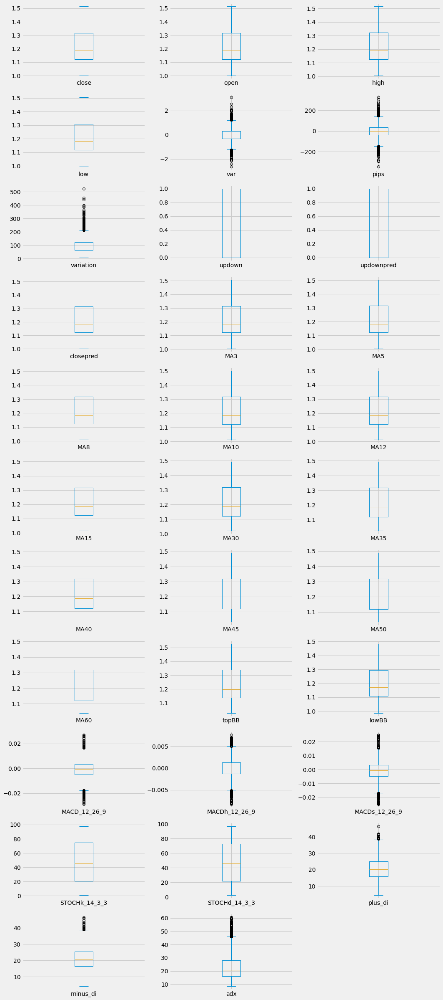

In [129]:
df.plot(figsize=(16,48),kind='box', subplots=True,layout=(13,3),sharex=False, sharey=False)
plt.show()

<AxesSubplot:xlabel='variation'>

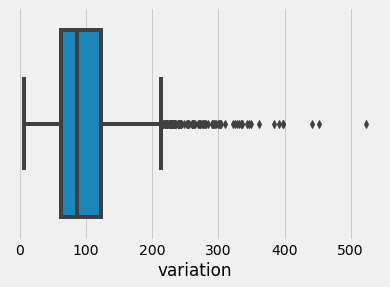

In [130]:
sns.boxplot(x=df['variation'])

In [131]:
df['variation'].max()

523.0000000000001

In [132]:
df[df['variation']>420]

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,MA3,MA5,MA8,MA10,MA12,MA15,MA30,MA35,MA40,MA45,MA50,MA60,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2015-03-18,1.0867,1.0598,1.1033,1.0581,2.54,269.0,452.0,1,0,1.0660,1.067767,1.06326,1.065750,1.07135,1.078250,1.086453,1.111570,1.114997,1.116827,1.121553,1.127456,1.140503,1.139130,1.033777,-0.020906,-0.001366,-0.019541,26.169126,15.486428,21.971592,26.563674,50.362331
2015-12-03,1.0941,1.0616,1.0983,1.0541,3.07,325.0,442.0,1,0,1.0886,1.072900,1.06688,1.065275,1.06504,1.065808,1.066707,1.078460,1.085723,1.092378,1.095849,1.098388,1.103133,1.085229,1.048184,-0.007900,0.003301,-0.011201,46.943744,25.866245,35.067841,21.917500,35.263093
2016-06-24,1.1117,1.1392,1.1434,1.0911,-2.39,-275.0,523.0,0,0,1.1026,1.126767,1.12718,1.126513,1.12621,1.126567,1.128633,1.124607,1.126426,1.128937,1.129487,1.129518,1.130552,1.143396,1.113871,-0.000516,-0.000309,-0.000207,61.765527,59.144371,16.008051,33.677053,13.843598


Viendo todos en las tablas, comprobamos que son valores reales así que los dejamos.

In [133]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3332 entries, 2009-11-02 to 2022-08-09
Data columns (total 32 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   close          3332 non-null   float64
 1   open           3332 non-null   float64
 2   high           3332 non-null   float64
 3   low            3332 non-null   float64
 4   var            3332 non-null   float64
 5   pips           3332 non-null   float64
 6   variation      3332 non-null   float64
 7   updown         3332 non-null   int64  
 8   updownpred     3332 non-null   int64  
 9   closepred      3332 non-null   float64
 10  MA3            3332 non-null   float64
 11  MA5            3332 non-null   float64
 12  MA8            3332 non-null   float64
 13  MA10           3332 non-null   float64
 14  MA12           3332 non-null   float64
 15  MA15           3332 non-null   float64
 16  MA30           3332 non-null   float64
 17  MA35           3332 non-null   float64
 18

Observemos que no tenemos ni nulos ni variables categóricas.

<AxesSubplot:>

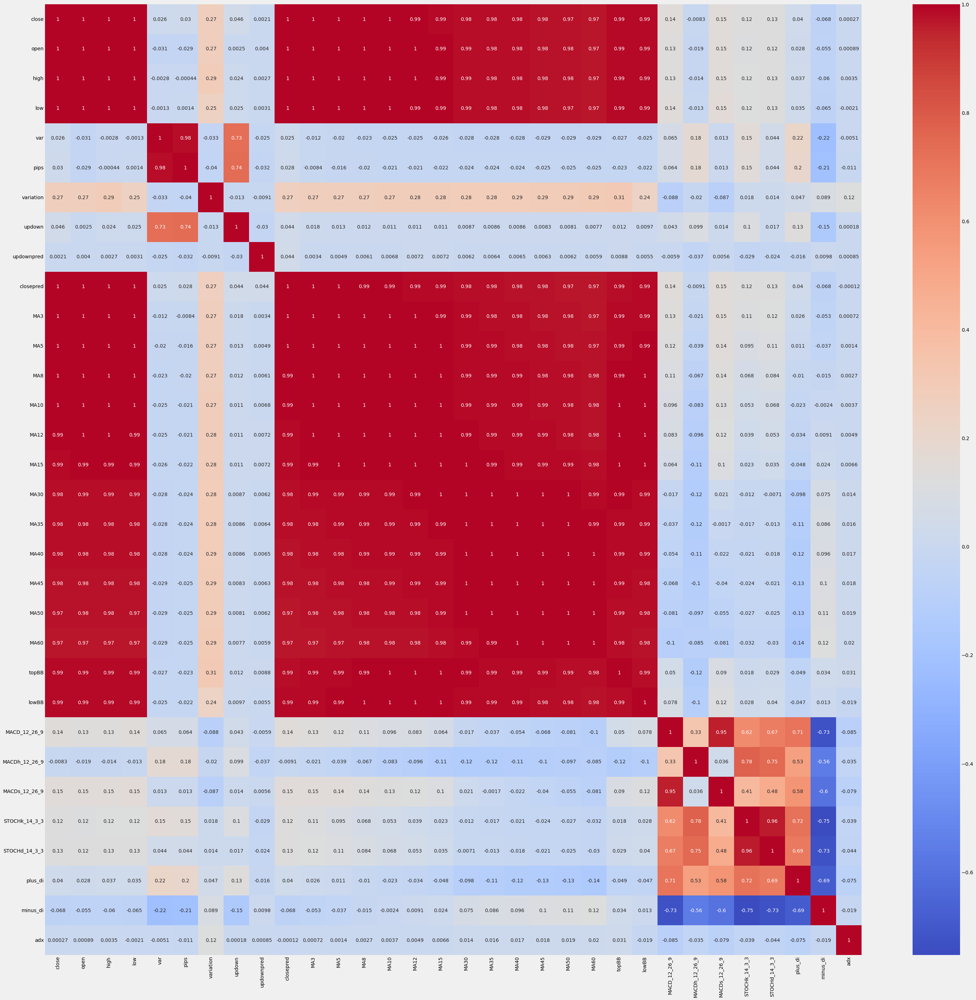

In [134]:
plt.figure(figsize=(46,46))
sns.heatmap(df.corr(),annot=True,cmap='coolwarm')

Observamos que entre las diferentes medias móviles la correlación es muy alta. Lo que nos indica que nos están ofreciendo la misma información entre ellas. Por ello vamos a quedarnos sólo con dos, la MA8 y la MA40.

In [135]:
df=df.drop(['MA3','MA5','MA10','MA12','MA15','MA30','MA35','MA45','MA50','MA60'],axis=1)

<AxesSubplot:>

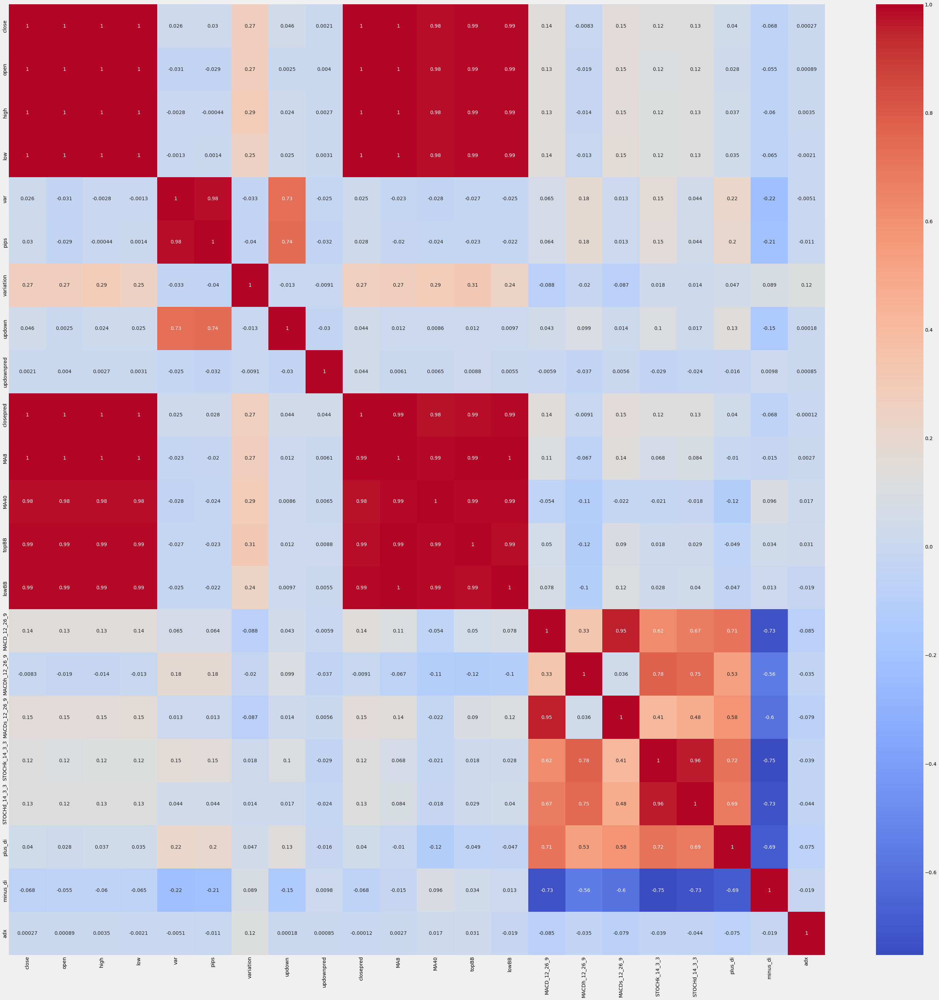

In [136]:
plt.figure(figsize=(46,46))
sns.heatmap(df.corr(),annot=True,cmap='coolwarm')

Observemos que las correlaciones no son muy altas en relación con las variables a predecir. Esto puede suponer un problema a la hora de aplicar los diferentes métodos.

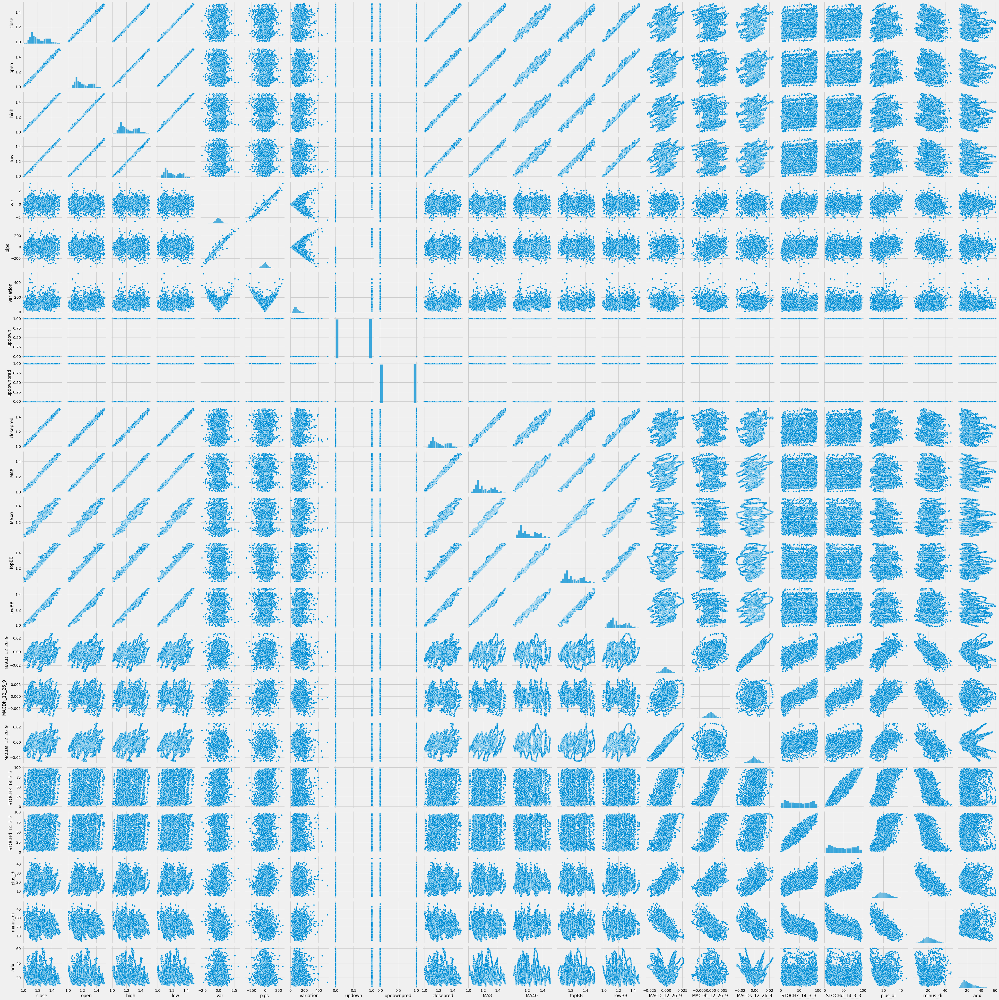

In [137]:
#sns.pairplot(df)

Aunque observemos cierta relación entre variables, todas son significativas y no deberíamos eliminar ninguna.

In [141]:
df_Price = df['updownpred']\
        .value_counts(normalize=True)\
        .mul(100).rename('percent').reset_index()

df_Price_conteo =df['updownpred'].value_counts().reset_index()
df_Price_pc = pd.merge(df_Price, 
                                  df_Price_conteo, on=['index'], how='inner')

fig = px.histogram(df_Price_pc, x="index", y=['percent'], color = 'updownpred', color_discrete_sequence = ['navy','darkorange'])
fig.show()

In [142]:
df

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
date,,,,,,,,,,,,,,,,,,,,,,
2009-11-02,1.4769,1.4713,1.4846,1.4684,0.35,56.0,162.0,1,0,1.4715,1.484225,1.474422,1.508865,1.468295,0.004302,-0.003619,0.007920,24.267648,24.099886,12.635846,16.705081,24.066022
2009-11-03,1.4715,1.4772,1.4811,1.4624,-0.37,-57.0,187.0,0,1,1.4878,1.480375,1.474997,1.509729,1.465511,0.003103,-0.003854,0.006957,17.670798,20.591080,11.277421,17.864961,23.360553
2009-11-04,1.4878,1.4731,1.4909,1.4701,1.11,147.0,208.0,1,1,1.4881,1.478813,1.475790,1.509239,1.465361,0.003429,-0.002822,0.006251,33.807448,25.248632,14.699851,15.938552,23.207494
2009-11-05,1.4881,1.4871,1.4918,1.4808,0.02,10.0,110.0,1,0,1.4849,1.478950,1.476545,1.508458,1.465289,0.003670,-0.002065,0.005735,45.709947,32.396064,14.144255,14.872013,21.793318
2009-11-06,1.4849,1.4869,1.4915,1.4813,-0.22,-20.0,102.0,0,1,1.4994,1.479450,1.477243,1.507997,1.464989,0.003561,-0.001739,0.005300,55.884586,45.133994,13.427835,14.118731,20.381075
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,1.019238,1.031340,1.030274,1.004713,-0.004862,0.001790,-0.006652,70.272294,77.658240,12.700597,20.435932,25.804307
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,1.019525,1.030412,1.028732,1.009281,-0.004093,0.002047,-0.006140,64.119445,71.202642,14.452864,18.882455,25.577253
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,1.020363,1.029578,1.027557,1.011710,-0.003939,0.001761,-0.005700,57.754774,64.048838,13.520732,18.473599,24.710634


A diferencia de la primera prueba que hemos realizado con datos desde 1979 ahora tenemos un número equilibrado de ceros y unos. Nuestro umbral de referencia a superar es 50.42%.

### 3.2 Estandarización

Para muchos de los algoritmos que vamos a evaluar es conveniente tener el conjunto de datos estandarizado por lo que vamos a crear un dataset a parte con ellos así. De esta manera podremos utilizar los datos estandarizados cuando sea conveniente y sin estandarizar cuando no.

In [143]:
escala = StandardScaler()
a = escala.fit_transform(df.drop(["updownpred", 'closepred'],axis=1))
dfstd = pd.DataFrame(a, columns= df.drop(["updownpred",'closepred'],axis=1).columns)
aux1 = pd.DataFrame(df['updownpred'])
aux1.reset_index(inplace=True)
aux2 = pd.DataFrame(df['closepred'])
aux2.reset_index(inplace=True)
dfstd['updownpred']=aux1['updownpred']
dfstd['closepred']=aux2['closepred']
dfstd.index = df.index
dfstd.describe()

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,updownpred,closepred
count,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3332.000000,3332.000000
mean,5.124619e-17,-7.279758e-16,4.863390e-16,1.161003e-15,2.537319e-17,6.799783e-17,2.720246e-16,5.724379e-17,-1.830802e-15,1.679596e-15,-8.562578e-16,-4.712783e-16,8.008467e-17,1.809277e-17,-1.142877e-16,-1.708900e-16,1.606192e-16,3.965082e-18,-8.763165e-17,3.562951e-17,0.504202,1.216080
std,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,0.500057,0.113144
min,-1.896358e+00,-1.895795e+00,-1.887979e+00,-1.924124e+00,-4.874531e+00,-5.151274e+00,-1.744978e+00,-1.008439e+00,-1.836805e+00,-1.688534e+00,-1.796141e+00,-1.919321e+00,-3.828445e+00,-3.812427e+00,-3.488497e+00,-1.638263e+00,-1.627603e+00,-2.466875e+00,-2.574681e+00,-1.556175e+00,0.000000,1.001600
25%,-8.404390e-01,-8.400788e-01,-8.427620e-01,-8.362519e-01,-5.796587e-01,-5.415997e-01,-6.867116e-01,-1.008439e+00,-8.374103e-01,-8.767266e-01,-8.404572e-01,-8.184211e-01,-5.541706e-01,-5.886569e-01,-5.670278e-01,-9.357778e-01,-9.317103e-01,-7.367239e-01,-7.085008e-01,-7.549728e-01,0.000000,1.121075
50%,-2.775765e-01,-2.774280e-01,-2.898257e-01,-2.691696e-01,1.788876e-02,2.000411e-02,-2.331689e-01,9.916317e-01,-2.894014e-01,-2.882583e-01,-3.342877e-01,-2.410643e-01,2.070266e-02,1.515182e-02,2.310740e-02,-6.763816e-02,-5.523409e-02,-6.667562e-02,-8.299976e-02,-2.372530e-01,1.000000,1.184750
75%,8.777497e-01,8.772543e-01,8.813180e-01,8.710041e-01,5.594161e-01,5.627622e-01,4.471452e-01,9.916317e-01,8.841966e-01,8.762324e-01,8.928383e-01,8.740435e-01,6.201328e-01,5.819437e-01,6.172233e-01,9.459776e-01,9.225471e-01,6.690172e-01,6.557115e-01,5.308962e-01,1.000000,1.315500
max,2.631283e+00,2.623084e+00,2.577707e+00,2.607193e+00,5.750610e+00,4.919903e+00,8.006191e+00,9.916317e-01,2.538090e+00,2.423426e+00,2.492907e+00,2.565443e+00,3.818940e+00,3.509459e+00,3.746914e+00,1.768626e+00,1.793406e+00,3.988198e+00,3.853564e+00,4.029104e+00,1.000000,1.514000


### 3.2 Train y test

En este apartado partiremos el conjunto de datos en un subconjunto de entrenamiento y otro de test. Los datos de entrenamiento son los datos que usaremos para entrenar un modelo. La calidad de nuestro modelo de aprendizaje automático va a ser directamente proporcional a la calidad de los datos. Los datos pertenecientes a test son los datos que nos “reservamos” para comprobar si el modelo que hemos generado a partir de los datos de entrenamiento “funciona”. Para evitar errores por un sobreajuste (o overfitting) o un subajuste (o underfitting) tenemos que conservar las proporciones originales de cada subconjunto de las variables objetivo. Realizaremos dos conjuntos diferentes en función de si utilizamos el estandarizado o no.
Reservamos los datos de 2021 y 2022 para test.

In [144]:
# Reparto de datos en train y test de updown sin estandarizar
# ==============================================================================
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
                                        df.drop(['updownpred', 'closepred'],axis=1), 
                                        df['updownpred'], 
                                        test_size=0.125,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [145]:
print("Partición de entrenamento")
print("-----------------------")
display(y_train.describe())
display(X_train.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(y_test.describe())
display(X_test.describe())

Partición de entrenamento
-----------------------


count    2915.000000
mean        0.510806
std         0.499969
min         0.000000
25%         0.000000
50%         1.000000
75%         1.000000
max         1.000000
Name: updownpred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000
mean,1.226582,1.226642,1.231760,1.221506,-0.004957,-0.600000,102.544425,0.510806,1.226890,1.228362,1.246429,1.208004,-0.000637,-0.000002,-0.000636,48.420035,48.404618,20.913207,20.895442,23.040946
std,0.115183,0.115245,0.115818,0.114329,0.546941,68.328172,54.371201,0.499969,0.115260,0.115753,0.118701,0.112966,0.007541,0.002229,0.007119,28.465760,27.660977,6.561173,6.626051,9.674255
min,1.038700,1.038900,1.041900,1.034100,-2.620000,-343.000000,7.000000,0.000000,1.042863,1.055165,1.051756,1.028013,-0.028755,-0.008264,-0.024847,0.956122,2.553780,4.436544,4.128963,8.533306
25%,1.121700,1.121800,1.126350,1.118100,-0.320000,-38.000000,65.000000,0.000000,1.122387,1.119984,1.139722,1.108672,-0.004734,-0.001305,-0.004572,21.724466,22.465893,16.097824,16.135717,15.790604
50%,1.199300,1.199200,1.206000,1.194600,0.000000,1.000000,90.000000,1.000000,1.201037,1.201000,1.224404,1.181514,-0.000419,0.000024,-0.000364,46.982158,47.165156,20.556575,20.411127,20.606893
75%,1.328000,1.328350,1.333900,1.321950,0.300000,37.000000,126.000000,1.000000,1.327075,1.327651,1.348243,1.303974,0.004140,0.001295,0.003920,75.381917,74.154596,25.233946,25.203499,27.999138
max,1.514000,1.513200,1.514500,1.504200,3.070000,325.000000,523.000000,1.000000,1.503675,1.492110,1.525421,1.482627,0.026802,0.007576,0.024768,97.823224,97.082733,46.445948,46.624375,60.616949


 
Partición de test
-----------------------


count    417.000000
mean       0.458034
std        0.498834
min        0.000000
25%        0.000000
50%        0.000000
75%        1.000000
max        1.000000
Name: updownpred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000
mean,1.143739,1.144379,1.147936,1.140243,-0.041894,-6.407674,76.928058,0.458034,1.145443,1.152749,1.161502,1.132763,-0.003073,-0.000120,-0.002953,41.359318,41.396371,17.538680,22.925396,23.072455
std,0.060284,0.060113,0.059373,0.060932,0.447643,50.042210,33.839477,0.498834,0.059359,0.054143,0.055546,0.061886,0.004381,0.001632,0.004111,27.484827,26.699322,5.263098,6.235224,6.396587
min,1.001600,1.001800,1.006500,0.995200,-1.490000,-153.000000,25.000000,0.000000,1.009012,1.028538,1.027128,0.986085,-0.014312,-0.004731,-0.011777,2.641847,4.088684,6.502440,9.568814,10.944818
25%,1.102700,1.103600,1.107000,1.097000,-0.280000,-33.000000,53.000000,0.000000,1.102475,1.121885,1.129261,1.088337,-0.005958,-0.001174,-0.005847,15.937681,15.832141,13.502669,18.410790,17.630634
50%,1.159400,1.159600,1.161700,1.156300,-0.030000,-5.000000,70.000000,0.000000,1.159800,1.170135,1.170783,1.152567,-0.003275,-0.000084,-0.003226,36.075949,35.366135,16.938561,22.187648,23.014825
75%,1.191500,1.191800,1.194600,1.187700,0.240000,26.000000,92.000000,1.000000,1.192600,1.199168,1.210466,1.179258,-0.000115,0.001073,-0.000270,64.669739,64.556962,20.861255,27.763757,27.929590
max,1.232500,1.232700,1.235000,1.226500,1.610000,172.000000,221.000000,1.000000,1.226300,1.217798,1.235974,1.214813,0.006988,0.004349,0.007419,94.698071,94.237700,31.276586,38.194580,38.147375


In [146]:
# Reparto de datos en train y test de updown estandarizado
# ==============================================================================
from sklearn.model_selection import train_test_split

X_train_std, X_test_std, y_train_std, y_test_std = train_test_split(
                                        dfstd.drop(['updownpred', 'closepred'],axis=1), 
                                        dfstd['updownpred'], 
                                        test_size=0.125,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [147]:
print("Partición de entrenamento")
print("-----------------------")
display(y_train_std.describe())
display(X_train_std.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(y_test_std.describe())
display(X_test_std.describe())

Partición de entrenamento
-----------------------


count    2915.000000
mean        0.510806
std         0.499969
min         0.000000
25%         0.000000
50%         1.000000
75%         1.000000
max         1.000000
Name: updownpred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000
mean,0.091611,0.090971,0.092220,0.090537,0.008632,0.010958,0.060584,0.013209,0.090150,0.083937,0.091486,0.085049,0.041961,0.006857,0.042291,0.031079,0.031742,0.064893,-0.038430,-0.000423
std,1.017769,1.018341,1.018125,1.017802,1.021323,1.030157,1.027486,0.999973,1.019382,1.026744,1.021720,1.020307,1.038011,1.030455,1.038193,1.001162,1.001053,1.008175,1.002317,1.037435
min,-1.568537,-1.567968,-1.576787,-1.577821,-4.874531,-5.151274,-1.744978,-1.008439,-1.537429,-1.452344,-1.584162,-1.540630,-3.828445,-3.812427,-3.488497,-1.638263,-1.627603,-2.466875,-2.574681,-1.556175
25%,-0.835137,-0.835440,-0.834411,-0.830020,-0.579659,-0.552907,-0.648916,-1.008439,-0.834094,-0.877392,-0.826992,-0.812117,-0.521889,-0.595623,-0.531745,-0.907825,-0.906983,-0.675028,-0.758429,-0.777926
50%,-0.149452,-0.151511,-0.134230,-0.148987,0.017889,0.035081,-0.176476,0.991632,-0.138497,-0.158765,-0.098093,-0.154209,0.071969,0.018791,0.081964,-0.019493,-0.013115,0.010094,-0.111692,-0.261443
75%,0.987760,0.989696,0.990103,0.984732,0.578090,0.577839,0.503838,0.991632,0.976204,0.964651,0.967847,0.951851,0.699515,0.606177,0.706695,0.979348,0.963635,0.728808,0.613246,0.531277
max,2.631283,2.623084,2.577707,2.607193,5.750610,4.919903,8.006191,0.991632,2.538090,2.423426,2.492907,2.565443,3.818940,3.509459,3.746914,1.768626,1.793406,3.988198,3.853564,4.029104


 
Partición de test
-----------------------


count    417.000000
mean       0.458034
std        0.498834
min        0.000000
25%        0.000000
50%        0.000000
75%        1.000000
max        1.000000
Name: updownpred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000
mean,-0.640401,-0.635922,-0.644653,-0.632891,-0.060342,-0.076602,-0.423505,-0.092339,-0.630187,-0.586757,-0.639526,-0.594527,-0.293322,-0.047931,-0.295632,-0.217252,-0.221887,-0.453629,0.268640,0.002956
std,0.532676,0.531178,0.521931,0.542442,0.835900,0.754467,0.639485,0.997704,0.524986,0.480256,0.478110,0.558949,0.602980,0.754331,0.599484,0.966662,0.966250,0.808716,0.943197,0.685949
min,-1.896358,-1.895795,-1.887979,-1.924124,-2.764442,-2.286718,-1.404821,-1.008439,-1.836805,-1.688534,-1.796141,-1.919321,-1.840333,-2.179152,-1.582471,-1.578975,-1.572055,-2.149434,-1.751799,-1.297572
25%,-1.003024,-0.996260,-1.004511,-1.017861,-0.504965,-0.477524,-0.875688,-1.008439,-1.010204,-0.860527,-0.917031,-0.995784,-0.690420,-0.535226,-0.717614,-1.111350,-1.147059,-1.073794,-0.414281,-0.580607
50%,-0.502015,-0.501428,-0.523659,-0.489949,-0.038131,-0.055379,-0.554428,-1.008439,-0.503210,-0.432542,-0.559639,-0.415656,-0.321167,-0.031294,-0.335456,-0.403072,-0.440122,-0.545842,0.157041,-0.003224
75%,-0.218374,-0.216899,-0.234444,-0.210414,0.466049,0.411996,-0.138681,0.991632,-0.213120,-0.175020,-0.218068,-0.174588,0.113919,0.503556,0.095685,0.602593,0.616296,0.056910,1.000534,0.523819
max,0.143908,0.144505,0.120701,0.134999,3.024299,2.613181,2.299111,0.991632,0.084929,-0.009769,0.001496,0.146546,1.091584,2.017857,1.216931,1.658712,1.690444,1.657307,2.578396,1.619541


In [148]:
# Reparto de datos en train y test de close sin estandarizar
# ==============================================================================
from sklearn.model_selection import train_test_split

Xc_train, Xc_test, yc_train, yc_test = train_test_split(
                                        df.drop(['updownpred', 'closepred'],axis=1), 
                                        df['closepred'], 
                                        test_size=0.125,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [149]:
print("Partición de entrenamento")
print("-----------------------")
display(yc_train.describe())
display(Xc_train.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(yc_test.describe())
display(Xc_test.describe())

Partición de entrenamento
-----------------------


count    2915.000000
mean        1.226495
std         0.115089
min         1.038700
25%         1.121700
50%         1.199300
75%         1.327900
max         1.514000
Name: closepred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000
mean,1.226582,1.226642,1.231760,1.221506,-0.004957,-0.600000,102.544425,0.510806,1.226890,1.228362,1.246429,1.208004,-0.000637,-0.000002,-0.000636,48.420035,48.404618,20.913207,20.895442,23.040946
std,0.115183,0.115245,0.115818,0.114329,0.546941,68.328172,54.371201,0.499969,0.115260,0.115753,0.118701,0.112966,0.007541,0.002229,0.007119,28.465760,27.660977,6.561173,6.626051,9.674255
min,1.038700,1.038900,1.041900,1.034100,-2.620000,-343.000000,7.000000,0.000000,1.042863,1.055165,1.051756,1.028013,-0.028755,-0.008264,-0.024847,0.956122,2.553780,4.436544,4.128963,8.533306
25%,1.121700,1.121800,1.126350,1.118100,-0.320000,-38.000000,65.000000,0.000000,1.122387,1.119984,1.139722,1.108672,-0.004734,-0.001305,-0.004572,21.724466,22.465893,16.097824,16.135717,15.790604
50%,1.199300,1.199200,1.206000,1.194600,0.000000,1.000000,90.000000,1.000000,1.201037,1.201000,1.224404,1.181514,-0.000419,0.000024,-0.000364,46.982158,47.165156,20.556575,20.411127,20.606893
75%,1.328000,1.328350,1.333900,1.321950,0.300000,37.000000,126.000000,1.000000,1.327075,1.327651,1.348243,1.303974,0.004140,0.001295,0.003920,75.381917,74.154596,25.233946,25.203499,27.999138
max,1.514000,1.513200,1.514500,1.504200,3.070000,325.000000,523.000000,1.000000,1.503675,1.492110,1.525421,1.482627,0.026802,0.007576,0.024768,97.823224,97.082733,46.445948,46.624375,60.616949


 
Partición de test
-----------------------


count    417.000000
mean       1.143271
std        0.060410
min        1.001600
25%        1.101400
50%        1.159200
75%        1.191200
max        1.232500
Name: closepred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000
mean,1.143739,1.144379,1.147936,1.140243,-0.041894,-6.407674,76.928058,0.458034,1.145443,1.152749,1.161502,1.132763,-0.003073,-0.000120,-0.002953,41.359318,41.396371,17.538680,22.925396,23.072455
std,0.060284,0.060113,0.059373,0.060932,0.447643,50.042210,33.839477,0.498834,0.059359,0.054143,0.055546,0.061886,0.004381,0.001632,0.004111,27.484827,26.699322,5.263098,6.235224,6.396587
min,1.001600,1.001800,1.006500,0.995200,-1.490000,-153.000000,25.000000,0.000000,1.009012,1.028538,1.027128,0.986085,-0.014312,-0.004731,-0.011777,2.641847,4.088684,6.502440,9.568814,10.944818
25%,1.102700,1.103600,1.107000,1.097000,-0.280000,-33.000000,53.000000,0.000000,1.102475,1.121885,1.129261,1.088337,-0.005958,-0.001174,-0.005847,15.937681,15.832141,13.502669,18.410790,17.630634
50%,1.159400,1.159600,1.161700,1.156300,-0.030000,-5.000000,70.000000,0.000000,1.159800,1.170135,1.170783,1.152567,-0.003275,-0.000084,-0.003226,36.075949,35.366135,16.938561,22.187648,23.014825
75%,1.191500,1.191800,1.194600,1.187700,0.240000,26.000000,92.000000,1.000000,1.192600,1.199168,1.210466,1.179258,-0.000115,0.001073,-0.000270,64.669739,64.556962,20.861255,27.763757,27.929590
max,1.232500,1.232700,1.235000,1.226500,1.610000,172.000000,221.000000,1.000000,1.226300,1.217798,1.235974,1.214813,0.006988,0.004349,0.007419,94.698071,94.237700,31.276586,38.194580,38.147375


In [150]:
# Reparto de datos en train y test de close estandarizado
# ==============================================================================
from sklearn.model_selection import train_test_split

Xc_train_std, Xc_test_std, yc_train_std, yc_test_std = train_test_split(
                                        dfstd.drop(['updownpred', 'closepred'],axis=1), 
                                        dfstd['closepred'], 
                                        test_size=0.125,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [151]:
print("Partición de entrenamento")
print("-----------------------")
display(yc_train_std.describe())
display(Xc_train_std.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(yc_test_std.describe())
display(Xc_test_std.describe())

Partición de entrenamento
-----------------------


count    2915.000000
mean        1.226495
std         0.115089
min         1.038700
25%         1.121700
50%         1.199300
75%         1.327900
max         1.514000
Name: closepred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000
mean,0.091611,0.090971,0.092220,0.090537,0.008632,0.010958,0.060584,0.013209,0.090150,0.083937,0.091486,0.085049,0.041961,0.006857,0.042291,0.031079,0.031742,0.064893,-0.038430,-0.000423
std,1.017769,1.018341,1.018125,1.017802,1.021323,1.030157,1.027486,0.999973,1.019382,1.026744,1.021720,1.020307,1.038011,1.030455,1.038193,1.001162,1.001053,1.008175,1.002317,1.037435
min,-1.568537,-1.567968,-1.576787,-1.577821,-4.874531,-5.151274,-1.744978,-1.008439,-1.537429,-1.452344,-1.584162,-1.540630,-3.828445,-3.812427,-3.488497,-1.638263,-1.627603,-2.466875,-2.574681,-1.556175
25%,-0.835137,-0.835440,-0.834411,-0.830020,-0.579659,-0.552907,-0.648916,-1.008439,-0.834094,-0.877392,-0.826992,-0.812117,-0.521889,-0.595623,-0.531745,-0.907825,-0.906983,-0.675028,-0.758429,-0.777926
50%,-0.149452,-0.151511,-0.134230,-0.148987,0.017889,0.035081,-0.176476,0.991632,-0.138497,-0.158765,-0.098093,-0.154209,0.071969,0.018791,0.081964,-0.019493,-0.013115,0.010094,-0.111692,-0.261443
75%,0.987760,0.989696,0.990103,0.984732,0.578090,0.577839,0.503838,0.991632,0.976204,0.964651,0.967847,0.951851,0.699515,0.606177,0.706695,0.979348,0.963635,0.728808,0.613246,0.531277
max,2.631283,2.623084,2.577707,2.607193,5.750610,4.919903,8.006191,0.991632,2.538090,2.423426,2.492907,2.565443,3.818940,3.509459,3.746914,1.768626,1.793406,3.988198,3.853564,4.029104


 
Partición de test
-----------------------


count    417.000000
mean       1.143271
std        0.060410
min        1.001600
25%        1.101400
50%        1.159200
75%        1.191200
max        1.232500
Name: closepred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000
mean,-0.640401,-0.635922,-0.644653,-0.632891,-0.060342,-0.076602,-0.423505,-0.092339,-0.630187,-0.586757,-0.639526,-0.594527,-0.293322,-0.047931,-0.295632,-0.217252,-0.221887,-0.453629,0.268640,0.002956
std,0.532676,0.531178,0.521931,0.542442,0.835900,0.754467,0.639485,0.997704,0.524986,0.480256,0.478110,0.558949,0.602980,0.754331,0.599484,0.966662,0.966250,0.808716,0.943197,0.685949
min,-1.896358,-1.895795,-1.887979,-1.924124,-2.764442,-2.286718,-1.404821,-1.008439,-1.836805,-1.688534,-1.796141,-1.919321,-1.840333,-2.179152,-1.582471,-1.578975,-1.572055,-2.149434,-1.751799,-1.297572
25%,-1.003024,-0.996260,-1.004511,-1.017861,-0.504965,-0.477524,-0.875688,-1.008439,-1.010204,-0.860527,-0.917031,-0.995784,-0.690420,-0.535226,-0.717614,-1.111350,-1.147059,-1.073794,-0.414281,-0.580607
50%,-0.502015,-0.501428,-0.523659,-0.489949,-0.038131,-0.055379,-0.554428,-1.008439,-0.503210,-0.432542,-0.559639,-0.415656,-0.321167,-0.031294,-0.335456,-0.403072,-0.440122,-0.545842,0.157041,-0.003224
75%,-0.218374,-0.216899,-0.234444,-0.210414,0.466049,0.411996,-0.138681,0.991632,-0.213120,-0.175020,-0.218068,-0.174588,0.113919,0.503556,0.095685,0.602593,0.616296,0.056910,1.000534,0.523819
max,0.143908,0.144505,0.120701,0.134999,3.024299,2.613181,2.299111,0.991632,0.084929,-0.009769,0.001496,0.146546,1.091584,2.017857,1.216931,1.658712,1.690444,1.657307,2.578396,1.619541


### 3.3 Métricas

Para evaluar correctamente los algoritmos y poder compararlos entre sí crearé una serie de métricas que nos permitan comparar posteriormente la capacidad de predicción de cada algoritmo.

Haré una para las predicciones sobre updownpred y otra para closepred.

#### 3.3.1 Updownpred

Para valorar el rendimiento en clasificación de nuestros modelos sobre updownpred, utilizaré el siguiente conjunto de métricas:
* Accuracy: Mide el porcentaje de casos que el modelo ha acertado
* Recall (Sensitivity): Mide la cantidad de casos que es capaz de identificar el modelo
* Precision: Mide la calidad del modelo a la hora de clasificar, en nuestro caso, el porcentaje de clientes que no pagarán entre los que predice como no pagadores.
* Specificity: Mide la capacidad de nuestro modelo para dar como casos negativos los casos realmente positivos
* F1: El valor F1 se utiliza para combinar las medidas de precision y recall en un sólo valor. Esto es práctico porque hace más fácil el poder comparar el rendimiento combinado de la precisión y la exhaustividad entre varias soluciones, aunque tiene una mala interpretabilidad. F1 alcanza su máximo en 1, y su mínimo en 0, donde el primer valor simboliza un modelo infalible (un ideal imposible), y 0 significa que el algoritmo falla todo el tiempo. 
* Confusion matrix: Matriz que indica por grupos el número de aciertos y fallos de los modelos de clasificación.
* Curva ROC: Representación gráfica de la sensibilidad frente a la especificidad para un sistema clasificador binario según se varía el umbral de discriminación.
* Área bajo la curva ROC: Esta área posee un valor comprendido entre 0,5 y 1, donde 1 representa un valor diagnóstico perfecto y 0,5 es una prueba sin capacidad discriminatoria diagnóstica.

In [152]:
def acc(test, predicciones):
    test_rounded = list(np.round(test,4))
    acc = np.mean(np.array(test_rounded)==np.round(predicciones,4))*100
    return np.round(acc, 3)
    
#Introducimos una funcion que más adelante nos calcule las distintas métricas
def calcula_metricas(confmat):
    
    tn, fp, fn, tp = confmat.ravel()

    acc = (tp+tn)/(tn + fp + fn + tp) #Accuracy
    sen = tp/(tp+fn) #Recall
    esp = tn/(tn+fp) #Specificity
    ppv = tp/(tp+fp) #Precision
    fsc = 2*(sen*ppv/(sen+ppv)) #F1

    print('Accuracy: ', acc)
    print('Recall (Sensitivity): ', sen)
    print('Specificity: ', esp)
    print('Precision: ', ppv)
    print('F1: ', fsc)
    
    plt.bar(range(5),[acc,sen,esp,ppv,fsc])
    plt.xticks(range(5),['ACC','SEN','ESP','PPV','FSC'])
    plt.plot([-1, 6], [1, 1], color=(0.6, 0.6, 0.6), linestyle='--')
    plt.xlim((-0.5,4.5))
    plt.ylim((0,1.1))
    plt.title('Metricas')
    plt.show()

#### 3,2 Closepred

Para valorar el rendimiento en clasificación de nuestros modelos sobre updownpred, utilizaré el siguiente conjunto de métricas:
* Accuracy: Mide el porcentaje de casos que el modelo ha acertado exactamente
## Explicar

In [153]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def acc(test, predicciones):
    test_rounded = list(np.round(test,4))
    acc = np.mean(np.array(test_rounded)==np.round(predicciones,4))*100
    return np.round(acc, 3)

def acc_5(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,5):
            interval.append(i-n/10000)
            interval.append(i+n/10000)
        acc.append(np.round(interval,4).__contains__(np.round(predicciones[j],4)))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_10(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,10):
            interval.append(i-n/10000)
            interval.append(i+n/10000)
        acc.append(np.round(interval,4).__contains__(np.round(predicciones[j],4)))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_25(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,25):
            interval.append(i-n/10000)
            interval.append(i+n/10000)
        acc.append(np.round(interval,4).__contains__(np.round(predicciones[j],4)))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_50(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,50):
            interval.append(i-n/10000)
            interval.append(i+n/10000)
        acc.append(np.round(interval,4).__contains__(np.round(predicciones[j],4)))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

#Recogemos esto en dos funciones:
def metricas(test, pred):
    # Error Absoluto Medio
    print("Mean Absolute Error", mean_absolute_error(test, pred))
    # Error Cuadrado Medio
    print("Mean squared error:", mean_squared_error(test, pred))
    print("Root Mean squared error:", np.sqrt(mean_squared_error(test, pred)))
    # Evaluamos el puntaje de varianza (siendo 1.0 el mejor posible)
    print('Variance score: %.2f' % r2_score(test, pred))
    # Mostramos todos los accuracies
    print('Acertamos exactamente el', acc(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 5 pips el', acc_5(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 10 pips el', acc_10(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 25 pips el', acc_25(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 50 pips el', acc_50(test, pred),'% de las predicciones.')

## 4. Evaluación de métodos updownpred

### 4.1 Regresión logística

##### Dataset sin estandarizar

In [154]:
# Creación del modelo utilizando matrices como en scikitlearn
# A la matriz de predictores se le tiene que añadir una columna de 1s para el intercept del modelo
X_train_r = sm.add_constant(X_train, prepend=True)
modelo = sm.Logit(endog=y_train, exog=X_train_r, normalize=False)
modelo = modelo.fit()
print(modelo.summary())

         Current function value: 0.688431
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:             updownpred   No. Observations:                 2915
Model:                          Logit   Df Residuals:                     2895
Method:                           MLE   Df Model:                           19
Date:                Tue, 06 Sep 2022   Pseudo R-squ.:                0.006469
Time:                        16:01:42   Log-Likelihood:                -2006.8
converged:                      False   LL-Null:                       -2019.8
Covariance Type:            nonrobust   LLR p-value:                    0.1265
                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------
const             0.5853      0.575      1.017      0.309      -0.543       1.713
close            -1.2700        nan        nan        na

In [155]:
# Predicciones con intervalo de confianza 
predicciones = modelo.predict(exog = X_train_r)
print(predicciones)

# Clasificación predicha
y_pred = np.where(predicciones<0.5, 0, 1)
print(y_pred)

date
2009-11-02    0.519419
2009-11-03    0.614016
2009-11-04    0.495720
2009-11-05    0.499710
2009-11-06    0.528791
                ...   
2020-12-28    0.492497
2020-12-29    0.496138
2020-12-30    0.482264
2020-12-31    0.483879
2021-01-01    0.530621
Length: 2915, dtype: float64
[1 1 0 ... 0 0 1]


In [156]:
# Accuracy de test del modelo en train
predicciones = modelo.predict(exog = X_train_r)
y_pred = np.where(predicciones<0.5, 0, 1)
accuracy = accuracy_score(y_true = y_train, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 53.276157804459686% de las predicciones


In [157]:
print(classification_report(y_pred, y_train))

              precision    recall  f1-score   support

           0       0.41      0.53      0.46      1116
           1       0.65      0.54      0.59      1799

    accuracy                           0.53      2915
   macro avg       0.53      0.53      0.52      2915
weighted avg       0.56      0.53      0.54      2915



In [158]:
# Accuracy de test del modelo en test
X_test_r = sm.add_constant(X_test, prepend=True)
predicciones = modelo.predict(exog = X_test_r)
y_pred = np.where(predicciones<0.5, 0, 1)
accuracy = accuracy_score(y_true = y_test, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 46.76258992805755% de las predicciones


In [159]:
print(classification_report(y_pred,y_test))

              precision    recall  f1-score   support

           0       0.37      0.51      0.43       162
           1       0.59      0.44      0.50       255

    accuracy                           0.47       417
   macro avg       0.48      0.48      0.47       417
weighted avg       0.50      0.47      0.47       417



In [160]:
confmat = confusion_matrix(y_true = y_test, y_pred = y_pred)
confmat

array([[ 83, 143],
       [ 79, 112]], dtype=int64)

Accuracy:  0.4676258992805755
Recall (Sensitivity):  0.5863874345549738
Specificity:  0.3672566371681416
Precision:  0.4392156862745098
F1:  0.5022421524663677


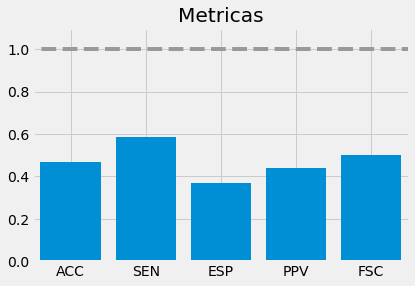

In [161]:
calcula_metricas(confmat)

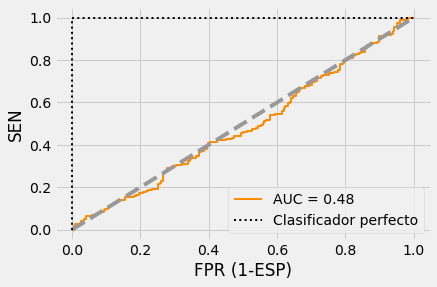

In [162]:
y_scores = modelo.predict(X_test_r)
ejex, ejey, _ = roc_curve(y_test, y_scores)
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

In [163]:
predicciones = modelo.predict(exog = sm.add_constant(df.drop(['updownpred', 'closepred'],axis=1), prepend=True))
y_pred = np.where(predicciones<0.5, 0, 1)
updownpred = pd.DataFrame()
updownpred.index = df.index
updownpred['real'] = df['updownpred']
updownpred['log'] = y_pred
updownpred['log_conf']= predicciones
updownpred

,real,log,log_conf
date,,,
2009-11-02,0,1,0.519419
2009-11-03,1,1,0.614016
2009-11-04,1,0,0.495720
2009-11-05,0,0,0.499710
2009-11-06,1,1,0.528791
...,...,...,...
2022-08-03,1,1,0.506075
2022-08-04,0,0,0.493650
2022-08-05,1,0,0.478417


Text(0.5, 0, '0.35     0.4     0.45     0.55      0.6      0.65')

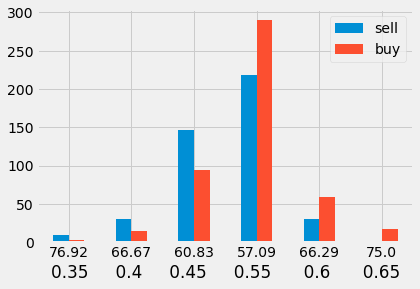

In [164]:
thirtyfive = updownpred.loc[updownpred['log_conf']<0.35, :]['real'].value_counts()
fourty = updownpred.loc[updownpred['log_conf']<0.4, :]['real'].value_counts()
fourtyfive = updownpred.loc[updownpred['log_conf']<0.45, :]['real'].value_counts()
fiftyfive = updownpred.loc[updownpred['log_conf']>0.55, :]['real'].value_counts()
sixty = updownpred.loc[updownpred['log_conf']>0.6, :]['real'].value_counts()
sixtyfive = updownpred.loc[updownpred['log_conf']>0.65, :]['real'].value_counts()

sell = [thirtyfive[0], fourty[0], fourtyfive[0], fiftyfive[0], sixty[0], 0]
buy = [thirtyfive[1], fourty[1], fourtyfive[1], fiftyfive[1], sixty[1], sixtyfive[1]]
index = [100-np.round(sum(updownpred[updownpred['log_conf'] < 0.35]['real'])*100/len(updownpred[updownpred['log_conf'] < 0.35]['real']),2),
         100-np.round(sum(updownpred[updownpred['log_conf'] < 0.4]['real'])*100/len(updownpred[updownpred['log_conf'] < 0.4]['real']),2), 
         100-np.round(sum(updownpred[updownpred['log_conf'] < 0.45]['real'])*100/len(updownpred[updownpred['log_conf'] < 0.45]['real']),2),
         np.round(sum(updownpred[updownpred['log_conf'] > 0.55]['real'])*100/len(updownpred[updownpred['log_conf'] > 0.55]['real']),2), 
         np.round(sum(updownpred[updownpred['log_conf'] > 0.6]['real'])*100/len(updownpred[updownpred['log_conf'] > 0.6]['real']),2),
         np.round(sum(updownpred[updownpred['log_conf'] > 0.65]['real'])*100/len(updownpred[updownpred['log_conf'] > 0.65]['real']),2)]

# Plot
df_plot = pd.DataFrame({'sell': sell,
                   'buy': buy}, index=index)
ax = df_plot.plot.bar(rot=0)
plt.xlabel('0.35     0.4     0.45     0.55      0.6      0.65')

Text(0.5, 0, '0.46  0.47  0.48  0.49  0.51  0.52  0.53  0.54')

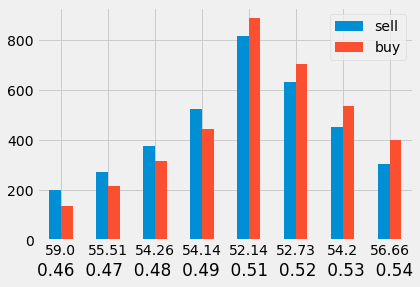

In [165]:
fs = updownpred.loc[updownpred['log_conf']<0.46, :]['real'].value_counts()
fse = updownpred.loc[updownpred['log_conf']<0.47, :]['real'].value_counts()
fe = updownpred.loc[updownpred['log_conf']<0.48, :]['real'].value_counts()
fn = updownpred.loc[updownpred['log_conf']<0.49, :]['real'].value_counts()
fo = updownpred.loc[updownpred['log_conf']>0.51, :]['real'].value_counts()
ft = updownpred.loc[updownpred['log_conf']>0.52, :]['real'].value_counts()
fth = updownpred.loc[updownpred['log_conf']>0.53, :]['real'].value_counts()
ff = updownpred.loc[updownpred['log_conf']>0.54, :]['real'].value_counts()

sell = [fs[0], fse[0], fe[0], fn[0], fo[0], ft[0], fth[0], ff[0]]
buy = [fs[1], fse[1], fe[1], fn[1], fo[1], ft[1], fth[1], ff[1]]
index = [100-np.round(sum(updownpred[updownpred['log_conf'] < 0.46]['real'])*100/len(updownpred[updownpred['log_conf'] < 0.46]['real']),2),
         100-np.round(sum(updownpred[updownpred['log_conf'] < 0.47]['real'])*100/len(updownpred[updownpred['log_conf'] < 0.47]['real']),2), 
         100-np.round(sum(updownpred[updownpred['log_conf'] < 0.48]['real'])*100/len(updownpred[updownpred['log_conf'] < 0.48]['real']),2),
         100-np.round(sum(updownpred[updownpred['log_conf'] < 0.49]['real'])*100/len(updownpred[updownpred['log_conf'] < 0.49]['real']),2),
         np.round(sum(updownpred[updownpred['log_conf'] > 0.51]['real'])*100/len(updownpred[updownpred['log_conf'] > 0.51]['real']),2), 
         np.round(sum(updownpred[updownpred['log_conf'] > 0.52]['real'])*100/len(updownpred[updownpred['log_conf'] > 0.52]['real']),2),
         np.round(sum(updownpred[updownpred['log_conf'] > 0.53]['real'])*100/len(updownpred[updownpred['log_conf'] > 0.53]['real']),2),
         np.round(sum(updownpred[updownpred['log_conf'] > 0.54]['real'])*100/len(updownpred[updownpred['log_conf'] > 0.54]['real']),2)]

# Plot
df_plot = pd.DataFrame({'sell': sell,
                   'buy': buy}, index=index)
ax = df_plot.plot.bar(rot=0)
plt.xlabel('0.46  0.47  0.48  0.49  0.51  0.52  0.53  0.54')

In [166]:
print(classification_report(updownpred['real'],updownpred['log']))

              precision    recall  f1-score   support

           0       0.53      0.41      0.46      1652
           1       0.52      0.64      0.58      1680

    accuracy                           0.52      3332
   macro avg       0.52      0.52      0.52      3332
weighted avg       0.52      0.52      0.52      3332



In [167]:
confmat = confusion_matrix(updownpred['real'],updownpred['log'])
confmat

array([[ 673,  979],
       [ 605, 1075]], dtype=int64)

Accuracy:  0.524609843937575
Recall (Sensitivity):  0.6398809523809523
Specificity:  0.40738498789346245
Precision:  0.5233690360272639
F1:  0.5757900374933048


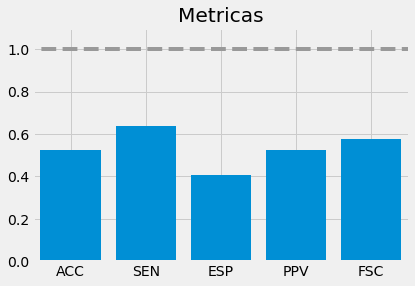

In [168]:
calcula_metricas(confmat)

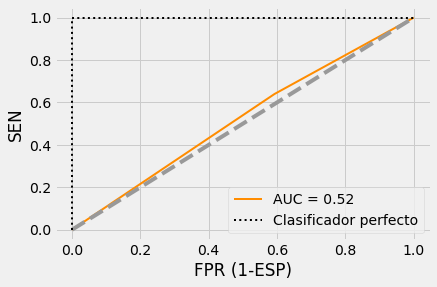

In [169]:
ejex, ejey, _ = roc_curve(updownpred['real'],updownpred['log'])
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

##### Dataset estandarizado

In [170]:
# Creación del modelo utilizando matrices como en scikitlearn
# A la matriz de predictores se le tiene que añadir una columna de 1s para el intercept del modelo
X_train_std_r = sm.add_constant(X_train_std, prepend=True)
modelo = sm.Logit(endog=y_train_std, exog=X_train_std_r,)
modelo = modelo.fit()
print(modelo.summary())

         Current function value: 0.688431
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:             updownpred   No. Observations:                 2915
Model:                          Logit   Df Residuals:                     2895
Method:                           MLE   Df Model:                           19
Date:                Tue, 06 Sep 2022   Pseudo R-squ.:                0.006469
Time:                        16:01:45   Log-Likelihood:                -2006.8
converged:                      False   LL-Null:                       -2019.8
Covariance Type:            nonrobust   LLR p-value:                    0.1265
                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------
const             0.0430      0.038      1.147      0.251      -0.030       0.117
close            -0.1620        nan        nan        na

In [171]:
# Predicciones con intervalo de confianza 
predicciones = modelo.predict(exog = X_train_std_r)
print(predicciones)

# Clasificación predicha
y_pred = np.where(predicciones<0.5, 0, 1)
print(y_pred)

date
2009-11-02    0.519419
2009-11-03    0.614016
2009-11-04    0.495720
2009-11-05    0.499710
2009-11-06    0.528791
                ...   
2020-12-28    0.492497
2020-12-29    0.496138
2020-12-30    0.482264
2020-12-31    0.483879
2021-01-01    0.530621
Length: 2915, dtype: float64
[1 1 0 ... 0 0 1]


In [172]:
# Accuracy de test del modelo en train
accuracy = accuracy_score(y_true = y_train_std, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 53.276157804459686% de las predicciones


In [173]:
print(classification_report(y_pred,y_train))

              precision    recall  f1-score   support

           0       0.41      0.53      0.46      1116
           1       0.65      0.54      0.59      1799

    accuracy                           0.53      2915
   macro avg       0.53      0.53      0.52      2915
weighted avg       0.56      0.53      0.54      2915



In [174]:
confmat = confusion_matrix(y_true = y_train_std, y_pred = y_pred)
confmat

array([[590, 836],
       [526, 963]], dtype=int64)

In [175]:
# Accuracy de test del modelo 
X_test_std_r = sm.add_constant(X_test_std, prepend=True)
predicciones = modelo.predict(exog = X_test_std_r)
y_pred = np.where(predicciones<0.5, 0, 1)
accuracy = accuracy_score(y_true = y_test_std, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")
predicciones

Acertamos el 46.76258992805755% de las predicciones


date
2021-01-04    0.501390
2021-01-05    0.501009
2021-01-06    0.509385
2021-01-07    0.513065
2021-01-08    0.506349
                ...   
2022-08-03    0.506075
2022-08-04    0.493650
2022-08-05    0.478417
2022-08-08    0.499029
2022-08-09    0.496667
Length: 417, dtype: float64

In [176]:
print(classification_report(y_pred,y_test))

              precision    recall  f1-score   support

           0       0.37      0.51      0.43       162
           1       0.59      0.44      0.50       255

    accuracy                           0.47       417
   macro avg       0.48      0.48      0.47       417
weighted avg       0.50      0.47      0.47       417



In [177]:
confmat = confusion_matrix(y_true = y_test_std, y_pred = y_pred)
confmat

array([[ 83, 143],
       [ 79, 112]], dtype=int64)

Accuracy:  0.4676258992805755
Recall (Sensitivity):  0.5863874345549738
Specificity:  0.3672566371681416
Precision:  0.4392156862745098
F1:  0.5022421524663677


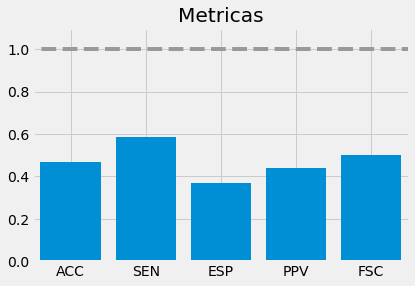

In [178]:
calcula_metricas(confmat)

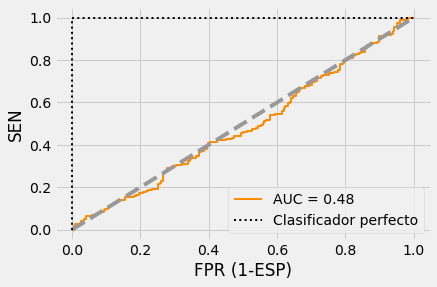

In [179]:
y_scores = modelo.predict(X_test_std_r)
ejex, ejey, _ = roc_curve(y_test, y_scores)
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

In [180]:
predicciones = modelo.predict(exog = sm.add_constant(dfstd.drop(['updownpred', 'closepred'],axis=1), prepend=True))
y_pred = np.where(predicciones<0.5, 0, 1)
updownpred['log_std'] = y_pred
updownpred['log_conf_std']= predicciones
updownpred

,real,log,log_conf,log_std,log_conf_std
date,,,,,
2009-11-02,0,1,0.519419,1,0.519419
2009-11-03,1,1,0.614016,1,0.614016
2009-11-04,1,0,0.495720,0,0.495720
2009-11-05,0,0,0.499710,0,0.499710
2009-11-06,1,1,0.528791,1,0.528791
...,...,...,...,...,...
2022-08-03,1,1,0.506075,1,0.506075
2022-08-04,0,0,0.493650,0,0.493650
2022-08-05,1,0,0.478417,0,0.478417


Observemos que nos ha salido el mismo modelo, por lo que no vamos a considerarlos en nuestro análisis.

In [181]:
updownpred=updownpred.drop(['log_std', 'log_conf_std'],axis=1)

### 4.2 Adaptative boosting

https://www.imurgence.com/home/blog/how-to-create-boosted-classification-model-using-adaptive-boosting-algorithm-in-python#Implementation%20of%20Adaboost%20on%20Wine%20Data%20Set

https://towardsmachinelearning.org/boosting-algorithms/

##### Dataset sin estandarizar

In [182]:
lr = LogisticRegression()
ada_model = AdaBoostClassifier(n_estimators=1000, base_estimator=lr, learning_rate=0.01, random_state=0)
ada_model.fit(X_train,y_train)

AdaBoostClassifier(base_estimator=LogisticRegression(), learning_rate=0.01,
                   n_estimators=1000, random_state=0)

In [183]:
# Accuracy de test del modelo en train
y_pred = ada_model.predict(X_train)
accuracy = accuracy_score(y_true = y_train, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 52.658662092624354% de las predicciones


In [184]:
print(classification_report(y_train,y_pred))

              precision    recall  f1-score   support

           0       0.52      0.36      0.43      1426
           1       0.53      0.69      0.60      1489

    accuracy                           0.53      2915
   macro avg       0.53      0.52      0.51      2915
weighted avg       0.53      0.53      0.51      2915



In [185]:
confmat = confusion_matrix(y_true = y_train, y_pred = y_pred)
confmat

array([[ 513,  913],
       [ 467, 1022]], dtype=int64)

In [186]:
# Accuracy de test del modelo en test
y_pred = ada_model.predict(X_test)
accuracy = accuracy_score(y_true = y_test, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 51.55875299760192% de las predicciones


In [187]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.59      0.35      0.44       226
           1       0.48      0.72      0.58       191

    accuracy                           0.52       417
   macro avg       0.54      0.53      0.51       417
weighted avg       0.54      0.52      0.50       417



In [188]:
confmat = confusion_matrix(y_true = y_test, y_pred = y_pred)
confmat

array([[ 78, 148],
       [ 54, 137]], dtype=int64)

Accuracy:  0.5155875299760192
Recall (Sensitivity):  0.7172774869109948
Specificity:  0.34513274336283184
Precision:  0.4807017543859649
F1:  0.5756302521008403


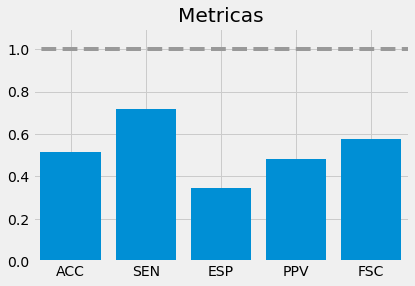

In [189]:
calcula_metricas(confmat)

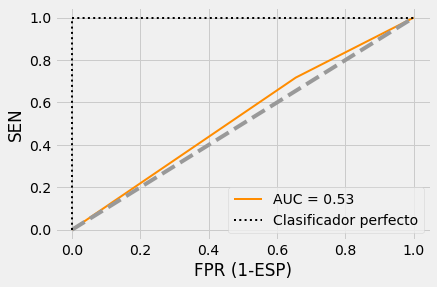

In [190]:
y_scores = ada_model.predict(X_test)
ejex, ejey, _ = roc_curve(y_test, y_scores)
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

In [191]:
y_pred = ada_model.predict(df.drop(['updownpred', 'closepred'],axis=1))
confianza = ada_model.predict_proba(df.drop(['updownpred', 'closepred'],axis=1))
predicciones = []
for i in confianza:
    predicciones.append(i[1])
updownpred['adap'] = y_pred
updownpred['adap_conf']= predicciones
updownpred

,real,log,log_conf,adap,adap_conf
date,,,,,
2009-11-02,0,1,0.519419,1,0.501833
2009-11-03,1,1,0.614016,1,0.504944
2009-11-04,1,0,0.495720,0,0.498727
2009-11-05,0,0,0.499710,1,0.501139
2009-11-06,1,1,0.528791,1,0.501287
...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097
2022-08-04,0,0,0.493650,0,0.497151
2022-08-05,1,0,0.478417,1,0.501058


In [192]:
print(classification_report(updownpred['real'],updownpred['adap']))

              precision    recall  f1-score   support

           0       0.53      0.36      0.43      1652
           1       0.52      0.69      0.59      1680

    accuracy                           0.53      3332
   macro avg       0.53      0.52      0.51      3332
weighted avg       0.53      0.53      0.51      3332



In [193]:
confmat = confusion_matrix(updownpred['real'],updownpred['adap'])
confmat

array([[ 591, 1061],
       [ 521, 1159]], dtype=int64)

Accuracy:  0.5252100840336135
Recall (Sensitivity):  0.6898809523809524
Specificity:  0.3577481840193705
Precision:  0.5220720720720721
F1:  0.5943589743589744


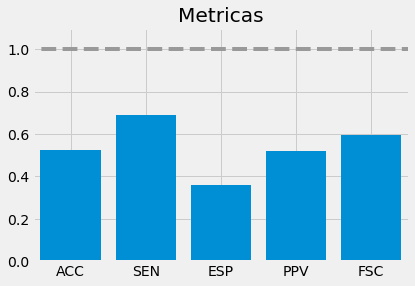

In [194]:
calcula_metricas(confmat)

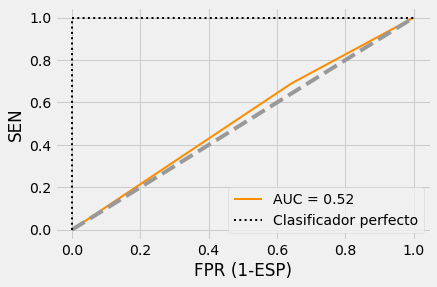

In [195]:
ejex, ejey, _ = roc_curve(updownpred['real'],updownpred['adap'])
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

##### Dataset estandarizado

In [196]:
lr = LogisticRegression()
ada_model = AdaBoostClassifier(n_estimators=1000, base_estimator=lr, learning_rate=0.1, random_state=0)
ada_model.fit(X_train_std,y_train_std)

AdaBoostClassifier(base_estimator=LogisticRegression(), learning_rate=0.1,
                   n_estimators=1000, random_state=0)

In [197]:
# Accuracy de test del modelo en train
y_pred = ada_model.predict(X_train_std)
accuracy = accuracy_score(y_true = y_train_std, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 52.898799313893655% de las predicciones


In [198]:
print(classification_report(y_train_std,y_pred))

              precision    recall  f1-score   support

           0       0.53      0.37      0.43      1426
           1       0.53      0.69      0.60      1489

    accuracy                           0.53      2915
   macro avg       0.53      0.53      0.51      2915
weighted avg       0.53      0.53      0.52      2915



In [199]:
confmat = confusion_matrix(y_true = y_train_std, y_pred = y_pred)
confmat

array([[ 521,  905],
       [ 468, 1021]], dtype=int64)

In [200]:
# Accuracy de test del modelo 
y_pred = ada_model.predict(X_test_std)
accuracy = accuracy_score(y_true = y_test_std, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 50.83932853717026% de las predicciones


In [201]:
print(classification_report(y_test_std,y_pred))

              precision    recall  f1-score   support

           0       0.59      0.30      0.40       226
           1       0.48      0.76      0.59       191

    accuracy                           0.51       417
   macro avg       0.53      0.53      0.49       417
weighted avg       0.54      0.51      0.48       417



In [202]:
confmat = confusion_matrix(y_true = y_test, y_pred = y_pred)
confmat

array([[ 67, 159],
       [ 46, 145]], dtype=int64)

Accuracy:  0.5083932853717026
Recall (Sensitivity):  0.7591623036649214
Specificity:  0.29646017699115046
Precision:  0.4769736842105263
F1:  0.5858585858585859


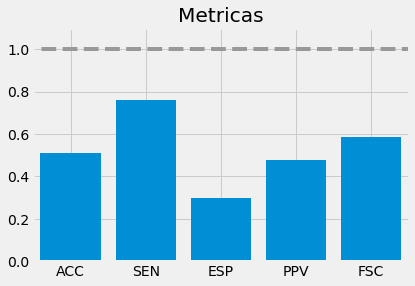

In [203]:
calcula_metricas(confmat)

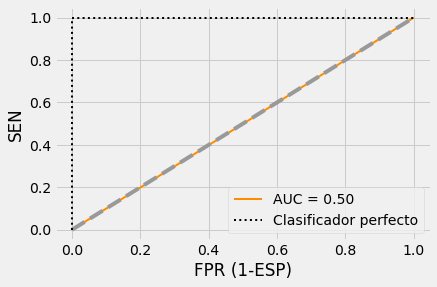

In [204]:
y_scores = ada_model.predict(X_test)
ejex, ejey, _ = roc_curve(y_test, y_scores)
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

In [205]:
y_pred = ada_model.predict(dfstd.drop(['updownpred', 'closepred'],axis=1))
confianza = ada_model.predict_proba(dfstd.drop(['updownpred', 'closepred'],axis=1))
predicciones = []
for i in confianza:
    predicciones.append(i[1])
updownpred['adap_std'] = y_pred
updownpred['adap_conf_std']= predicciones
updownpred

,real,log,log_conf,adap,adap_conf,adap_std,adap_conf_std
date,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,1,0.500256
2009-11-03,1,1,0.614016,1,0.504944,1,0.500718
2009-11-04,1,0,0.495720,0,0.498727,1,0.500073
2009-11-05,0,0,0.499710,1,0.501139,1,0.500179
2009-11-06,1,1,0.528791,1,0.501287,1,0.500373
...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,0,0.499939
2022-08-04,0,0,0.493650,0,0.497151,0,0.499792
2022-08-05,1,0,0.478417,1,0.501058,1,0.500004


In [206]:
print(classification_report(updownpred['real'],updownpred['adap_std']))

              precision    recall  f1-score   support

           0       0.53      0.36      0.43      1652
           1       0.52      0.69      0.60      1680

    accuracy                           0.53      3332
   macro avg       0.53      0.52      0.51      3332
weighted avg       0.53      0.53      0.51      3332



In [207]:
confmat = confusion_matrix(updownpred['real'],updownpred['adap_std'])
confmat

array([[ 588, 1064],
       [ 514, 1166]], dtype=int64)

Accuracy:  0.5264105642256903
Recall (Sensitivity):  0.694047619047619
Specificity:  0.3559322033898305
Precision:  0.5228699551569507
F1:  0.5964194373401535


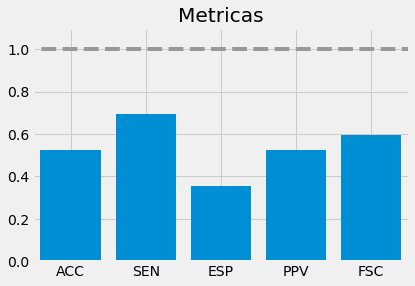

In [208]:
calcula_metricas(confmat)

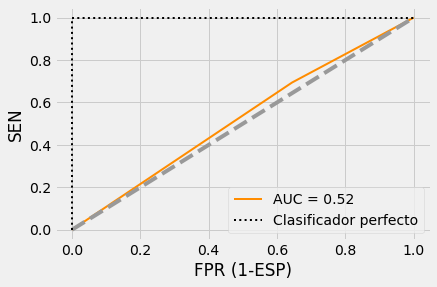

In [209]:
ejex, ejey, _ = roc_curve(updownpred['real'],updownpred['adap_std'])
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

La mejora entre el estandarizado y el sinestandarizar es casi imperceptible. Pero en el confianza de sin estandarizar los valores son un poco más extremos y eso nos interesa para el algoritmo que haré próximamente. Nos quedaremos con ese sacrificando un poco de predicividad.

In [210]:
updownpred = updownpred.drop(['adap_std', 'adap_conf_std'], axis = 1)
updownpred

,real,log,log_conf,adap,adap_conf
date,,,,,
2009-11-02,0,1,0.519419,1,0.501833
2009-11-03,1,1,0.614016,1,0.504944
2009-11-04,1,0,0.495720,0,0.498727
2009-11-05,0,0,0.499710,1,0.501139
2009-11-06,1,1,0.528791,1,0.501287
...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097
2022-08-04,0,0,0.493650,0,0.497151
2022-08-05,1,0,0.478417,1,0.501058


Text(0.5, 0, '0.496 0.497 0.498 0.499 0.501 0.502 0.503 0.504')

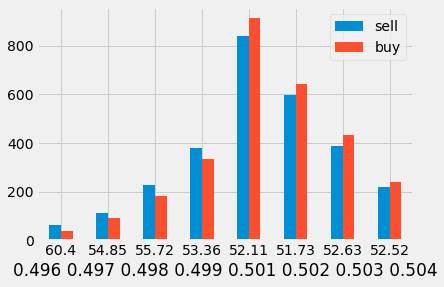

In [211]:
fs = updownpred.loc[updownpred['adap_conf']<0.496, :]['real'].value_counts()
fse = updownpred.loc[updownpred['adap_conf']<0.497, :]['real'].value_counts()
fe = updownpred.loc[updownpred['adap_conf']<0.498, :]['real'].value_counts()
fn = updownpred.loc[updownpred['adap_conf']<0.499, :]['real'].value_counts()
fo = updownpred.loc[updownpred['adap_conf']>0.501, :]['real'].value_counts()
ft = updownpred.loc[updownpred['adap_conf']>0.502, :]['real'].value_counts()
fth = updownpred.loc[updownpred['adap_conf']>0.503, :]['real'].value_counts()
ff = updownpred.loc[updownpred['adap_conf']>0.504, :]['real'].value_counts()

sell = [fs[0], fse[0], fe[0], fn[0], fo[0], ft[0], fth[0], ff[0]]
buy = [fs[1], fse[1], fe[1], fn[1], fo[1], ft[1], fth[1], ff[1]]
index = [100-np.round(sum(updownpred[updownpred['adap_conf'] < 0.496]['real'])*100/len(updownpred[updownpred['adap_conf'] < 0.496]['real']),2),
         100-np.round(sum(updownpred[updownpred['adap_conf'] < 0.497]['real'])*100/len(updownpred[updownpred['adap_conf'] < 0.497]['real']),2), 
         100-np.round(sum(updownpred[updownpred['adap_conf'] < 0.498]['real'])*100/len(updownpred[updownpred['adap_conf'] < 0.498]['real']),2),
         100-np.round(sum(updownpred[updownpred['adap_conf'] < 0.499]['real'])*100/len(updownpred[updownpred['adap_conf'] < 0.499]['real']),2),
         np.round(sum(updownpred[updownpred['adap_conf'] > 0.501]['real'])*100/len(updownpred[updownpred['adap_conf'] > 0.501]['real']),2), 
         np.round(sum(updownpred[updownpred['adap_conf'] > 0.502]['real'])*100/len(updownpred[updownpred['adap_conf'] > 0.502]['real']),2),
         np.round(sum(updownpred[updownpred['adap_conf'] > 0.503]['real'])*100/len(updownpred[updownpred['adap_conf'] > 0.503]['real']),2),
         np.round(sum(updownpred[updownpred['adap_conf'] > 0.504]['real'])*100/len(updownpred[updownpred['adap_conf'] > 0.504]['real']),2)]

# Plot
df_plot = pd.DataFrame({'sell': sell,
                   'buy': buy}, index=index)
ax = df_plot.plot.bar(rot=0)
plt.xlabel('0.496 0.497 0.498 0.499 0.501 0.502 0.503 0.504')

### 4.3 Random Forest

##### Dataset sin estandarizar

In [212]:
model = RandomForestClassifier(n_jobs=-1, random_state=43)
model.fit (X_train, y_train)
print ('Number of Trees used in the model : ', model.n_estimators)

Number of Trees used in the model :  100


In [213]:
# Accuracy de test del modelo en train
y_pred = model.predict(X_train)
accuracy = accuracy_score(y_true = y_train, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 100.0% de las predicciones


In [214]:
print(classification_report(y_pred,y_train))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1426
           1       1.00      1.00      1.00      1489

    accuracy                           1.00      2915
   macro avg       1.00      1.00      1.00      2915
weighted avg       1.00      1.00      1.00      2915



In [215]:
confmat = confusion_matrix(y_true = y_train, y_pred = y_pred)
confmat

array([[1426,    0],
       [   0, 1489]], dtype=int64)

In [216]:
# Accuracy de test del modelo en test
y_pred = model.predict(X_test)
conf = model.predict_proba(X_test)
conf = conf[:,1]
accuracy = accuracy_score(y_true = y_test, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 54.67625899280576% de las predicciones


In [217]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.61      0.47      0.53       226
           1       0.50      0.64      0.56       191

    accuracy                           0.55       417
   macro avg       0.55      0.55      0.55       417
weighted avg       0.56      0.55      0.54       417



In [218]:
confmat = confusion_matrix(y_true = y_test, y_pred = y_pred)
confmat

array([[106, 120],
       [ 69, 122]], dtype=int64)

Accuracy:  0.5467625899280576
Recall (Sensitivity):  0.6387434554973822
Specificity:  0.4690265486725664
Precision:  0.5041322314049587
F1:  0.5635103926096997


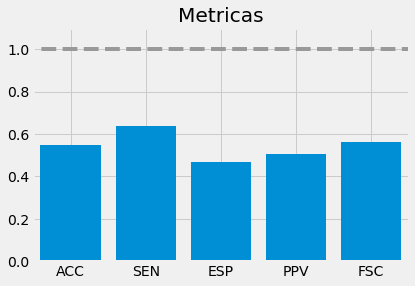

In [219]:
calcula_metricas(confmat)

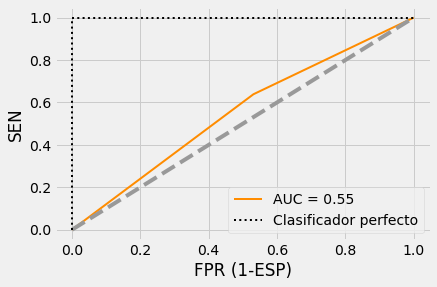

In [220]:
y_scores = model.predict(X_test)
ejex, ejey, _ = roc_curve(y_test, y_scores)
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

In [221]:
y_pred = model.predict(df.drop(['updownpred', 'closepred'],axis=1))
confianza = model.predict_proba(df.drop(['updownpred', 'closepred'],axis=1))
predicciones = []
for i in confianza:
    predicciones.append(i[1])
updownpred['rand'] = y_pred
updownpred['rand_conf']= predicciones
updownpred

,real,log,log_conf,adap,adap_conf,rand,rand_conf
date,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,0,0.29
2009-11-03,1,1,0.614016,1,0.504944,1,0.86
2009-11-04,1,0,0.495720,0,0.498727,1,0.77
2009-11-05,0,0,0.499710,1,0.501139,0,0.26
2009-11-06,1,1,0.528791,1,0.501287,1,0.78
...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58
2022-08-04,0,0,0.493650,0,0.497151,1,0.65
2022-08-05,1,0,0.478417,1,0.501058,1,0.56


In [222]:
print(classification_report(updownpred['real'],updownpred['rand']))

              precision    recall  f1-score   support

           0       0.96      0.93      0.94      1652
           1       0.93      0.96      0.94      1680

    accuracy                           0.94      3332
   macro avg       0.94      0.94      0.94      3332
weighted avg       0.94      0.94      0.94      3332



In [223]:
confmat = confusion_matrix(updownpred['real'],updownpred['rand'])
confmat

array([[1532,  120],
       [  69, 1611]], dtype=int64)

Accuracy:  0.9432773109243697
Recall (Sensitivity):  0.9589285714285715
Specificity:  0.927360774818402
Precision:  0.9306759098786829
F1:  0.9445910290237468


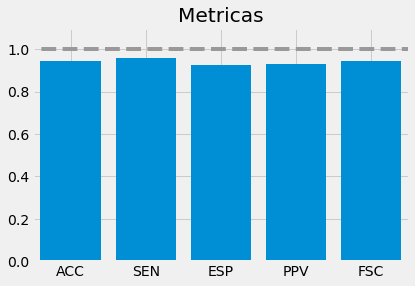

In [224]:
calcula_metricas(confmat)

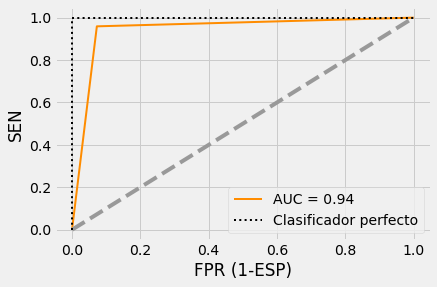

In [225]:
ejex, ejey, _ = roc_curve(updownpred['real'],updownpred['rand'])
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

Text(0.5, 0, '0.3   0.35   0.4   0.45   0.55   0.6   0.65   0.7')

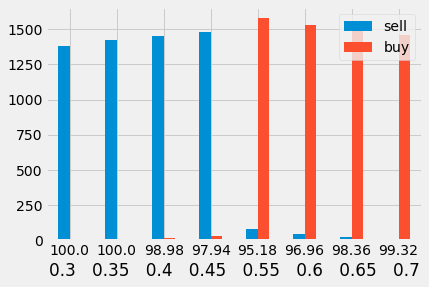

In [226]:
fs = updownpred.loc[updownpred['rand_conf']<0.3, :]['real'].value_counts()
fse = updownpred.loc[updownpred['rand_conf']<0.35, :]['real'].value_counts()
fe = updownpred.loc[updownpred['rand_conf']<0.4, :]['real'].value_counts()
fn = updownpred.loc[updownpred['rand_conf']<0.45, :]['real'].value_counts()
fo = updownpred.loc[updownpred['rand_conf']>0.55, :]['real'].value_counts()
ft = updownpred.loc[updownpred['rand_conf']>0.6, :]['real'].value_counts()
fth = updownpred.loc[updownpred['rand_conf']>0.65, :]['real'].value_counts()
ff = updownpred.loc[updownpred['rand_conf']>0.70, :]['real'].value_counts()

sell = [fs[0], fse[0], fe[0], fn[0], fo[0], ft[0], fth[0], ff[0]]
buy = [0, 0, fe[1], fn[1], fo[1], ft[1], fth[1], ff[1]]
index = [100-np.round(sum(updownpred[updownpred['rand_conf'] < 0.3]['real'])*100/len(updownpred[updownpred['rand_conf'] < 0.3]['real']),2),
         100-np.round(sum(updownpred[updownpred['rand_conf'] < 0.35]['real'])*100/len(updownpred[updownpred['rand_conf'] < 0.35]['real']),2), 
         100-np.round(sum(updownpred[updownpred['rand_conf'] < 0.40]['real'])*100/len(updownpred[updownpred['rand_conf'] < 0.4]['real']),2),
         100-np.round(sum(updownpred[updownpred['rand_conf'] < 0.45]['real'])*100/len(updownpred[updownpred['rand_conf'] < 0.45]['real']),2),
         np.round(sum(updownpred[updownpred['rand_conf'] > 0.55]['real'])*100/len(updownpred[updownpred['rand_conf'] > 0.55]['real']),2), 
         np.round(sum(updownpred[updownpred['rand_conf'] > 0.60]['real'])*100/len(updownpred[updownpred['rand_conf'] > 0.60]['real']),2),
         np.round(sum(updownpred[updownpred['rand_conf'] > 0.65]['real'])*100/len(updownpred[updownpred['rand_conf'] > 0.65]['real']),2),
         np.round(sum(updownpred[updownpred['rand_conf'] > 0.70]['real'])*100/len(updownpred[updownpred['rand_conf'] > 0.70]['real']),2)]

# Plot
df_plot = pd.DataFrame({'sell': sell,
                   'buy': buy}, index=index)
ax = df_plot.plot.bar(rot=0)
plt.xlabel('0.3   0.35   0.4   0.45   0.55   0.6   0.65   0.7')

Está muy sesgado por los datos de training. Veamos qué ocurre si utilizamos sólo los de test.

In [227]:
random = pd.DataFrame()
random['rand_conf'] = conf
random['real'] = list(y_test)
random

,rand_conf,real
0,0.64,1
1,0.37,1
2,0.51,0
3,0.56,0
4,0.39,0
...,...,...
412,0.58,1
413,0.65,0
414,0.56,1
415,0.59,1


Text(0.5, 0, '0.4     0.45     0.55     0.6     0.65     0.7')

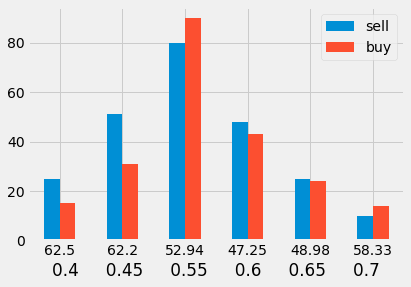

In [228]:
fe = random.loc[random['rand_conf']<0.4, :]['real'].value_counts()
fn = random.loc[random['rand_conf']<0.45, :]['real'].value_counts()
fo = random.loc[random['rand_conf']>0.55, :]['real'].value_counts()
ft = random.loc[random['rand_conf']>0.6, :]['real'].value_counts()
fth = random.loc[random['rand_conf']>0.65, :]['real'].value_counts()
ff = random.loc[random['rand_conf']>0.70, :]['real'].value_counts()

sell = [fe[0], fn[0], fo[0], ft[0], fth[0], ff[0]]
buy = [fe[1], fn[1], fo[1], ft[1], fth[1], ff[1]]
index = [
         100-np.round(sum(random[random['rand_conf'] < 0.40]['real'])*100/len(random[random['rand_conf'] < 0.4]['real']),2),
         100-np.round(sum(random[random['rand_conf'] < 0.45]['real'])*100/len(random[random['rand_conf'] < 0.45]['real']),1),
         np.round(sum(random[random['rand_conf'] > 0.55]['real'])*100/len(random[random['rand_conf'] > 0.55]['real']),2), 
         np.round(sum(random[random['rand_conf'] > 0.60]['real'])*100/len(random[random['rand_conf'] > 0.60]['real']),2),
         np.round(sum(random[random['rand_conf'] > 0.65]['real'])*100/len(random[random['rand_conf'] > 0.65]['real']),2),
         np.round(sum(random[random['rand_conf'] > 0.70]['real'])*100/len(random[random['rand_conf'] > 0.70]['real']),2)]

# Plot
df_plot = pd.DataFrame({'sell': sell,
                   'buy': buy}, index=index)
ax = df_plot.plot.bar(rot=0)
plt.xlabel('0.4     0.45     0.55     0.6     0.65     0.7')

##### Dataset estandarizado

In [229]:
model = RandomForestClassifier(n_jobs=-1, random_state=0)
model.fit (X_train_std, y_train_std)
print ('Number of Trees used in the model : ', model.n_estimators)

Number of Trees used in the model :  100


In [230]:
# Accuracy de test del modelo en train
y_pred = model.predict(X_train_std)
accuracy = accuracy_score(y_true = y_train_std, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 100.0% de las predicciones


In [231]:
print(classification_report(y_train_std,y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1426
           1       1.00      1.00      1.00      1489

    accuracy                           1.00      2915
   macro avg       1.00      1.00      1.00      2915
weighted avg       1.00      1.00      1.00      2915



In [232]:
confmat = confusion_matrix(y_true = y_train_std, y_pred = y_pred)
confmat

array([[1426,    0],
       [   0, 1489]], dtype=int64)

In [233]:
# Accuracy de test del modelo en test
y_pred = model.predict(X_test_std)
conf = model.predict_proba(X_test_std)
conf = conf[:,1]
accuracy = accuracy_score(y_true = y_test_std, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 53.71702637889688% de las predicciones


In [234]:
print(classification_report(y_test_std,y_pred))

              precision    recall  f1-score   support

           0       0.59      0.46      0.52       226
           1       0.50      0.62      0.55       191

    accuracy                           0.54       417
   macro avg       0.54      0.54      0.54       417
weighted avg       0.55      0.54      0.54       417



In [235]:
confmat = confusion_matrix(y_true = y_test_std, y_pred = y_pred)
confmat

array([[105, 121],
       [ 72, 119]], dtype=int64)

Accuracy:  0.5371702637889688
Recall (Sensitivity):  0.6230366492146597
Specificity:  0.4646017699115044
Precision:  0.49583333333333335
F1:  0.5522041763341068


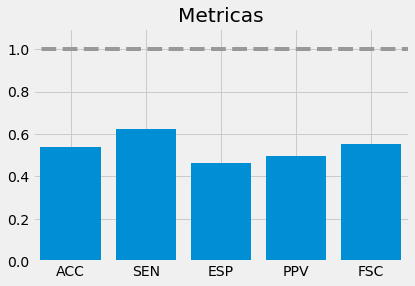

In [236]:
calcula_metricas(confmat)

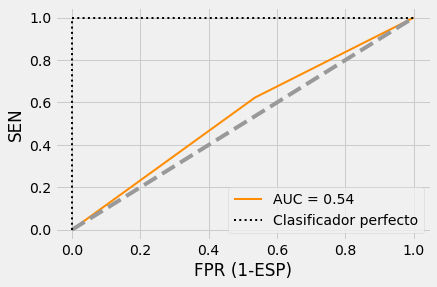

In [237]:
y_scores = model.predict(X_test_std)
ejex, ejey, _ = roc_curve(y_test, y_scores)
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

In [238]:
y_pred = model.predict(dfstd.drop(['updownpred', 'closepred'],axis=1))
confianza = model.predict_proba(dfstd.drop(['updownpred', 'closepred'],axis=1))
predicciones = confianza[:,1]
updownpred['rand_std'] = y_pred
updownpred['rand_conf_std']= predicciones
updownpred

,real,log,log_conf,adap,adap_conf,rand,rand_conf,rand_std,rand_conf_std
date,,,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,0,0.29,0,0.25
2009-11-03,1,1,0.614016,1,0.504944,1,0.86,1,0.86
2009-11-04,1,0,0.495720,0,0.498727,1,0.77,1,0.78
2009-11-05,0,0,0.499710,1,0.501139,0,0.26,0,0.27
2009-11-06,1,1,0.528791,1,0.501287,1,0.78,1,0.75
...,...,...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58,1,0.62
2022-08-04,0,0,0.493650,0,0.497151,1,0.65,1,0.62
2022-08-05,1,0,0.478417,1,0.501058,1,0.56,1,0.57


In [239]:
print(classification_report(updownpred['real'],updownpred['rand_std']))

              precision    recall  f1-score   support

           0       0.96      0.93      0.94      1652
           1       0.93      0.96      0.94      1680

    accuracy                           0.94      3332
   macro avg       0.94      0.94      0.94      3332
weighted avg       0.94      0.94      0.94      3332



In [240]:
confmat = confusion_matrix(updownpred['real'],updownpred['rand_std'])
confmat

array([[1531,  121],
       [  72, 1608]], dtype=int64)

Accuracy:  0.9420768307322929
Recall (Sensitivity):  0.9571428571428572
Specificity:  0.9267554479418886
Precision:  0.9300173510699826
F1:  0.9433851569375183


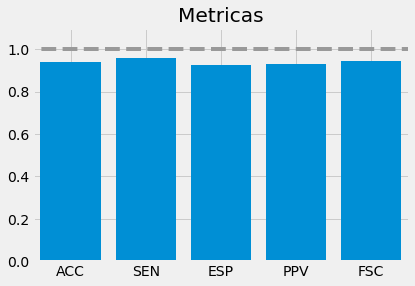

In [241]:
calcula_metricas(confmat)

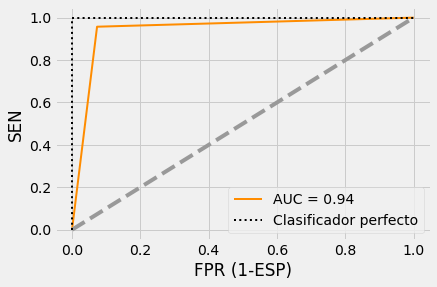

In [242]:
ejex, ejey, _ = roc_curve(updownpred['real'],updownpred['rand_std'])
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

Text(0.5, 0, '0.3   0.35   0.4   0.45   0.55   0.6   0.65   0.7')

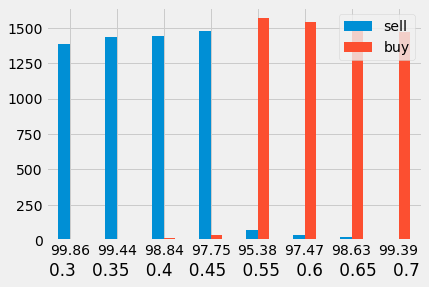

In [243]:
fs = updownpred.loc[updownpred['rand_conf_std']<0.3, :]['real'].value_counts()
fse = updownpred.loc[updownpred['rand_conf_std']<0.35, :]['real'].value_counts()
fe = updownpred.loc[updownpred['rand_conf_std']<0.4, :]['real'].value_counts()
fn = updownpred.loc[updownpred['rand_conf_std']<0.45, :]['real'].value_counts()
fo = updownpred.loc[updownpred['rand_conf_std']>0.55, :]['real'].value_counts()
ft = updownpred.loc[updownpred['rand_conf_std']>0.6, :]['real'].value_counts()
fth = updownpred.loc[updownpred['rand_conf_std']>0.65, :]['real'].value_counts()
ff = updownpred.loc[updownpred['rand_conf_std']>0.70, :]['real'].value_counts()

sell = [fs[0], fse[0], fe[0], fn[0], fo[0], ft[0], fth[0], ff[0]]
buy = [fs[1], fse[1], fe[1], fn[1], fo[1], ft[1], fth[1], ff[1]]
index = [100-np.round(sum(updownpred[updownpred['rand_conf_std'] < 0.3]['real'])*100/len(updownpred[updownpred['rand_conf_std'] < 0.3]['real']),2),
         100-np.round(sum(updownpred[updownpred['rand_conf_std'] < 0.35]['real'])*100/len(updownpred[updownpred['rand_conf_std'] < 0.35]['real']),2), 
         100-np.round(sum(updownpred[updownpred['rand_conf_std'] < 0.40]['real'])*100/len(updownpred[updownpred['rand_conf_std'] < 0.4]['real']),2),
         100-np.round(sum(updownpred[updownpred['rand_conf_std'] < 0.45]['real'])*100/len(updownpred[updownpred['rand_conf_std'] < 0.45]['real']),2),
         np.round(sum(updownpred[updownpred['rand_conf_std'] > 0.55]['real'])*100/len(updownpred[updownpred['rand_conf_std'] > 0.55]['real']),2), 
         np.round(sum(updownpred[updownpred['rand_conf_std'] > 0.60]['real'])*100/len(updownpred[updownpred['rand_conf_std'] > 0.60]['real']),2),
         np.round(sum(updownpred[updownpred['rand_conf_std'] > 0.65]['real'])*100/len(updownpred[updownpred['rand_conf_std'] > 0.65]['real']),2),
         np.round(sum(updownpred[updownpred['rand_conf_std'] > 0.70]['real'])*100/len(updownpred[updownpred['rand_conf_std'] > 0.70]['real']),2)]

# Plot
df_plot = pd.DataFrame({'sell': sell,
                   'buy': buy}, index=index)
ax = df_plot.plot.bar(rot=0)
plt.xlabel('0.3   0.35   0.4   0.45   0.55   0.6   0.65   0.7')

Está muy sesgado por los datos de training. Veamos qué ocurre si utilizamos sólo los de test.

In [244]:
random['rand_conf_std'] = conf
random

,rand_conf,real,rand_conf_std
0,0.64,1,0.69
1,0.37,1,0.39
2,0.51,0,0.48
3,0.56,0,0.31
4,0.39,0,0.42
...,...,...,...
412,0.58,1,0.62
413,0.65,0,0.62
414,0.56,1,0.57
415,0.59,1,0.57


Text(0.5, 0, '0.4           0.45          0.55           0.6')

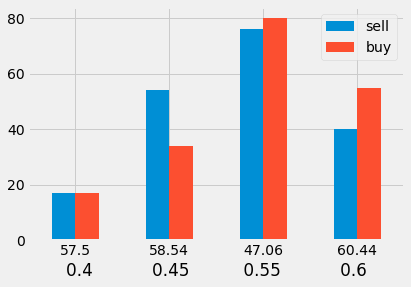

In [245]:
fe = random.loc[random['rand_conf_std']<0.4, :]['real'].value_counts()
fn = random.loc[random['rand_conf_std']<0.45, :]['real'].value_counts()
fo = random.loc[random['rand_conf_std']>0.55, :]['real'].value_counts()
ft = random.loc[random['rand_conf_std']>0.6, :]['real'].value_counts()


sell = [fe[0], fn[0], fo[0], ft[0]]
buy = [fe[1], fn[1], fo[1], ft[1]]
index = [
         100-np.round(sum(random[random['rand_conf_std'] < 0.40]['real'])*100/len(random[random['rand_conf'] < 0.4]['real']),2),
         100-np.round(sum(random[random['rand_conf_std'] < 0.45]['real'])*100/len(random[random['rand_conf'] < 0.45]['real']),2),
         np.round(sum(random[random['rand_conf_std'] > 0.55]['real'])*100/len(random[random['rand_conf'] > 0.55]['real']),2), 
         np.round(sum(random[random['rand_conf_std'] > 0.60]['real'])*100/len(random[random['rand_conf'] > 0.60]['real']),2)]

# Plot
df_plot = pd.DataFrame({'sell': sell,
                   'buy': buy}, index=index)
ax = df_plot.plot.bar(rot=0)
plt.xlabel('0.4           0.45          0.55           0.6')

Parece que los resultados son mejores con el dataset sin estandarizar. Nos quedaremos con ese.

In [246]:
updownpred = updownpred.drop(['rand_std', 'rand_conf_std'], axis = 1)
updownpred

,real,log,log_conf,adap,adap_conf,rand,rand_conf
date,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,0,0.29
2009-11-03,1,1,0.614016,1,0.504944,1,0.86
2009-11-04,1,0,0.495720,0,0.498727,1,0.77
2009-11-05,0,0,0.499710,1,0.501139,0,0.26
2009-11-06,1,1,0.528791,1,0.501287,1,0.78
...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58
2022-08-04,0,0,0.493650,0,0.497151,1,0.65
2022-08-05,1,0,0.478417,1,0.501058,1,0.56


### 4.4 Red neuronal

In [247]:
# Espacio de búsqueda de cada hiperparámetro
# ==============================================================================
param_distributions = {
    'modelo__hidden_layer_sizes': [(10,20), (100,150), (100,200,300)],
    'modelo__alpha': np.logspace(-3, 2, 10),
    'modelo__learning_rate_init': [0.001, 0.01],
}

# Pipeline que definirá el modelo
# ==============================================================================
pipe = Pipeline([('modelo', MLPClassifier(solver = 'adam', activation = 'logistic', learning_rate = 'constant', max_iter= 200, random_state=0))])

# Búsqueda por validación cruzada
# ==============================================================================
grid = RandomizedSearchCV(
        estimator  = pipe,
        param_distributions = param_distributions,
        n_iter     = 50,
        scoring    = ['accuracy', 'precision', 'f1', 'neg_mean_squared_error'],
        n_jobs     = multiprocessing.cpu_count() - 1,
        cv         = 5, 
        verbose    = 0,
        random_state = 43,
        return_train_score = False,
        refit = False
       )

grid.fit(X = X_train_std, y = y_train_std)

# Resultados del grid
# ==============================================================================
resultados = pd.DataFrame(grid.cv_results_)
resultados = resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')
resultados[resultados['mean_test_accuracy']<0.502].sort_values('mean_test_accuracy', ascending = False)\
    .head(10)

,param_modelo__learning_rate_init,param_modelo__hidden_layer_sizes,param_modelo__alpha,mean_test_accuracy,std_test_accuracy,mean_test_precision,std_test_precision,mean_test_f1,std_test_f1,mean_test_neg_mean_squared_error,std_test_neg_mean_squared_error
28,0.001,"(100, 150)",2.154435,0.501887,0.010662,0.306346,0.250132,0.405602,0.331173,-0.498113,0.010662
24,0.01,"(100, 200, 300)",0.16681,0.501887,0.010662,0.306346,0.250132,0.405602,0.331173,-0.498113,0.010662
34,0.001,"(100, 150)",0.599484,0.501887,0.010662,0.306346,0.250132,0.405602,0.331173,-0.498113,0.010662
11,0.01,"(100, 150)",0.599484,0.501887,0.010662,0.306346,0.250132,0.405602,0.331173,-0.498113,0.010662
27,0.01,"(100, 150)",2.154435,0.501887,0.010662,0.306346,0.250132,0.405602,0.331173,-0.498113,0.010662
35,0.001,"(10, 20)",0.16681,0.501544,0.022719,0.506465,0.012257,0.643609,0.028110,-0.498456,0.022719
45,0.01,"(100, 200, 300)",0.003594,0.500172,0.020371,0.510264,0.018086,0.567788,0.092640,-0.499828,0.020371
43,0.01,"(10, 20)",0.001,0.499828,0.013918,0.510872,0.011822,0.520856,0.037383,-0.500172,0.013918
17,0.001,"(100, 150)",0.16681,0.499828,0.014335,0.501589,0.014247,0.599555,0.138476,-0.500172,0.014335
36,0.001,"(10, 20)",0.012915,0.499485,0.019388,0.505802,0.011058,0.625780,0.033883,-0.500515,0.019388


In [248]:
neural_final = Pipeline(steps=[('modelo',
                 MLPClassifier(activation='logistic', alpha=0.046416,
                               hidden_layer_sizes=(100, 150), random_state=0))])
neural_final.fit(X = X_train_std, y = y_train_std)
neural_final['modelo'].get_params()

{'activation': 'logistic',
 'alpha': 0.046416,
 'batch_size': 'auto',
 'beta_1': 0.9,
 'beta_2': 0.999,
 'early_stopping': False,
 'epsilon': 1e-08,
 'hidden_layer_sizes': (100, 150),
 'learning_rate': 'constant',
 'learning_rate_init': 0.001,
 'max_fun': 15000,
 'max_iter': 200,
 'momentum': 0.9,
 'n_iter_no_change': 10,
 'nesterovs_momentum': True,
 'power_t': 0.5,
 'random_state': 0,
 'shuffle': True,
 'solver': 'adam',
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': False,
 'warm_start': False}

Nos sale que los mejores resultados los obtenemos con:

    1. Una red neuronal de 4 capas ocultas de 10, 20,30 y 40 neuronas cada una
    2. Un valor de alpha de 1000
    3. Un learning_rate_init de 0.01

In [249]:
# Accuracy de test del modelo en train
confianza = neural_final.predict_proba(X = X_train_std)
y_pred = neural_final.predict(X = X_train_std)
accuracy = accuracy_score(y_true = y_train_std, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 52.795883361921106% de las predicciones


In [250]:
print(classification_report(y_train_std,y_pred))

              precision    recall  f1-score   support

           0       0.53      0.33      0.40      1426
           1       0.53      0.72      0.61      1489

    accuracy                           0.53      2915
   macro avg       0.53      0.52      0.51      2915
weighted avg       0.53      0.53      0.51      2915



In [251]:
confmat = confusion_matrix(y_true = y_train, y_pred = y_pred)
confmat

array([[ 468,  958],
       [ 418, 1071]], dtype=int64)

In [252]:
# Accuracy de test del modelo en test
confianza = neural_final.predict_proba(X = X_test_std)
y_pred = neural_final.predict(X = X_test_std)
accuracy = accuracy_score(y_true = y_test_std, y_pred = y_pred, normalize = True)
print(f"Acertamos el {100*accuracy}% de las predicciones")

Acertamos el 50.83932853717026% de las predicciones


In [253]:
print(classification_report(y_test_std,y_pred))

              precision    recall  f1-score   support

           0       0.60      0.27      0.37       226
           1       0.48      0.79      0.60       191

    accuracy                           0.51       417
   macro avg       0.54      0.53      0.48       417
weighted avg       0.55      0.51      0.48       417



In [254]:
confmat = confusion_matrix(y_true = y_test_std, y_pred = y_pred)
confmat

array([[ 61, 165],
       [ 40, 151]], dtype=int64)

Accuracy:  0.5083932853717026
Recall (Sensitivity):  0.7905759162303665
Specificity:  0.26991150442477874
Precision:  0.4778481012658228
F1:  0.5956607495069033


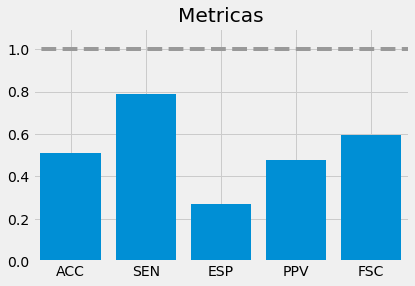

In [255]:
calcula_metricas(confmat)

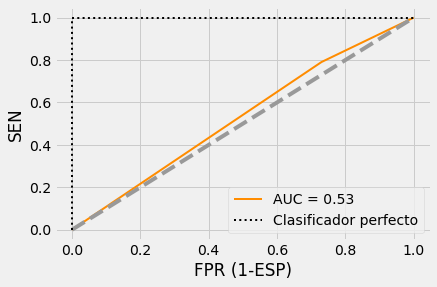

In [256]:
y_scores = neural_final.predict(X_test_std)
ejex, ejey, _ = roc_curve(y_test, y_scores)
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

In [257]:
y_pred = neural_final.predict(dfstd.drop(['updownpred', 'closepred'],axis=1))
confianza = neural_final.predict_proba(dfstd.drop(['updownpred', 'closepred'],axis=1))
predicciones = confianza[:,1]
updownpred['neural'] = y_pred
updownpred['neural_conf']= predicciones
updownpred

,real,log,log_conf,adap,adap_conf,rand,rand_conf,neural,neural_conf
date,,,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,0,0.29,1,0.528425
2009-11-03,1,1,0.614016,1,0.504944,1,0.86,1,0.554339
2009-11-04,1,0,0.495720,0,0.498727,1,0.77,1,0.511650
2009-11-05,0,0,0.499710,1,0.501139,0,0.26,1,0.523186
2009-11-06,1,1,0.528791,1,0.501287,1,0.78,1,0.535357
...,...,...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58,0,0.495546
2022-08-04,0,0,0.493650,0,0.497151,1,0.65,0,0.476496
2022-08-05,1,0,0.478417,1,0.501058,1,0.56,1,0.508200


In [258]:
print(classification_report(updownpred['real'],updownpred['neural']))

              precision    recall  f1-score   support

           0       0.54      0.32      0.40      1652
           1       0.52      0.73      0.61      1680

    accuracy                           0.53      3332
   macro avg       0.53      0.52      0.50      3332
weighted avg       0.53      0.53      0.50      3332



In [259]:
confmat = confusion_matrix(updownpred['real'],updownpred['neural'])
confmat

array([[ 529, 1123],
       [ 458, 1222]], dtype=int64)

Accuracy:  0.5255102040816326
Recall (Sensitivity):  0.7273809523809524
Specificity:  0.3202179176755448
Precision:  0.5211087420042644
F1:  0.6072049689440994


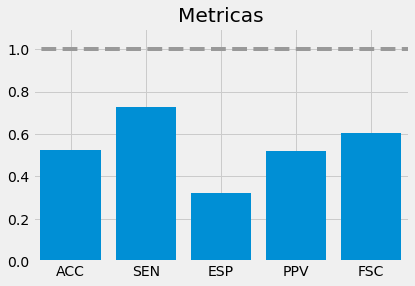

In [260]:
calcula_metricas(confmat)

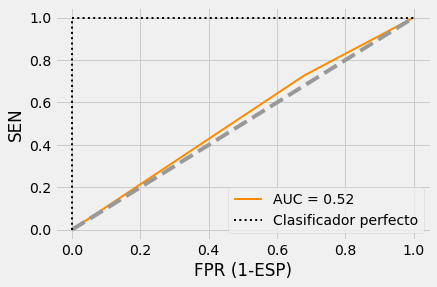

In [261]:
ejex, ejey, _ = roc_curve(updownpred['real'],updownpred['neural'])
roc_auc = auc(ejex, ejey)

plt.figure()
plt.plot(ejex, ejey, color='darkorange',lw=2, label='AUC = %0.2f' % roc_auc)

plt.plot([0, 1], [0, 1], color=(0.6, 0.6, 0.6), linestyle='--')
plt.plot([0, 0, 1],[0, 1, 1],lw=2, linestyle=':',color='black',label='Clasificador perfecto')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])

plt.xlabel('FPR (1-ESP)')
plt.ylabel('SEN')
plt.legend(loc="lower right")
plt.show()

Text(0.5, 0, '0.46  0.47  0.48  0.49  0.51  0.52  0.53  0.54')

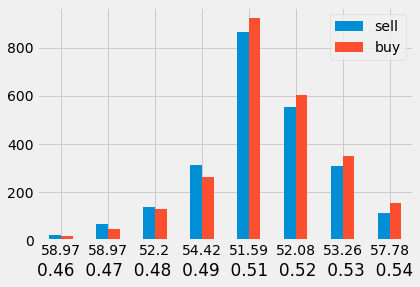

In [262]:
fs = updownpred.loc[updownpred['neural_conf']<0.46, :]['real'].value_counts()
fse = updownpred.loc[updownpred['neural_conf']<0.47, :]['real'].value_counts()
fe = updownpred.loc[updownpred['neural_conf']<0.48, :]['real'].value_counts()
fn = updownpred.loc[updownpred['neural_conf']<0.49, :]['real'].value_counts()
fo = updownpred.loc[updownpred['neural_conf']>0.51, :]['real'].value_counts()
ft = updownpred.loc[updownpred['neural_conf']>0.52, :]['real'].value_counts()
fth = updownpred.loc[updownpred['neural_conf']>0.53, :]['real'].value_counts()
ff = updownpred.loc[updownpred['neural_conf']>0.54, :]['real'].value_counts()

sell = [fs[0], fse[0], fe[0], fn[0], fo[0], ft[0], fth[0], ff[0]]
buy = [fs[1], fse[1], fe[1], fn[1], fo[1], ft[1], fth[1], ff[1]]
index = [100-np.round(sum(updownpred[updownpred['neural_conf'] < 0.46]['real'])*100/len(updownpred[updownpred['neural_conf'] < 0.46]['real']),2),
         100-np.round(sum(updownpred[updownpred['neural_conf'] < 0.47]['real'])*100/len(updownpred[updownpred['neural_conf'] < 0.47]['real']),2), 
         100-np.round(sum(updownpred[updownpred['neural_conf'] < 0.48]['real'])*100/len(updownpred[updownpred['neural_conf'] < 0.48]['real']),1),
         100-np.round(sum(updownpred[updownpred['neural_conf'] < 0.49]['real'])*100/len(updownpred[updownpred['neural_conf'] < 0.49]['real']),2),
         np.round(sum(updownpred[updownpred['neural_conf'] > 0.51]['real'])*100/len(updownpred[updownpred['neural_conf'] > 0.51]['real']),2), 
         np.round(sum(updownpred[updownpred['neural_conf'] > 0.52]['real'])*100/len(updownpred[updownpred['neural_conf'] > 0.52]['real']),2),
         np.round(sum(updownpred[updownpred['neural_conf'] > 0.53]['real'])*100/len(updownpred[updownpred['neural_conf'] > 0.53]['real']),2),
         np.round(sum(updownpred[updownpred['neural_conf'] > 0.54]['real'])*100/len(updownpred[updownpred['neural_conf'] > 0.54]['real']),2)]

# Plot
df_plot = pd.DataFrame({'sell': sell,
                   'buy': buy}, index=index)
ax = df_plot.plot.bar(rot=0)
plt.xlabel('0.46  0.47  0.48  0.49  0.51  0.52  0.53  0.54')

## 5. Desarrollo del algoritmo de inversión

### 5.1 Binario con alto riesgo

In [263]:
updownpred['close']=df['close']
updownpred

,real,log,log_conf,adap,adap_conf,rand,rand_conf,neural,neural_conf,close
date,,,,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,0,0.29,1,0.528425,1.4769
2009-11-03,1,1,0.614016,1,0.504944,1,0.86,1,0.554339,1.4715
2009-11-04,1,0,0.495720,0,0.498727,1,0.77,1,0.511650,1.4878
2009-11-05,0,0,0.499710,1,0.501139,0,0.26,1,0.523186,1.4881
2009-11-06,1,1,0.528791,1,0.501287,1,0.78,1,0.535357,1.4849
...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58,0,0.495546,1.0164
2022-08-04,0,0,0.493650,0,0.497151,1,0.65,0,0.476496,1.0243
2022-08-05,1,0,0.478417,1,0.501058,1,0.56,1,0.508200,1.0181


In [264]:
def implement_strategy3(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if (log[i] == 1 and rand[i] == 1 and adap[i] == 1) or (log[i] == 1 and rand[i] == 1 and neural[i] == 1) or (neural[i] == 1 and rand[i] == 1 and adap[i] == 1) or (log[i] == 1 and neural[i] == 1 and adap[i] == 1):
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif (log[i] == 0 and rand[i] == 0 and adap[i] == 0) or (log[i] == 0 and rand[i] == 0 and neural[i] == 0) or (neural[i] == 0 and rand[i] == 0 and adap[i] == 0) or (log[i] == 0 and neural[i] == 0 and adap[i] == 0):
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy3(updownpred['close'], updownpred['log'], updownpred['adap'], updownpred['rand'], updownpred['neural'])

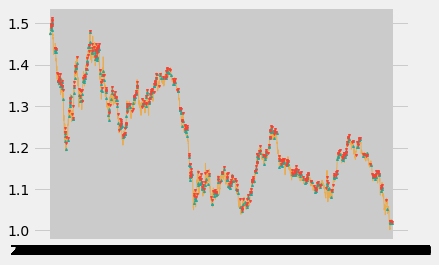

In [265]:
plt.figure()
plt.plot(updownpred.index, updownpred['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(updownpred.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(updownpred.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [266]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(updownpred['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
        
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(updownpred.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(updownpred.index)

frames = [updownpred['close'], updownpred['log'], updownpred['adap'], updownpred['rand'], updownpred['neural'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand,neural,algor_signal,algor_position
date,,,,,,,
2009-11-02,1.4769,1,1,0,1,1,1
2009-11-03,1.4715,1,1,1,1,0,1
2009-11-04,1.4878,0,0,1,1,0,1
2009-11-05,1.4881,0,1,0,1,0,1
2009-11-06,1.4849,1,1,1,1,0,1
...,...,...,...,...,...,...,...
2022-08-03,1.0164,1,0,1,0,0,0
2022-08-04,1.0243,0,0,1,0,0,0
2022-08-05,1.0181,0,1,1,1,1,1


In [267]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(updownpred['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/updownpred['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 3 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : 127743.81
Profit percentage of the algoritmic 3 strategy : 127%


In [478]:
def implement_strategy3(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if (log[i] == 1 and rand[i] == 1 and adap[i] == 1) or (log[i] == 1 and rand[i] == 1 and neural[i] == 1) or (neural[i] == 1 and rand[i] == 1 and adap[i] == 1) or (log[i] == 1 and neural[i] == 1 and adap[i] == 1):
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif (log[i] == 0 and rand[i] == 0 and adap[i] == 0) or (log[i] == 0 and rand[i] == 0 and neural[i] == 0) or (neural[i] == 0 and rand[i] == 0 and adap[i] == 0) or (log[i] == 0 and neural[i] == 0 and adap[i] == 0):
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy3(updownpred2['close'], updownpred2['log'], updownpred2['adap'], updownpred2['rand'], updownpred2['neural'])

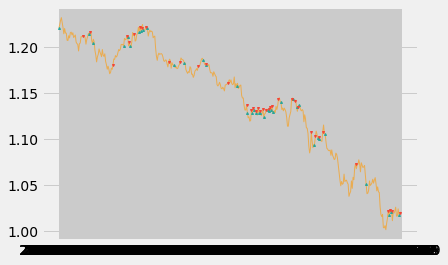

In [479]:
plt.figure()
plt.plot(updownpred2.index, updownpred2['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(updownpred2.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(updownpred2.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [481]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(updownpred2['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
        
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(updownpred2.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(updownpred2.index)

frames = [updownpred2['close'], updownpred2['log'], updownpred2['adap'], updownpred2['rand'], updownpred2['neural'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand,neural,algor_signal,algor_position
date,,,,,,,
2021-01-01,1.2212,1,1,1,1,1,1
2021-01-04,1.2248,1,1,1,1,0,1
2021-01-05,1.2294,1,1,0,1,0,1
2021-01-06,1.2325,1,0,1,1,0,1
2021-01-07,1.2270,1,1,1,1,0,1
...,...,...,...,...,...,...,...
2022-08-03,1.0164,1,0,1,0,0,0
2022-08-04,1.0243,0,0,1,0,0,0
2022-08-05,1.0181,0,1,1,1,1,1


In [495]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(updownpred2['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
stop_loss_precision = 105.95
number_of_stocks = math.floor(investment_value/updownpred2['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
algor_investment_ret_df['investment_returns'] = stop_loss_precition
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 3 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : 44181.15
Profit percentage of the algoritmic 3 strategy : 44%


### 5.2 Binario con bajo riesgo

In [268]:
updownpred

,real,log,log_conf,adap,adap_conf,rand,rand_conf,neural,neural_conf,close
date,,,,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,0,0.29,1,0.528425,1.4769
2009-11-03,1,1,0.614016,1,0.504944,1,0.86,1,0.554339,1.4715
2009-11-04,1,0,0.495720,0,0.498727,1,0.77,1,0.511650,1.4878
2009-11-05,0,0,0.499710,1,0.501139,0,0.26,1,0.523186,1.4881
2009-11-06,1,1,0.528791,1,0.501287,1,0.78,1,0.535357,1.4849
...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58,0,0.495546,1.0164
2022-08-04,0,0,0.493650,0,0.497151,1,0.65,0,0.476496,1.0243
2022-08-05,1,0,0.478417,1,0.501058,1,0.56,1,0.508200,1.0181


In [462]:
def implement_strategy4(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if log[i] == 1 and rand[i] == 1 and adap[i] == 1 and neural[i] == 1:
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif log[i] == 0 and rand[i] == 0 and adap[i] == 0 and neural[i] == 0:
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy4(updownpred['close'], updownpred['log'], updownpred['adap'], updownpred['rand'], updownpred['neural'])

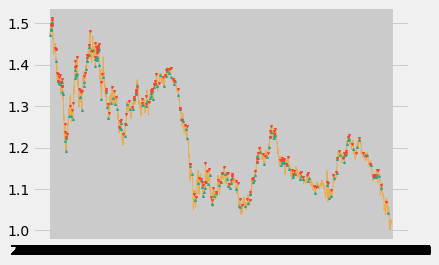

In [270]:
plt.figure()
plt.plot(updownpred.index, updownpred['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(updownpred.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(updownpred.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [463]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(updownpred['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(updownpred.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(updownpred.index)

frames = [updownpred['close'], updownpred['log'], updownpred['adap'], updownpred['rand'], updownpred['neural'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand,neural,algor_signal,algor_position
date,,,,,,,
2009-11-02,1.4769,1,1,0,1,0,1
2009-11-03,1.4715,1,1,1,1,1,1
2009-11-04,1.4878,0,0,1,1,0,1
2009-11-05,1.4881,0,1,0,1,0,1
2009-11-06,1.4849,1,1,1,1,0,1
...,...,...,...,...,...,...,...
2022-08-03,1.0164,1,0,1,0,0,1
2022-08-04,1.0243,0,0,1,0,0,1
2022-08-05,1.0181,0,1,1,1,0,1


In [464]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(updownpred['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/updownpred['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 4 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 4 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 4 strategy by investing $100k in EURUSD : 157006.19
Profit percentage of the algoritmic 4 strategy : 157%


In [471]:
updownpred2 = updownpred.loc['2021-01-01':]
updownpred2

,real,log,log_conf,adap,adap_conf,rand,rand_conf,neural,neural_conf,close
date,,,,,,,,,,
2021-01-01,1,1,0.530621,1,0.502103,1,0.83,1,0.526166,1.2212
2021-01-04,1,1,0.501390,1,0.502857,1,0.64,1,0.511520,1.2248
2021-01-05,1,1,0.501009,1,0.500263,0,0.37,1,0.505066,1.2294
2021-01-06,0,1,0.509385,0,0.499226,1,0.51,1,0.500096,1.2325
2021-01-07,0,1,0.513065,1,0.501054,1,0.56,1,0.520230,1.2270
...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58,0,0.495546,1.0164
2022-08-04,0,0,0.493650,0,0.497151,1,0.65,0,0.476496,1.0243
2022-08-05,1,0,0.478417,1,0.501058,1,0.56,1,0.508200,1.0181


In [498]:
def implement_strategy4(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if log[i] == 1 and rand[i] == 1 and adap[i] == 1 and neural[i] == 1:
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif log[i] == 0 and rand[i] == 0 and adap[i] == 0 and neural[i] == 0:
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy4(updownpred2['close'], updownpred2['log'], updownpred2['adap'], updownpred2['rand'], updownpred2['neural'])

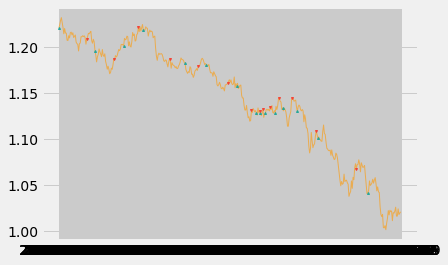

In [474]:
plt.figure()
plt.plot(updownpred2.index, updownpred2['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(updownpred2.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(updownpred2.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [499]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(updownpred2['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(updownpred2.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(updownpred2.index)

frames = [updownpred2['close'], updownpred2['log'], updownpred2['adap'], updownpred2['rand'], updownpred2['neural'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand,neural,algor_signal,algor_position
date,,,,,,,
2021-01-01,1.2212,1,1,1,1,1,1
2021-01-04,1.2248,1,1,1,1,0,1
2021-01-05,1.2294,1,1,0,1,0,1
2021-01-06,1.2325,1,0,1,1,0,1
2021-01-07,1.2270,1,1,1,1,0,1
...,...,...,...,...,...,...,...
2022-08-03,1.0164,1,0,1,0,0,1
2022-08-04,1.0243,0,0,1,0,0,1
2022-08-05,1.0181,0,1,1,1,0,1


In [504]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(updownpred2['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
stop_loss_precision = 155.13
number_of_stocks = math.floor(investment_value/updownpred2['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
algor_investment_ret_df['investment_returns'] = stop_loss_precision
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 4 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 4 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 4 strategy by investing $100k in EURUSD : 64689.21
Profit percentage of the algoritmic 4 strategy : 64%


### 5.3 Confianza con alto riesgo

In [273]:
updownpred

,real,log,log_conf,adap,adap_conf,rand,rand_conf,neural,neural_conf,close
date,,,,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,0,0.29,1,0.528425,1.4769
2009-11-03,1,1,0.614016,1,0.504944,1,0.86,1,0.554339,1.4715
2009-11-04,1,0,0.495720,0,0.498727,1,0.77,1,0.511650,1.4878
2009-11-05,0,0,0.499710,1,0.501139,0,0.26,1,0.523186,1.4881
2009-11-06,1,1,0.528791,1,0.501287,1,0.78,1,0.535357,1.4849
...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58,0,0.495546,1.0164
2022-08-04,0,0,0.493650,0,0.497151,1,0.65,0,0.476496,1.0243
2022-08-05,1,0,0.478417,1,0.501058,1,0.56,1,0.508200,1.0181


In [274]:
def implement_strategyconf3(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if (log[i] > 0.55 and rand[i] > 0.55 and adap[i] > 0.504) or (log[i] > 0.55 and rand[i] > 0.55 and neural[i] > 0.52) or (neural[i] > 0.52 and rand[i] > 0.55 and adap[i] > 0.504) or (log[i] > 0.55 and neural[i] > 0.52 and adap[i] > 0.504):
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif (log[i] < 0.45 and rand[i] < 0.45  and adap[i] < 0.498) or (log[i] < 0.45 and rand[i] < 0.45 and neural[i] < 0.49) or (neural[i] < 0.49 and rand[i] < 0.45 and adap[i] < 0.498) or (log[i] < 0.45 and neural[i] < 0.49 and adap[i] < 0.498):
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategyconf3(updownpred['close'], updownpred['log_conf'], updownpred['adap_conf'], updownpred['rand_conf'], updownpred['neural_conf'])

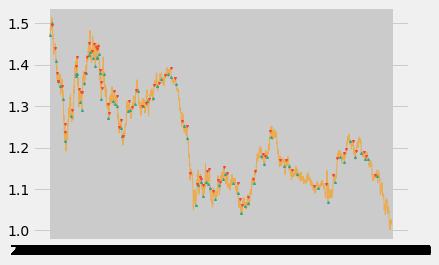

In [275]:
plt.figure()
plt.plot(updownpred.index, updownpred['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(updownpred.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(updownpred.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [276]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(updownpred['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
        
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(updownpred.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(updownpred.index)

frames = [updownpred['close'], updownpred['log_conf'], updownpred['adap_conf'], updownpred['rand_conf'], updownpred['neural_conf'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log_conf,adap_conf,rand_conf,neural_conf,algor_signal,algor_position
date,,,,,,,
2009-11-02,1.4769,0.519419,0.501833,0.29,0.528425,0,1
2009-11-03,1.4715,0.614016,0.504944,0.86,0.554339,1,1
2009-11-04,1.4878,0.495720,0.498727,0.77,0.511650,0,1
2009-11-05,1.4881,0.499710,0.501139,0.26,0.523186,0,1
2009-11-06,1.4849,0.528791,0.501287,0.78,0.535357,0,1
...,...,...,...,...,...,...,...
2022-08-03,1.0164,0.506075,0.498097,0.58,0.495546,0,1
2022-08-04,1.0243,0.493650,0.497151,0.65,0.476496,0,1
2022-08-05,1.0181,0.478417,0.501058,0.56,0.508200,0,1


In [277]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(updownpred['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/updownpred['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic conf 3 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic conf 3 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic conf 3 strategy by investing $100k in EURUSD : 48408.28
Profit percentage of the algoritmic conf 3 strategy : 48%


### 5.3 Confianza con bajo riesgo

In [278]:
updownpred

,real,log,log_conf,adap,adap_conf,rand,rand_conf,neural,neural_conf,close
date,,,,,,,,,,
2009-11-02,0,1,0.519419,1,0.501833,0,0.29,1,0.528425,1.4769
2009-11-03,1,1,0.614016,1,0.504944,1,0.86,1,0.554339,1.4715
2009-11-04,1,0,0.495720,0,0.498727,1,0.77,1,0.511650,1.4878
2009-11-05,0,0,0.499710,1,0.501139,0,0.26,1,0.523186,1.4881
2009-11-06,1,1,0.528791,1,0.501287,1,0.78,1,0.535357,1.4849
...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1,1,0.506075,0,0.498097,1,0.58,0,0.495546,1.0164
2022-08-04,0,0,0.493650,0,0.497151,1,0.65,0,0.476496,1.0243
2022-08-05,1,0,0.478417,1,0.501058,1,0.56,1,0.508200,1.0181


In [279]:
def implement_strategyconf4(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if log[i] > 0.55 and rand[i] > 0.55 and adap[i] > 0.501 and neural[i] > 0.51: 
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif log[i] < 0.45 and rand[i] < 0.45  and adap[i] < 0.499 and neural[i] < 0.49:
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategyconf4(updownpred['close'], updownpred['log_conf'], updownpred['adap_conf'], updownpred['rand_conf'], updownpred['neural_conf'])

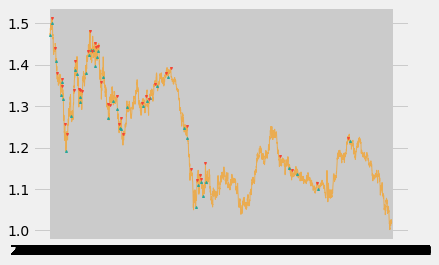

In [280]:
plt.figure()
plt.plot(updownpred.index, updownpred['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(updownpred.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(updownpred.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [281]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(updownpred['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
        
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(updownpred.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(updownpred.index)

frames = [updownpred['close'], updownpred['log_conf'], updownpred['adap_conf'], updownpred['rand_conf'], updownpred['neural_conf'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log_conf,adap_conf,rand_conf,neural_conf,algor_signal,algor_position
date,,,,,,,
2009-11-02,1.4769,0.519419,0.501833,0.29,0.528425,0,1
2009-11-03,1.4715,0.614016,0.504944,0.86,0.554339,1,1
2009-11-04,1.4878,0.495720,0.498727,0.77,0.511650,0,1
2009-11-05,1.4881,0.499710,0.501139,0.26,0.523186,0,1
2009-11-06,1.4849,0.528791,0.501287,0.78,0.535357,0,1
...,...,...,...,...,...,...,...
2022-08-03,1.0164,0.506075,0.498097,0.58,0.495546,0,1
2022-08-04,1.0243,0.493650,0.497151,0.65,0.476496,0,1
2022-08-05,1.0181,0.478417,0.501058,0.56,0.508200,0,1


In [282]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(updownpred['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/updownpred['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic conf 4 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic conf 4 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic conf 4 strategy by investing $100k in EURUSD : 31358.15
Profit percentage of the algoritmic conf 4 strategy : 31%


### 5.5 Benchmark

In [468]:
df2 = df.loc['2021-01-01':]
df2

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,pipspred,volatility
date,,,,,,,,,,,,,,,,,,,,,,,,
2021-01-01,1.2212,1.2216,1.2217,1.2210,-0.01,-4.0,7.0,0,1,1.2248,1.221950,1.204823,1.229851,1.212429,0.006728,-0.000909,0.007637,63.375916,74.203452,22.298305,13.827877,28.741534,17.0,0.000014
2021-01-04,1.2248,1.2231,1.2310,1.2223,0.29,17.0,87.0,1,1,1.2294,1.222738,1.205910,1.229855,1.213825,0.006547,-0.000872,0.007419,54.674590,64.661852,28.868551,12.220301,28.450434,47.0,0.000016
2021-01-05,1.2294,1.2247,1.2307,1.2246,0.38,47.0,61.0,1,1,1.2325,1.224087,1.207110,1.230774,1.214813,0.006699,-0.000576,0.007275,68.227703,62.092736,27.539079,11.657524,29.312381,29.0,0.000015
2021-01-06,1.2325,1.2296,1.2350,1.2265,0.25,29.0,85.0,1,0,1.2270,1.225600,1.208480,1.232853,1.214440,0.006988,-0.000230,0.007218,81.825385,68.242559,29.863775,10.802975,30.145173,-57.0,0.000015
2021-01-07,1.2270,1.2327,1.2346,1.2244,-0.45,-57.0,102.0,0,0,1.2218,1.226300,1.209645,1.232918,1.214428,0.006696,-0.000417,0.007113,81.049343,77.034144,26.296305,11.523966,31.300001,-55.0,0.000015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,1.019238,1.031340,1.030274,1.004713,-0.004862,0.001790,-0.006652,70.272294,77.658240,12.700597,20.435932,25.804307,81.0,0.000038
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,1.019525,1.030412,1.028732,1.009281,-0.004093,0.002047,-0.006140,64.119445,71.202642,14.452864,18.882455,25.577253,-66.0,0.000040
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,1.020363,1.029578,1.027557,1.011710,-0.003939,0.001761,-0.005700,57.754774,64.048838,13.520732,18.473599,24.710634,16.0,0.000038


In [505]:
benchmark = pd.DataFrame(np.diff(df2)).rename(columns = {0:'benchmark_returns'})

investment_value = 100000
number_of_stocks = math.floor(investment_value/df['close'][-1])
benchmark_investment_ret = []

for i in range(len(benchmark['benchmark_returns'])):
    returns = number_of_stocks*benchmark['benchmark_returns'][i]
    benchmark_investment_ret.append(returns)

benchmark_investment_ret_df = pd.DataFrame(benchmark_investment_ret).rename(columns = {0:'investment_returns'})


total_benchmark_investment_ret = round(sum(benchmark_investment_ret_df['investment_returns']), 2)
benchmark_profit_percentage = math.floor((total_benchmark_investment_ret/investment_value)*100)
print(cl('Benchmark profit by investing $100k : {}'.format(total_benchmark_investment_ret), attrs = ['bold']))
print(cl('Benchmark Profit percentage : {}%'.format(benchmark_profit_percentage), attrs = ['bold']))
print(cl('Strategy 4 profit is {}% higher than the Benchmark Profit'.format(profit_percentage - benchmark_profit_percentage), attrs = ['bold']))

Benchmark profit by investing $100k : 26206.87
Benchmark Profit percentage : 26%
Strategy 4 profit is 38% higher than the Benchmark Profit


## 6. Evaluación de métodos closepred

### 6.1 Regresión lineal

##### Dataset sin estandarizar

In [283]:
# Creamos un nuevo objeto de Regresión Lineal
regr = LinearRegression()
regr.fit(Xc_train, yc_train)

# Los coeficientes
print('Coefficients: \n', regr.coef_)


Coefficients: 
 [ 5.36196201e-01  5.36196199e-01 -7.08779599e-02 -7.08779593e-02
  2.86585467e-03  2.56781258e-05 -5.24923070e-06 -3.63238878e-04
  2.05485154e-02  4.27704223e-02  5.77340934e-03 -1.55473775e-03
  7.74225837e-02  6.23561651e-02  1.50664186e-02  2.98612456e-05
 -3.61111812e-05  3.65160715e-05 -5.90546910e-05 -1.39343371e-05]


In [284]:
# Accuracy del modelo en train
predicciones = regr.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[1.47575606 1.47161877 1.486559   ... 1.22946715 1.22115093 1.22157131]
Mean Absolute Error 0.0049844236208226415
Mean squared error: 4.587783087501305e-05
Root Mean squared error: 0.006773317567854991
Variance score: 1.00
Acertamos exactamente el 0.892 % de las predicciones.
Acertamos con un margen de 5 pips el 6.827 % de las predicciones.
Acertamos con un margen de 10 pips el 14.305 % de las predicciones.
Acertamos con un margen de 25 pips el 35.369 % de las predicciones.
Acertamos con un margen de 50 pips el 61.99 % de las predicciones.


In [285]:
# Accuracy de test del modelo en test
y_pred = regr.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 0.003898593679006257
Mean squared error: 2.5606084660951628e-05
Root Mean squared error: 0.005060245513900647
Variance score: 0.99
Acertamos exactamente el 1.679 % de las predicciones.
Acertamos con un margen de 5 pips el 8.393 % de las predicciones.
Acertamos con un margen de 10 pips el 17.986 % de las predicciones.
Acertamos con un margen de 25 pips el 41.966 % de las predicciones.
Acertamos con un margen de 50 pips el 70.024 % de las predicciones.


In [286]:
y_pred = regr.predict(df.drop(['updownpred', 'closepred'],axis=1))
closepred = pd.DataFrame()
closepred.index = df.index
closepred['real'] = df['closepred']
closepred['log'] = y_pred
closepred

,real,log
date,,
2009-11-02,1.4715,1.475756
2009-11-03,1.4878,1.471619
2009-11-04,1.4881,1.486559
2009-11-05,1.4849,1.487526
2009-11-06,1.4994,1.484561
...,...,...
2022-08-03,1.0243,1.016540
2022-08-04,1.0181,1.024205
2022-08-05,1.0195,1.018122


In [287]:
metricas(closepred['real'], closepred['log'])

Mean Absolute Error 0.004848531938428454
Mean squared error: 4.334082061953178e-05
Root Mean squared error: 0.006583374561691882
Variance score: 1.00
Acertamos exactamente el 0.99 % de las predicciones.
Acertamos con un margen de 5 pips el 7.023 % de las predicciones.
Acertamos con un margen de 10 pips el 14.766 % de las predicciones.
Acertamos con un margen de 25 pips el 36.194 % de las predicciones.
Acertamos con un margen de 50 pips el 62.995 % de las predicciones.


##### Dataset estandarizado

In [288]:
# Creamos un nuevo objeto de Regresión Lineal
regr = LinearRegression()
regr.fit(Xc_train_std, yc_train_std)

# Los coeficientes
print('Coefficients: \n', regr.coef_)


Coefficients: 
 [ 0.06073097  0.06063231 -0.00796769 -0.00805561  0.00153473  0.00170031
 -0.0002822  -0.00018161  0.00232339  0.00482183  0.00067074 -0.00017214
  0.00034789  0.00019879  0.00030585  0.00084904 -0.00099782  0.00023765
 -0.00039039 -0.00012994]


In [289]:
# Accuracy del modelo en train
predicciones = regr.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[1.47575606 1.47161877 1.486559   ... 1.22946715 1.22115093 1.22157131]
Mean Absolute Error 0.00498442362082244
Mean squared error: 4.5877830875013046e-05
Root Mean squared error: 0.0067733175678549905
Variance score: 1.00
Acertamos exactamente el 0.892 % de las predicciones.
Acertamos con un margen de 5 pips el 6.827 % de las predicciones.
Acertamos con un margen de 10 pips el 14.305 % de las predicciones.
Acertamos con un margen de 25 pips el 35.369 % de las predicciones.
Acertamos con un margen de 50 pips el 61.99 % de las predicciones.


In [290]:
# Accuracy de test del modelo en test
y_pred = regr.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 0.0038985936790059497
Mean squared error: 2.56060846609496e-05
Root Mean squared error: 0.005060245513900447
Variance score: 0.99
Acertamos exactamente el 1.679 % de las predicciones.
Acertamos con un margen de 5 pips el 8.393 % de las predicciones.
Acertamos con un margen de 10 pips el 17.986 % de las predicciones.
Acertamos con un margen de 25 pips el 41.966 % de las predicciones.
Acertamos con un margen de 50 pips el 70.024 % de las predicciones.


In [291]:
y_pred = regr.predict(dfstd.drop(['updownpred', 'closepred'],axis=1))
closepred['log_std'] = y_pred
closepred

,real,log,log_std
date,,,
2009-11-02,1.4715,1.475756,1.475756
2009-11-03,1.4878,1.471619,1.471619
2009-11-04,1.4881,1.486559,1.486559
2009-11-05,1.4849,1.487526,1.487526
2009-11-06,1.4994,1.484561,1.484561
...,...,...,...
2022-08-03,1.0243,1.016540,1.016540
2022-08-04,1.0181,1.024205,1.024205
2022-08-05,1.0195,1.018122,1.018122


Observemos que nos ha salido el mismo modelo, por lo que no vamos a considerarlo en nuestro análisis.

In [292]:
closepred=closepred.drop('log_std',axis=1)

### 5.2 Adaptative boosting

##### Dataset sin estandarizar

In [293]:
# Creamos un nuevo objeto de Regresión Lineal
lr = LinearRegression()
ada_model = AdaBoostRegressor(n_estimators=1000, base_estimator=lr, learning_rate=0.01, random_state=0)
ada_model.fit(Xc_train,yc_train)

AdaBoostRegressor(base_estimator=LinearRegression(), learning_rate=0.01,
                  n_estimators=1000, random_state=0)

In [294]:
# Accuracy del modelo en train
predicciones = ada_model.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[1.47381451 1.46946156 1.48469126 ... 1.22895676 1.22090826 1.22157118]
Mean Absolute Error 0.005037690459202742
Mean squared error: 4.643241679448951e-05
Root Mean squared error: 0.0068141336055649445
Variance score: 1.00
Acertamos exactamente el 0.686 % de las predicciones.
Acertamos con un margen de 5 pips el 7.136 % de las predicciones.
Acertamos con un margen de 10 pips el 14.305 % de las predicciones.
Acertamos con un margen de 25 pips el 35.129 % de las predicciones.
Acertamos con un margen de 50 pips el 61.132 % de las predicciones.


In [295]:
# Accuracy de test del modelo en test
y_pred = ada_model.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 0.003939507260302363
Mean squared error: 2.6271205620745907e-05
Root Mean squared error: 0.005125544421887875
Variance score: 0.99
Acertamos exactamente el 0.48 % de las predicciones.
Acertamos con un margen de 5 pips el 9.832 % de las predicciones.
Acertamos con un margen de 10 pips el 18.705 % de las predicciones.
Acertamos con un margen de 25 pips el 40.528 % de las predicciones.
Acertamos con un margen de 50 pips el 70.024 % de las predicciones.


In [296]:
y_pred = ada_model.predict(df.drop(['updownpred', 'closepred'],axis=1))
closepred['adap'] = y_pred
closepred

,real,log,adap
date,,,
2009-11-02,1.4715,1.475756,1.473815
2009-11-03,1.4878,1.471619,1.469462
2009-11-04,1.4881,1.486559,1.484691
2009-11-05,1.4849,1.487526,1.485599
2009-11-06,1.4994,1.484561,1.483252
...,...,...,...
2022-08-03,1.0243,1.016540,1.017759
2022-08-04,1.0181,1.024205,1.025480
2022-08-05,1.0195,1.018122,1.019185


In [297]:
metricas(closepred['real'], closepred['adap'])

Mean Absolute Error 0.004900252765943
Mean squared error: 4.3909240005938764e-05
Root Mean squared error: 0.00662640475717706
Variance score: 1.00
Acertamos exactamente el 0.66 % de las predicciones.
Acertamos con un margen de 5 pips el 7.473 % de las predicciones.
Acertamos con un margen de 10 pips el 14.856 % de las predicciones.
Acertamos con un margen de 25 pips el 35.804 % de las predicciones.
Acertamos con un margen de 50 pips el 62.245 % de las predicciones.


##### Dataset estandarizado

In [298]:
# Creamos un nuevo objeto de Regresión Lineal
lr = LinearRegression()
ada_model = AdaBoostRegressor(n_estimators=1000, base_estimator=lr, learning_rate=0.01, random_state=0)
ada_model.fit(Xc_train_std,yc_train_std)

AdaBoostRegressor(base_estimator=LinearRegression(), learning_rate=0.01,
                  n_estimators=1000, random_state=0)

In [299]:
# Accuracy del modelo en train
predicciones = ada_model.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[1.47381444 1.46947876 1.48471783 ... 1.22897094 1.22092192 1.22155966]
Mean Absolute Error 0.005037585455443631
Mean squared error: 4.643517982569472e-05
Root Mean squared error: 0.006814336345213282
Variance score: 1.00
Acertamos exactamente el 0.72 % de las predicciones.
Acertamos con un margen de 5 pips el 7.17 % de las predicciones.
Acertamos con un margen de 10 pips el 14.408 % de las predicciones.
Acertamos con un margen de 25 pips el 35.06 % de las predicciones.
Acertamos con un margen de 50 pips el 61.098 % de las predicciones.


In [300]:
# Accuracy de test del modelo en test
y_pred = ada_model.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 0.003940778890082874
Mean squared error: 2.627429005683215e-05
Root Mean squared error: 0.005125845301687532
Variance score: 0.99
Acertamos exactamente el 0.959 % de las predicciones.
Acertamos con un margen de 5 pips el 9.113 % de las predicciones.
Acertamos con un margen de 10 pips el 18.705 % de las predicciones.
Acertamos con un margen de 25 pips el 40.767 % de las predicciones.
Acertamos con un margen de 50 pips el 70.024 % de las predicciones.


In [301]:
y_pred = ada_model.predict(dfstd.drop(['updownpred', 'closepred'],axis=1))
closepred['adap_std'] = y_pred
closepred

,real,log,adap,adap_std
date,,,,
2009-11-02,1.4715,1.475756,1.473815,1.473814
2009-11-03,1.4878,1.471619,1.469462,1.469479
2009-11-04,1.4881,1.486559,1.484691,1.484718
2009-11-05,1.4849,1.487526,1.485599,1.485607
2009-11-06,1.4994,1.484561,1.483252,1.483239
...,...,...,...,...
2022-08-03,1.0243,1.016540,1.017759,1.017852
2022-08-04,1.0181,1.024205,1.025480,1.025516
2022-08-05,1.0195,1.018122,1.019185,1.019199


In [302]:
metricas(closepred['real'], closepred['adap_std'])

Mean Absolute Error 0.004900320047954004
Mean squared error: 4.3912043260984126e-05
Root Mean squared error: 0.00662661627536891
Variance score: 1.00
Acertamos exactamente el 0.75 % de las predicciones.
Acertamos con un margen de 5 pips el 7.413 % de las predicciones.
Acertamos con un margen de 10 pips el 14.946 % de las predicciones.
Acertamos con un margen de 25 pips el 35.774 % de las predicciones.
Acertamos con un margen de 50 pips el 62.215 % de las predicciones.


Observamos que tienen resultados parecidos, pero los resultados del dataset sin estandarizar son un poco mejores, nos quedaremos con ese.

In [303]:
closepred = closepred.drop('adap_std', axis = 1)

### 5.3 Random Forest

##### Dataset sin estandarizar

In [304]:
model = RandomForestRegressor(n_jobs=-1, random_state=0)
model.fit (Xc_train, yc_train)
print ('Number of Trees used in the model : ', model.n_estimators)

Number of Trees used in the model :  100


In [305]:
# Accuracy del modelo en train
predicciones = model.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[1.4737   1.481392 1.487158 ... 1.225505 1.222392 1.224037]
Mean Absolute Error 0.0019832353344768515
Mean squared error: 7.17530432075462e-06
Root Mean squared error: 0.002678675852124445
Variance score: 1.00
Acertamos exactamente el 1.509 % de las predicciones.
Acertamos con un margen de 5 pips el 16.535 % de las predicciones.
Acertamos con un margen de 10 pips el 34.099 % de las predicciones.
Acertamos con un margen de 25 pips el 70.6 % de las predicciones.
Acertamos con un margen de 50 pips el 92.556 % de las predicciones.


In [306]:
# Accuracy de test del modelo en test
y_pred = model.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 0.005911858513189392
Mean squared error: 8.832895476498784e-05
Root Mean squared error: 0.009398348512637092
Variance score: 0.98
Acertamos exactamente el 1.918 % de las predicciones.
Acertamos con un margen de 5 pips el 7.194 % de las predicciones.
Acertamos con un margen de 10 pips el 16.307 % de las predicciones.
Acertamos con un margen de 25 pips el 34.532 % de las predicciones.
Acertamos con un margen de 50 pips el 59.952 % de las predicciones.


In [307]:
y_pred = model.predict(df.drop(['updownpred', 'closepred'],axis=1))
closepred['rand'] = y_pred
closepred

,real,log,adap,rand
date,,,,
2009-11-02,1.4715,1.475756,1.473815,1.473700
2009-11-03,1.4878,1.471619,1.469462,1.481392
2009-11-04,1.4881,1.486559,1.484691,1.487158
2009-11-05,1.4849,1.487526,1.485599,1.489099
2009-11-06,1.4994,1.484561,1.483252,1.494983
...,...,...,...,...
2022-08-03,1.0243,1.016540,1.017759,1.047350
2022-08-04,1.0181,1.024205,1.025480,1.048497
2022-08-05,1.0195,1.018122,1.019185,1.048272


In [308]:
metricas(closepred['real'], closepred['rand'])

Mean Absolute Error 0.0024749027611044383
Mean squared error: 1.7331688545017854e-05
Root Mean squared error: 0.004163134461558725
Variance score: 1.00
Acertamos exactamente el 1.561 % de las predicciones.
Acertamos con un margen de 5 pips el 15.366 % de las predicciones.
Acertamos con un margen de 10 pips el 31.873 % de las predicciones.
Acertamos con un margen de 25 pips el 66.086 % de las predicciones.
Acertamos con un margen de 50 pips el 88.475 % de las predicciones.


##### Dataset estandarizado

In [309]:
model = RandomForestRegressor(n_jobs=-1, random_state=0)
model.fit (Xc_train_std, yc_train_std)
print ('Number of Trees used in the model : ', model.n_estimators)

Number of Trees used in the model :  100


In [310]:
# Accuracy del modelo en train
predicciones = model.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[1.473672 1.48144  1.487158 ... 1.225505 1.222392 1.224045]
Mean Absolute Error 0.001980669639794174
Mean squared error: 7.1731539547168735e-06
Root Mean squared error: 0.002678274436034678
Variance score: 1.00
Acertamos exactamente el 1.578 % de las predicciones.
Acertamos con un margen de 5 pips el 16.81 % de las predicciones.
Acertamos con un margen de 10 pips el 34.648 % de las predicciones.
Acertamos con un margen de 25 pips el 70.772 % de las predicciones.
Acertamos con un margen de 50 pips el 92.556 % de las predicciones.


In [311]:
# Accuracy de test del modelo en test
y_pred = model.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 0.005914007194244546
Mean squared error: 8.843104291366852e-05
Root Mean squared error: 0.009403778119121511
Variance score: 0.98
Acertamos exactamente el 1.439 % de las predicciones.
Acertamos con un margen de 5 pips el 7.434 % de las predicciones.
Acertamos con un margen de 10 pips el 15.588 % de las predicciones.
Acertamos con un margen de 25 pips el 34.772 % de las predicciones.
Acertamos con un margen de 50 pips el 59.952 % de las predicciones.


In [312]:
y_pred = model.predict(dfstd.drop(['updownpred', 'closepred'],axis=1))
closepred['rand_std'] = y_pred
closepred

,real,log,adap,rand,rand_std
date,,,,,
2009-11-02,1.4715,1.475756,1.473815,1.473700,1.473672
2009-11-03,1.4878,1.471619,1.469462,1.481392,1.481440
2009-11-04,1.4881,1.486559,1.484691,1.487158,1.487158
2009-11-05,1.4849,1.487526,1.485599,1.489099,1.489122
2009-11-06,1.4994,1.484561,1.483252,1.494983,1.494981
...,...,...,...,...,...
2022-08-03,1.0243,1.016540,1.017759,1.047350,1.047350
2022-08-04,1.0181,1.024205,1.025480,1.048497,1.048497
2022-08-05,1.0195,1.018122,1.019185,1.048272,1.048272


In [313]:
metricas(closepred['real'], closepred['rand_std'])

Mean Absolute Error 0.0024729270708283304
Mean squared error: 1.734258363535402e-05
Root Mean squared error: 0.004164442776093101
Variance score: 1.00
Acertamos exactamente el 1.561 % de las predicciones.
Acertamos con un margen de 5 pips el 15.636 % de las predicciones.
Acertamos con un margen de 10 pips el 32.263 % de las predicciones.
Acertamos con un margen de 25 pips el 66.267 % de las predicciones.
Acertamos con un margen de 50 pips el 88.475 % de las predicciones.


Observamos que tienen resultados parecidos, pero los resultados del dataset estandarizado son un poco mejores, nos quedaremos con ese.

In [314]:
closepred = closepred.drop('rand', axis = 1)

### 6.4 Red neuronal

In [315]:
# Espacio de búsqueda de cada hiperparámetro
# ==============================================================================
param_distributions = {
    'modelo__hidden_layer_sizes': [(10,20), (50,150), (10,20,30),(50, 100, 150), (10,20,30,40)],
    'modelo__alpha': np.logspace(-3, 3, 10),
    'modelo__learning_rate_init': [0.001, 0.01],
}

# Pipeline que definirá el modelo
# ==============================================================================
pipe = Pipeline([('modelo', MLPRegressor(solver = 'adam', activation = 'relu', learning_rate = 'adaptive', max_iter= 200, random_state=0))])

# Búsqueda por validación cruzada
# ==============================================================================
grid = RandomizedSearchCV(
        estimator  = pipe,
        param_distributions = param_distributions,
        n_iter     = 50,
        scoring    = 'neg_mean_squared_error',
        n_jobs     = multiprocessing.cpu_count() - 1,
        cv         = 5, 
        verbose    = 0,
        random_state = 43,
        return_train_score = True
       )

grid.fit(X = Xc_train_std, y = yc_train_std)

# Resultados del grid
# ==============================================================================
resultados = pd.DataFrame(grid.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False)\
    .head(10)

,param_modelo__learning_rate_init,param_modelo__hidden_layer_sizes,param_modelo__alpha,mean_test_score,std_test_score,mean_train_score,std_train_score
43,0.001,"(50, 150)",0.464159,-0.000067,0.000032,-0.000057,0.000009
24,0.01,"(50, 100, 150)",0.1,-0.000078,0.000045,-0.000057,0.000006
31,0.01,"(50, 150)",0.1,-0.000094,0.000040,-0.000081,0.000032
32,0.01,"(10, 20, 30)",0.464159,-0.000117,0.000074,-0.000078,0.000012
48,0.01,"(50, 100, 150)",0.021544,-0.000121,0.000053,-0.000069,0.000009
29,0.001,"(50, 100, 150)",0.464159,-0.000125,0.000074,-0.000084,0.000014
37,0.01,"(10, 20, 30, 40)",0.1,-0.000145,0.000078,-0.000078,0.000010
20,0.001,"(10, 20, 30)",0.464159,-0.000149,0.000093,-0.000100,0.000012
46,0.01,"(10, 20)",0.1,-0.000309,0.000141,-0.000172,0.000032
41,0.01,"(50, 150)",0.021544,-0.000654,0.000759,-0.000153,0.000015


In [316]:
neural_final = grid.best_estimator_
neural_final['modelo'].get_params()

{'activation': 'relu',
 'alpha': 0.46415888336127775,
 'batch_size': 'auto',
 'beta_1': 0.9,
 'beta_2': 0.999,
 'early_stopping': False,
 'epsilon': 1e-08,
 'hidden_layer_sizes': (50, 150),
 'learning_rate': 'adaptive',
 'learning_rate_init': 0.001,
 'max_fun': 15000,
 'max_iter': 200,
 'momentum': 0.9,
 'n_iter_no_change': 10,
 'nesterovs_momentum': True,
 'power_t': 0.5,
 'random_state': 0,
 'shuffle': True,
 'solver': 'adam',
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': False,
 'warm_start': False}

In [317]:
# Accuracy del modelo en train
predicciones = neural_final.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[1.47759878 1.46867955 1.48447198 ... 1.22906231 1.2191428  1.21982831]
Mean Absolute Error 0.00561397043192438
Mean squared error: 5.5204952259525474e-05
Root Mean squared error: 0.007430003516790923
Variance score: 1.00
Acertamos exactamente el 0.72 % de las predicciones.
Acertamos con un margen de 5 pips el 5.969 % de las predicciones.
Acertamos con un margen de 10 pips el 12.007 % de las predicciones.
Acertamos con un margen de 25 pips el 30.978 % de las predicciones.
Acertamos con un margen de 50 pips el 55.678 % de las predicciones.


In [318]:
# Accuracy de test del modelo en test
y_pred = neural_final.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 0.005511080791050799
Mean squared error: 4.673376842494264e-05
Root Mean squared error: 0.006836210092217957
Variance score: 0.99
Acertamos exactamente el 0.48 % de las predicciones.
Acertamos con un margen de 5 pips el 5.516 % de las predicciones.
Acertamos con un margen de 10 pips el 9.353 % de las predicciones.
Acertamos con un margen de 25 pips el 24.46 % de las predicciones.
Acertamos con un margen de 50 pips el 51.319 % de las predicciones.


In [319]:
y_pred = neural_final.predict(dfstd.drop(['updownpred', 'closepred'],axis=1))
closepred['neur'] = y_pred
closepred

,real,log,adap,rand_std,neur
date,,,,,
2009-11-02,1.4715,1.475756,1.473815,1.473672,1.477599
2009-11-03,1.4878,1.471619,1.469462,1.481440,1.468680
2009-11-04,1.4881,1.486559,1.484691,1.487158,1.484472
2009-11-05,1.4849,1.487526,1.485599,1.489122,1.481206
2009-11-06,1.4994,1.484561,1.483252,1.494981,1.480313
...,...,...,...,...,...
2022-08-03,1.0243,1.016540,1.017759,1.047350,1.027589
2022-08-04,1.0181,1.024205,1.025480,1.048497,1.035559
2022-08-05,1.0195,1.018122,1.019185,1.048272,1.026907


In [320]:
metricas(closepred['real'], closepred['neur'])

Mean Absolute Error 0.005601093787193203
Mean squared error: 5.4144783094153015e-05
Root Mean squared error: 0.007358313875756661
Variance score: 1.00
Acertamos exactamente el 0.69 % de las predicciones.
Acertamos con un margen de 5 pips el 5.912 % de las predicciones.
Acertamos con un margen de 10 pips el 11.675 % de las predicciones.
Acertamos con un margen de 25 pips el 30.162 % de las predicciones.
Acertamos con un margen de 50 pips el 55.132 % de las predicciones.


## 7. Evaluación de métodos pipspred

### 7.0 Train y test

In [321]:
def acc(test, predicciones):
    test_rounded = list(np.round(test))
    acc = np.mean(np.array(test_rounded)==np.round(predicciones))*100
    return np.round(acc, 3)

def acc_5(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,5):
            interval.append(i-n)
            interval.append(i+n)
        acc.append(np.round(interval).__contains__(np.round(predicciones[j])))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_10(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,10):
            interval.append(i-n)
            interval.append(i+n)
        acc.append(np.round(interval).__contains__(np.round(predicciones[j])))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_25(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,25):
            interval.append(i-n)
            interval.append(i+n)
        acc.append(np.round(interval).__contains__(np.round(predicciones[j])))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

def acc_50(test, predicciones):
    acc = []
    j = 0
    for i in test:
        interval = [i]
        for n in range(1,50):
            interval.append(i-n)
            interval.append(i+n)
        acc.append(np.round(interval).__contains__(np.round(predicciones[j])))
        j = j + 1
    return np.round(np.mean(acc)*100, 3)

#Recogemos esto en dos funciones:
def metricas(test, pred):
    # Error Absoluto Medio
    print("Mean Absolute Error", mean_absolute_error(test, pred))
    # Error Cuadrado Medio
    print("Mean squared error:", mean_squared_error(test, pred))
    print("Root Mean squared error:", np.sqrt(mean_squared_error(test, pred)))
    # Evaluamos el puntaje de varianza (siendo 1.0 el mejor posible)
    print('Variance score: %.2f' % r2_score(test, pred))
    # Mostramos todos los accuracies
    print('Acertamos exactamente el', acc(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 5 pips el', acc_5(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 10 pips el', acc_10(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 25 pips el', acc_25(test, pred),'% de las predicciones.')
    print('Acertamos con un margen de 50 pips el', acc_50(test, pred),'% de las predicciones.')

In [322]:
df['pipspred'] = df['pips']
for i in range(1, len(df['pips'])):
    df['pipspred'][i-1] = df['pips'][i]
df

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,pipspred
date,,,,,,,,,,,,,,,,,,,,,,,
2009-11-02,1.4769,1.4713,1.4846,1.4684,0.35,56.0,162.0,1,0,1.4715,1.484225,1.474422,1.508865,1.468295,0.004302,-0.003619,0.007920,24.267648,24.099886,12.635846,16.705081,24.066022,-57.0
2009-11-03,1.4715,1.4772,1.4811,1.4624,-0.37,-57.0,187.0,0,1,1.4878,1.480375,1.474997,1.509729,1.465511,0.003103,-0.003854,0.006957,17.670798,20.591080,11.277421,17.864961,23.360553,147.0
2009-11-04,1.4878,1.4731,1.4909,1.4701,1.11,147.0,208.0,1,1,1.4881,1.478813,1.475790,1.509239,1.465361,0.003429,-0.002822,0.006251,33.807448,25.248632,14.699851,15.938552,23.207494,10.0
2009-11-05,1.4881,1.4871,1.4918,1.4808,0.02,10.0,110.0,1,0,1.4849,1.478950,1.476545,1.508458,1.465289,0.003670,-0.002065,0.005735,45.709947,32.396064,14.144255,14.872013,21.793318,-20.0
2009-11-06,1.4849,1.4869,1.4915,1.4813,-0.22,-20.0,102.0,0,1,1.4994,1.479450,1.477243,1.507997,1.464989,0.003561,-0.001739,0.005300,55.884586,45.133994,13.427835,14.118731,20.381075,110.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,1.019238,1.031340,1.030274,1.004713,-0.004862,0.001790,-0.006652,70.272294,77.658240,12.700597,20.435932,25.804307,81.0
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,1.019525,1.030412,1.028732,1.009281,-0.004093,0.002047,-0.006140,64.119445,71.202642,14.452864,18.882455,25.577253,-66.0
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,1.020363,1.029578,1.027557,1.011710,-0.003939,0.001761,-0.005700,57.754774,64.048838,13.520732,18.473599,24.710634,16.0


In [323]:
dfstd['pipspred'] = df['pipspred']
dfstd

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,updownpred,closepred,pipspred
date,,,,,,,,,,,,,,,,,,,,,,,
2009-11-02,2.303462,2.252844,2.314865,2.288487,0.671456,0.864294,1.184152,0.991632,2.366070,2.266535,2.350396,2.435996,0.721812,-1.665117,1.290014,-0.818379,-0.847848,-1.206988,-0.672302,0.109503,0,1.4715,-57.0
2009-11-03,2.255747,2.304978,2.284097,2.235073,-0.673025,-0.839363,1.656593,-1.008439,2.332020,2.271635,2.357837,2.410846,0.556865,-1.773706,1.149523,-1.050395,-0.974832,-1.415721,-0.496848,0.033851,1,1.4878,147.0
2009-11-04,2.399776,2.268749,2.370246,2.303621,2.090631,2.236266,2.053442,0.991632,2.318201,2.278665,2.353614,2.409497,0.601749,-1.296860,1.046640,-0.482857,-0.806275,-0.889838,-0.788254,0.017437,1,1.4881,10.0
2009-11-05,2.402427,2.392457,2.378158,2.398877,0.055235,0.170770,0.201476,0.991632,2.319417,2.285362,2.346894,2.408841,0.634830,-0.947094,0.971343,-0.064237,-0.547609,-0.975209,-0.949589,-0.134214,0,1.4849,-20.0
2009-11-06,2.374151,2.390690,2.375521,2.403328,-0.392925,-0.281528,0.050295,-1.008439,2.323839,2.291549,2.342929,2.406137,0.619853,-0.796389,0.907932,0.293613,-0.086622,-1.085293,-1.063537,-0.285659,1,1.4994,110.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,-1.765583,-1.765017,-1.760513,-1.772783,0.017889,-0.010149,-0.214271,-1.008439,-1.746373,-1.663676,-1.769068,-1.751071,-0.539506,0.835107,-0.835025,0.799639,1.090432,-1.197039,-0.107939,0.295911,1,1.0243,81.0
2022-08-04,-1.695778,-1.768552,-1.721834,-1.744296,1.474411,1.241210,0.012500,0.991632,-1.743831,-1.671903,-1.782335,-1.709813,-0.433746,0.953736,-0.760404,0.583239,0.856804,-0.927789,-0.342933,0.271562,0,1.0181,-66.0
2022-08-05,-1.750562,-1.693444,-1.722713,-1.755869,-1.121186,-0.975052,0.239271,-1.008439,-1.736424,-1.679309,-1.792449,-1.687880,-0.412544,0.821470,-0.696216,0.359388,0.597907,-1.071018,-0.404780,0.178629,1,1.0195,16.0


In [324]:
# Reparto de datos en train y test de close sin estandarizar
# ==============================================================================
from sklearn.model_selection import train_test_split

Xc_train, Xc_test, yc_train, yc_test = train_test_split(
                                        df.drop(['updownpred', 'closepred', 'pipspred'],axis=1), 
                                        df['pipspred'], 
                                        test_size=0.125,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [325]:
print("Partición de entrenamento")
print("-----------------------")
display(yc_train.describe())
display(Xc_train.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(yc_test.describe())
display(Xc_test.describe())

Partición de entrenamento
-----------------------


count    2915.000000
mean       -0.613379
std        68.320903
min      -343.000000
25%       -38.000000
50%         1.000000
75%        37.000000
max       325.000000
Name: pipspred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000
mean,1.226582,1.226642,1.231760,1.221506,-0.004957,-0.600000,102.544425,0.510806,1.226890,1.228362,1.246429,1.208004,-0.000637,-0.000002,-0.000636,48.420035,48.404618,20.913207,20.895442,23.040946
std,0.115183,0.115245,0.115818,0.114329,0.546941,68.328172,54.371201,0.499969,0.115260,0.115753,0.118701,0.112966,0.007541,0.002229,0.007119,28.465760,27.660977,6.561173,6.626051,9.674255
min,1.038700,1.038900,1.041900,1.034100,-2.620000,-343.000000,7.000000,0.000000,1.042863,1.055165,1.051756,1.028013,-0.028755,-0.008264,-0.024847,0.956122,2.553780,4.436544,4.128963,8.533306
25%,1.121700,1.121800,1.126350,1.118100,-0.320000,-38.000000,65.000000,0.000000,1.122387,1.119984,1.139722,1.108672,-0.004734,-0.001305,-0.004572,21.724466,22.465893,16.097824,16.135717,15.790604
50%,1.199300,1.199200,1.206000,1.194600,0.000000,1.000000,90.000000,1.000000,1.201037,1.201000,1.224404,1.181514,-0.000419,0.000024,-0.000364,46.982158,47.165156,20.556575,20.411127,20.606893
75%,1.328000,1.328350,1.333900,1.321950,0.300000,37.000000,126.000000,1.000000,1.327075,1.327651,1.348243,1.303974,0.004140,0.001295,0.003920,75.381917,74.154596,25.233946,25.203499,27.999138
max,1.514000,1.513200,1.514500,1.504200,3.070000,325.000000,523.000000,1.000000,1.503675,1.492110,1.525421,1.482627,0.026802,0.007576,0.024768,97.823224,97.082733,46.445948,46.624375,60.616949


 
Partición de test
-----------------------


count    417.000000
mean      -6.417266
std       50.038096
min     -153.000000
25%      -33.000000
50%       -5.000000
75%       26.000000
max      172.000000
Name: pipspred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000
mean,1.143739,1.144379,1.147936,1.140243,-0.041894,-6.407674,76.928058,0.458034,1.145443,1.152749,1.161502,1.132763,-0.003073,-0.000120,-0.002953,41.359318,41.396371,17.538680,22.925396,23.072455
std,0.060284,0.060113,0.059373,0.060932,0.447643,50.042210,33.839477,0.498834,0.059359,0.054143,0.055546,0.061886,0.004381,0.001632,0.004111,27.484827,26.699322,5.263098,6.235224,6.396587
min,1.001600,1.001800,1.006500,0.995200,-1.490000,-153.000000,25.000000,0.000000,1.009012,1.028538,1.027128,0.986085,-0.014312,-0.004731,-0.011777,2.641847,4.088684,6.502440,9.568814,10.944818
25%,1.102700,1.103600,1.107000,1.097000,-0.280000,-33.000000,53.000000,0.000000,1.102475,1.121885,1.129261,1.088337,-0.005958,-0.001174,-0.005847,15.937681,15.832141,13.502669,18.410790,17.630634
50%,1.159400,1.159600,1.161700,1.156300,-0.030000,-5.000000,70.000000,0.000000,1.159800,1.170135,1.170783,1.152567,-0.003275,-0.000084,-0.003226,36.075949,35.366135,16.938561,22.187648,23.014825
75%,1.191500,1.191800,1.194600,1.187700,0.240000,26.000000,92.000000,1.000000,1.192600,1.199168,1.210466,1.179258,-0.000115,0.001073,-0.000270,64.669739,64.556962,20.861255,27.763757,27.929590
max,1.232500,1.232700,1.235000,1.226500,1.610000,172.000000,221.000000,1.000000,1.226300,1.217798,1.235974,1.214813,0.006988,0.004349,0.007419,94.698071,94.237700,31.276586,38.194580,38.147375


In [326]:
# Reparto de datos en train y test de close estandarizado
# ==============================================================================
from sklearn.model_selection import train_test_split

Xc_train_std, Xc_test_std, yc_train_std, yc_test_std = train_test_split(
                                        dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1), 
                                        dfstd['pipspred'], 
                                        test_size=0.125,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [327]:
print("Partición de entrenamento")
print("-----------------------")
display(yc_train_std.describe())
display(Xc_train_std.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(yc_test_std.describe())
display(Xc_test_std.describe())

Partición de entrenamento
-----------------------


count    2915.000000
mean       -0.613379
std        68.320903
min      -343.000000
25%       -38.000000
50%         1.000000
75%        37.000000
max       325.000000
Name: pipspred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000
mean,0.091611,0.090971,0.092220,0.090537,0.008632,0.010958,0.060584,0.013209,0.090150,0.083937,0.091486,0.085049,0.041961,0.006857,0.042291,0.031079,0.031742,0.064893,-0.038430,-0.000423
std,1.017769,1.018341,1.018125,1.017802,1.021323,1.030157,1.027486,0.999973,1.019382,1.026744,1.021720,1.020307,1.038011,1.030455,1.038193,1.001162,1.001053,1.008175,1.002317,1.037435
min,-1.568537,-1.567968,-1.576787,-1.577821,-4.874531,-5.151274,-1.744978,-1.008439,-1.537429,-1.452344,-1.584162,-1.540630,-3.828445,-3.812427,-3.488497,-1.638263,-1.627603,-2.466875,-2.574681,-1.556175
25%,-0.835137,-0.835440,-0.834411,-0.830020,-0.579659,-0.552907,-0.648916,-1.008439,-0.834094,-0.877392,-0.826992,-0.812117,-0.521889,-0.595623,-0.531745,-0.907825,-0.906983,-0.675028,-0.758429,-0.777926
50%,-0.149452,-0.151511,-0.134230,-0.148987,0.017889,0.035081,-0.176476,0.991632,-0.138497,-0.158765,-0.098093,-0.154209,0.071969,0.018791,0.081964,-0.019493,-0.013115,0.010094,-0.111692,-0.261443
75%,0.987760,0.989696,0.990103,0.984732,0.578090,0.577839,0.503838,0.991632,0.976204,0.964651,0.967847,0.951851,0.699515,0.606177,0.706695,0.979348,0.963635,0.728808,0.613246,0.531277
max,2.631283,2.623084,2.577707,2.607193,5.750610,4.919903,8.006191,0.991632,2.538090,2.423426,2.492907,2.565443,3.818940,3.509459,3.746914,1.768626,1.793406,3.988198,3.853564,4.029104


 
Partición de test
-----------------------


count    417.000000
mean      -6.417266
std       50.038096
min     -153.000000
25%      -33.000000
50%       -5.000000
75%       26.000000
max      172.000000
Name: pipspred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx
count,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000
mean,-0.640401,-0.635922,-0.644653,-0.632891,-0.060342,-0.076602,-0.423505,-0.092339,-0.630187,-0.586757,-0.639526,-0.594527,-0.293322,-0.047931,-0.295632,-0.217252,-0.221887,-0.453629,0.268640,0.002956
std,0.532676,0.531178,0.521931,0.542442,0.835900,0.754467,0.639485,0.997704,0.524986,0.480256,0.478110,0.558949,0.602980,0.754331,0.599484,0.966662,0.966250,0.808716,0.943197,0.685949
min,-1.896358,-1.895795,-1.887979,-1.924124,-2.764442,-2.286718,-1.404821,-1.008439,-1.836805,-1.688534,-1.796141,-1.919321,-1.840333,-2.179152,-1.582471,-1.578975,-1.572055,-2.149434,-1.751799,-1.297572
25%,-1.003024,-0.996260,-1.004511,-1.017861,-0.504965,-0.477524,-0.875688,-1.008439,-1.010204,-0.860527,-0.917031,-0.995784,-0.690420,-0.535226,-0.717614,-1.111350,-1.147059,-1.073794,-0.414281,-0.580607
50%,-0.502015,-0.501428,-0.523659,-0.489949,-0.038131,-0.055379,-0.554428,-1.008439,-0.503210,-0.432542,-0.559639,-0.415656,-0.321167,-0.031294,-0.335456,-0.403072,-0.440122,-0.545842,0.157041,-0.003224
75%,-0.218374,-0.216899,-0.234444,-0.210414,0.466049,0.411996,-0.138681,0.991632,-0.213120,-0.175020,-0.218068,-0.174588,0.113919,0.503556,0.095685,0.602593,0.616296,0.056910,1.000534,0.523819
max,0.143908,0.144505,0.120701,0.134999,3.024299,2.613181,2.299111,0.991632,0.084929,-0.009769,0.001496,0.146546,1.091584,2.017857,1.216931,1.658712,1.690444,1.657307,2.578396,1.619541


### 7.1 Regresión lineal

##### Dataset sin estandarizar

In [328]:
# Creamos un nuevo objeto de Regresión Lineal
regr = LinearRegression()
regr.fit(Xc_train, yc_train)

# Los coeficientes
print('Coefficients: \n', regr.coef_)


Coefficients: 
 [ 5.47722213e+02  5.47722241e+02 -8.95299249e+02 -8.95299245e+02
  3.21879443e+01 -2.80925746e-01 -4.65795580e-02 -3.23027420e+00
  1.19410457e+01  5.64630160e+02  9.67569942e+01  5.06725174e+00
  1.04852003e+03  8.26222104e+02  2.22297927e+02  2.47584604e-01
 -3.22832239e-01  4.07218929e-01 -6.00401364e-01 -1.76590582e-01]


In [329]:
# Accuracy del modelo en train
predicciones = regr.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[-12.09941269   4.37288052 -12.00492108 ...  -1.64111031  -1.30601331
   3.08537604]
Mean Absolute Error 49.9616400572959
Mean squared error: 4625.195977730186
Root Mean squared error: 68.00879338534236
Variance score: 0.01
Acertamos exactamente el 0.892 % de las predicciones.
Acertamos con un margen de 5 pips el 6.724 % de las predicciones.
Acertamos con un margen de 10 pips el 14.717 % de las predicciones.
Acertamos con un margen de 25 pips el 35.506 % de las predicciones.
Acertamos con un margen de 50 pips el 61.098 % de las predicciones.


In [330]:
# Accuracy de test del modelo en test
y_pred = regr.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 39.10414046850539
Mean squared error: 2574.6691637601807
Root Mean squared error: 50.74119789441495
Variance score: -0.03
Acertamos exactamente el 0.719 % de las predicciones.
Acertamos con un margen de 5 pips el 7.914 % de las predicciones.
Acertamos con un margen de 10 pips el 17.746 % de las predicciones.
Acertamos con un margen de 25 pips el 40.528 % de las predicciones.
Acertamos con un margen de 50 pips el 69.784 % de las predicciones.


In [331]:
y_pred = regr.predict(df.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspred = pd.DataFrame()
pipspred.index = df.index
pipspred['real'] = df['pipspred']
pipspred['log'] = y_pred
pipspred

,real,log
date,,
2009-11-02,-57.0,-12.099413
2009-11-03,147.0,4.372881
2009-11-04,10.0,-12.004921
2009-11-05,-20.0,-4.173512
2009-11-06,110.0,-2.680121
...,...,...
2022-08-03,81.0,0.640999
2022-08-04,-66.0,-1.322604
2022-08-05,16.0,0.629437


In [332]:
metricas(pipspred['real'], pipspred['log'])

Mean Absolute Error 48.60282333204812
Mean squared error: 4368.572423880999
Root Mean squared error: 66.09517700922662
Variance score: 0.01
Acertamos exactamente el 0.87 % de las predicciones.
Acertamos con un margen de 5 pips el 6.873 % de las predicciones.
Acertamos con un margen de 10 pips el 15.096 % de las predicciones.
Acertamos con un margen de 25 pips el 36.134 % de las predicciones.
Acertamos con un margen de 50 pips el 62.185 % de las predicciones.


##### Dataset estandarizado

In [333]:
# Creamos un nuevo objeto de Regresión Lineal
regr = LinearRegression()
regr.fit(Xc_train_std, yc_train_std)

# Los coeficientes
print('Coefficients: \n', regr.coef_)


Coefficients: 
 [  61.44043716   62.53164292 -100.61979059 -101.77918234   17.23736268
  -18.60120717   -2.52187597   -1.61508007    1.35015517   63.65504385
   11.24103796    0.56103417    4.76516288    2.63670434    4.21651452
    7.03950233   -8.92046459    2.65016739   -3.96909347   -1.64673613]


In [334]:
# Accuracy del modelo en train
predicciones = regr.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[-12.09941269   4.37288052 -12.00492108 ...  -1.64111031  -1.30601331
   3.08537604]
Mean Absolute Error 49.961640057295746
Mean squared error: 4625.195977730185
Root Mean squared error: 68.00879338534234
Variance score: 0.01
Acertamos exactamente el 0.892 % de las predicciones.
Acertamos con un margen de 5 pips el 6.724 % de las predicciones.
Acertamos con un margen de 10 pips el 14.717 % de las predicciones.
Acertamos con un margen de 25 pips el 35.506 % de las predicciones.
Acertamos con un margen de 50 pips el 61.098 % de las predicciones.


In [335]:
# Accuracy de test del modelo en test
y_pred = regr.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 39.10414046850469
Mean squared error: 2574.669163760088
Root Mean squared error: 50.74119789441404
Variance score: -0.03
Acertamos exactamente el 0.719 % de las predicciones.
Acertamos con un margen de 5 pips el 7.914 % de las predicciones.
Acertamos con un margen de 10 pips el 17.746 % de las predicciones.
Acertamos con un margen de 25 pips el 40.528 % de las predicciones.
Acertamos con un margen de 50 pips el 69.784 % de las predicciones.


In [336]:
y_pred = regr.predict(dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspred['log_std'] = y_pred
pipspred

,real,log,log_std
date,,,
2009-11-02,-57.0,-12.099413,-12.099413
2009-11-03,147.0,4.372881,4.372881
2009-11-04,10.0,-12.004921,-12.004921
2009-11-05,-20.0,-4.173512,-4.173512
2009-11-06,110.0,-2.680121,-2.680121
...,...,...,...
2022-08-03,81.0,0.640999,0.640999
2022-08-04,-66.0,-1.322604,-1.322604
2022-08-05,16.0,0.629437,0.629437


Observemos que nos ha salido el mismo modelo, por lo que no vamos a considerarlo en nuestro análisis.

In [337]:
pipspred=pipspred.drop('log_std',axis=1)

### 5.2 Adaptative boosting

##### Dataset sin estandarizar

In [338]:
# Creamos un nuevo objeto de Regresión Lineal
lr = LinearRegression()
ada_model = AdaBoostRegressor(n_estimators=1000, base_estimator=lr, learning_rate=0.01, random_state=0)
ada_model.fit(Xc_train,yc_train)

AdaBoostRegressor(base_estimator=LinearRegression(), learning_rate=0.01,
                  n_estimators=1000, random_state=0)

In [339]:
# Accuracy del modelo en train
predicciones = ada_model.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[-35.54517415 -20.08062251 -34.4463337  ...  -7.2924601   -3.53004436
   3.83237588]
Mean Absolute Error 50.568560973903956
Mean squared error: 4684.001337518085
Root Mean squared error: 68.43976430057373
Variance score: -0.00
Acertamos exactamente el 0.652 % de las predicciones.
Acertamos con un margen de 5 pips el 6.758 % de las predicciones.
Acertamos con un margen de 10 pips el 15.232 % de las predicciones.
Acertamos con un margen de 25 pips el 35.026 % de las predicciones.
Acertamos con un margen de 50 pips el 60.515 % de las predicciones.


In [340]:
# Accuracy de test del modelo en test
y_pred = ada_model.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 39.81641695799068
Mean squared error: 2677.7626775007725
Root Mean squared error: 51.74710308317532
Variance score: -0.07
Acertamos exactamente el 0.959 % de las predicciones.
Acertamos con un margen de 5 pips el 7.434 % de las predicciones.
Acertamos con un margen de 10 pips el 17.746 % de las predicciones.
Acertamos con un margen de 25 pips el 40.048 % de las predicciones.
Acertamos con un margen de 50 pips el 69.305 % de las predicciones.


In [341]:
y_pred = ada_model.predict(df.drop(['updownpred', 'closepred','pipspred'],axis=1))
pipspred['adap'] = y_pred
pipspred

,real,log,adap
date,,,
2009-11-02,-57.0,-12.099413,-35.545174
2009-11-03,147.0,4.372881,-20.080623
2009-11-04,10.0,-12.004921,-34.446334
2009-11-05,-20.0,-4.173512,-27.684022
2009-11-06,110.0,-2.680121,-19.589078
...,...,...,...
2022-08-03,81.0,0.640999,14.251208
2022-08-04,-66.0,-1.322604,11.786955
2022-08-05,16.0,0.629437,11.183961


In [342]:
metricas(pipspred['real'], pipspred['adap'])

Mean Absolute Error 49.22292950492561
Mean squared error: 4432.92044879443
Root Mean squared error: 66.58018060049424
Variance score: -0.01
Acertamos exactamente el 0.69 % de las predicciones.
Acertamos con un margen de 5 pips el 6.843 % de las predicciones.
Acertamos con un margen de 10 pips el 15.546 % de las predicciones.
Acertamos con un margen de 25 pips el 35.654 % de las predicciones.
Acertamos con un margen de 50 pips el 61.615 % de las predicciones.


##### Dataset estandarizado

In [343]:
# Creamos un nuevo objeto de Regresión Lineal
lr = LinearRegression()
ada_model = AdaBoostRegressor(n_estimators=1000, base_estimator=lr, learning_rate=0.01, random_state=0)
ada_model.fit(Xc_train_std,yc_train_std)

AdaBoostRegressor(base_estimator=LinearRegression(), learning_rate=0.01,
                  n_estimators=1000, random_state=0)

In [344]:
# Accuracy del modelo en train
predicciones = ada_model.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[-35.74190762 -20.6690724  -34.54743333 ...  -7.32595224  -3.44594079
   3.92856055]
Mean Absolute Error 50.585111719067605
Mean squared error: 4686.104296293078
Root Mean squared error: 68.45512615058918
Variance score: -0.00
Acertamos exactamente el 0.583 % de las predicciones.
Acertamos con un margen de 5 pips el 6.69 % de las predicciones.
Acertamos con un margen de 10 pips el 15.129 % de las predicciones.
Acertamos con un margen de 25 pips el 34.923 % de las predicciones.
Acertamos con un margen de 50 pips el 60.377 % de las predicciones.


In [345]:
# Accuracy de test del modelo en test
y_pred = ada_model.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 39.8471577899236
Mean squared error: 2682.56252475026
Root Mean squared error: 51.79346025079093
Variance score: -0.07
Acertamos exactamente el 1.439 % de las predicciones.
Acertamos con un margen de 5 pips el 7.914 % de las predicciones.
Acertamos con un margen de 10 pips el 17.266 % de las predicciones.
Acertamos con un margen de 25 pips el 40.048 % de las predicciones.
Acertamos con un margen de 50 pips el 68.825 % de las predicciones.


In [346]:
y_pred = ada_model.predict(dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspred['adap_std'] = y_pred
pipspred

,real,log,adap,adap_std
date,,,,
2009-11-02,-57.0,-12.099413,-35.545174,-35.741908
2009-11-03,147.0,4.372881,-20.080623,-20.669072
2009-11-04,10.0,-12.004921,-34.446334,-34.547433
2009-11-05,-20.0,-4.173512,-27.684022,-27.704905
2009-11-06,110.0,-2.680121,-19.589078,-19.061070
...,...,...,...,...
2022-08-03,81.0,0.640999,14.251208,14.551859
2022-08-04,-66.0,-1.322604,11.786955,12.090338
2022-08-05,16.0,0.629437,11.183961,12.049001


In [347]:
metricas(pipspred['real'], pipspred['adap_std'])

Mean Absolute Error 49.24125614030019
Mean squared error: 4435.360923323883
Root Mean squared error: 66.5985054135893
Variance score: -0.01
Acertamos exactamente el 0.69 % de las predicciones.
Acertamos con un margen de 5 pips el 6.843 % de las predicciones.
Acertamos con un margen de 10 pips el 15.396 % de las predicciones.
Acertamos con un margen de 25 pips el 35.564 % de las predicciones.
Acertamos con un margen de 50 pips el 61.435 % de las predicciones.


Observamos que tienen resultados parecidos, pero los resultados del dataset sin estandarizar son un poco mejores, nos quedaremos con ese.

In [348]:
pipspred = pipspred.drop('adap_std', axis = 1)

### 5.3 Random Forest

##### Dataset sin estandarizar

In [349]:
model = RandomForestRegressor(n_jobs=-1, random_state=0)
model.fit (Xc_train, yc_train)
print ('Number of Trees used in the model : ', model.n_estimators)

Number of Trees used in the model :  100


In [350]:
# Accuracy del modelo en train
predicciones = model.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[-25.89  96.86   4.1  ... -46.7    0.87  17.04]
Mean Absolute Error 19.173132075471695
Mean squared error: 679.272050703259
Root Mean squared error: 26.062848092701977
Variance score: 0.85
Acertamos exactamente el 2.024 % de las predicciones.
Acertamos con un margen de 5 pips el 18.902 % de las predicciones.
Acertamos con un margen de 10 pips el 36.021 % de las predicciones.
Acertamos con un margen de 25 pips el 72.041 % de las predicciones.
Acertamos con un margen de 50 pips el 93.105 % de las predicciones.


In [351]:
# Accuracy de test del modelo en test
y_pred = model.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 40.73800959232614
Mean squared error: 2846.816644844119
Root Mean squared error: 53.355568077231815
Variance score: -0.14
Acertamos exactamente el 0.48 % de las predicciones.
Acertamos con un margen de 5 pips el 6.715 % de las predicciones.
Acertamos con un margen de 10 pips el 18.705 % de las predicciones.
Acertamos con un margen de 25 pips el 39.808 % de las predicciones.
Acertamos con un margen de 50 pips el 67.146 % de las predicciones.


In [352]:
y_pred = model.predict(df.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspred['rand'] = y_pred
pipspred

,real,log,adap,rand
date,,,,
2009-11-02,-57.0,-12.099413,-35.545174,-25.89
2009-11-03,147.0,4.372881,-20.080623,96.86
2009-11-04,10.0,-12.004921,-34.446334,4.10
2009-11-05,-20.0,-4.173512,-27.684022,-6.81
2009-11-06,110.0,-2.680121,-19.589078,63.73
...,...,...,...,...
2022-08-03,81.0,0.640999,14.251208,38.15
2022-08-04,-66.0,-1.322604,11.786955,43.82
2022-08-05,16.0,0.629437,11.183961,40.68


In [353]:
metricas(pipspred['real'], pipspred['rand'])

Mean Absolute Error 21.871977791116443
Mean squared error: 950.5403867647052
Root Mean squared error: 30.83083499947261
Variance score: 0.78
Acertamos exactamente el 1.831 % de las predicciones.
Acertamos con un margen de 5 pips el 17.377 % de las predicciones.
Acertamos con un margen de 10 pips el 33.854 % de las predicciones.
Acertamos con un margen de 25 pips el 68.007 % de las predicciones.
Acertamos con un margen de 50 pips el 89.856 % de las predicciones.


##### Dataset estandarizado

In [354]:
model = RandomForestRegressor(n_jobs=-1, random_state=0)
model.fit (Xc_train_std, yc_train_std)
print ('Number of Trees used in the model : ', model.n_estimators)

Number of Trees used in the model :  100


In [355]:
# Accuracy del modelo en train
predicciones = model.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[-25.7   95.74   4.03 ... -46.7    0.87  18.32]
Mean Absolute Error 19.172164665523155
Mean squared error: 679.4445738593482
Root Mean squared error: 26.066157635128125
Variance score: 0.85
Acertamos exactamente el 2.196 % de las predicciones.
Acertamos con un margen de 5 pips el 18.902 % de las predicciones.
Acertamos con un margen de 10 pips el 35.986 % de las predicciones.
Acertamos con un margen de 25 pips el 72.007 % de las predicciones.
Acertamos con un margen de 50 pips el 93.139 % de las predicciones.


In [356]:
# Accuracy de test del modelo en test
y_pred = model.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 40.70071942446043
Mean squared error: 2844.6929515587462
Root Mean squared error: 53.335663036646935
Variance score: -0.14
Acertamos exactamente el 0.959 % de las predicciones.
Acertamos con un margen de 5 pips el 6.954 % de las predicciones.
Acertamos con un margen de 10 pips el 18.945 % de las predicciones.
Acertamos con un margen de 25 pips el 40.048 % de las predicciones.
Acertamos con un margen de 50 pips el 67.386 % de las predicciones.


In [357]:
y_pred = model.predict(dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspred['rand_std'] = y_pred
pipspred

,real,log,adap,rand,rand_std
date,,,,,
2009-11-02,-57.0,-12.099413,-35.545174,-25.89,-25.70
2009-11-03,147.0,4.372881,-20.080623,96.86,95.74
2009-11-04,10.0,-12.004921,-34.446334,4.10,4.03
2009-11-05,-20.0,-4.173512,-27.684022,-6.81,-8.36
2009-11-06,110.0,-2.680121,-19.589078,63.73,64.90
...,...,...,...,...,...
2022-08-03,81.0,0.640999,14.251208,38.15,38.36
2022-08-04,-66.0,-1.322604,11.786955,43.82,43.19
2022-08-05,16.0,0.629437,11.183961,40.68,40.68


In [358]:
metricas(pipspred['real'], pipspred['rand_std'])

Mean Absolute Error 21.866464585834333
Mean squared error: 950.4255382953173
Root Mean squared error: 30.828972384679275
Variance score: 0.78
Acertamos exactamente el 2.041 % de las predicciones.
Acertamos con un margen de 5 pips el 17.407 % de las predicciones.
Acertamos con un margen de 10 pips el 33.854 % de las predicciones.
Acertamos con un margen de 25 pips el 68.007 % de las predicciones.
Acertamos con un margen de 50 pips el 89.916 % de las predicciones.


Observamos que tienen resultados parecidos, pero los resultados del dataset estandarizado son un poco mejores, nos quedaremos con ese.

In [359]:
pipspred = pipspred.drop('rand', axis = 1)

### 6.4 Red neuronal

In [360]:
# Espacio de búsqueda de cada hiperparámetro
# ==============================================================================
param_distributions = {
    'modelo__hidden_layer_sizes': [(100, 150), (100,150,200), (100,200,300,400)],
    'modelo__alpha': np.logspace(-3, 2, 10),
    'modelo__learning_rate_init': [0.001, 0.01],
}

# Pipeline que definirá el modelo
# ==============================================================================
pipe = Pipeline([('modelo', MLPRegressor(solver = 'adam', activation = 'identity', learning_rate = 'adaptive', max_iter= 200, random_state=0))])

# Búsqueda por validación cruzada
# ==============================================================================
grid = RandomizedSearchCV(
        estimator  = pipe,
        param_distributions = param_distributions,
        n_iter     = 50,
        scoring    = 'neg_mean_squared_error',
        n_jobs     = multiprocessing.cpu_count() - 1,
        cv         = 5, 
        verbose    = 0,
        random_state = 43,
        return_train_score = True
       )

grid.fit(X = Xc_train_std, y = yc_train_std)

# Resultados del grid
# ==============================================================================
resultados = pd.DataFrame(grid.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False)\
    .head(10)

,param_modelo__learning_rate_init,param_modelo__hidden_layer_sizes,param_modelo__alpha,mean_test_score,std_test_score,mean_train_score,std_train_score
45,0.01,"(100, 200, 300, 400)",0.003594,-4660.354673,2810.189474,-4651.093643,697.493367
9,0.01,"(100, 200, 300, 400)",0.001,-4661.168882,2809.949086,-4651.594577,697.345501
20,0.01,"(100, 200, 300, 400)",7.742637,-4670.557898,2816.174316,-4653.072282,710.217275
16,0.01,"(100, 200, 300, 400)",2.154435,-4674.734669,2830.924014,-4650.548888,712.616061
38,0.01,"(100, 200, 300, 400)",100.0,-4675.615989,2827.742450,-4651.867192,711.227559
23,0.01,"(100, 150, 200)",0.012915,-4679.301435,2804.613994,-4642.382213,702.690332
10,0.01,"(100, 150, 200)",100.0,-4679.533013,2807.712605,-4646.808772,701.748161
32,0.01,"(100, 150, 200)",0.003594,-4679.637163,2804.050561,-4642.469882,702.601611
19,0.01,"(100, 150, 200)",0.001,-4679.660148,2803.950742,-4642.457951,702.552891
31,0.001,"(100, 200, 300, 400)",2.154435,-4680.617955,2817.044283,-4635.606568,704.370905


In [361]:
neural_final = grid.best_estimator_
neural_final['modelo'].get_params()

{'activation': 'identity',
 'alpha': 0.003593813663804626,
 'batch_size': 'auto',
 'beta_1': 0.9,
 'beta_2': 0.999,
 'early_stopping': False,
 'epsilon': 1e-08,
 'hidden_layer_sizes': (100, 200, 300, 400),
 'learning_rate': 'adaptive',
 'learning_rate_init': 0.01,
 'max_fun': 15000,
 'max_iter': 200,
 'momentum': 0.9,
 'n_iter_no_change': 10,
 'nesterovs_momentum': True,
 'power_t': 0.5,
 'random_state': 0,
 'shuffle': True,
 'solver': 'adam',
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': False,
 'warm_start': False}

In [362]:
# Accuracy del modelo en train
predicciones = neural_final.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[-2.20796644 -0.2824117  -3.5866796  ...  0.18548109  1.45002318
  2.65837176]
Mean Absolute Error 50.092987914682276
Mean squared error: 4654.829540130213
Root Mean squared error: 68.22631120125294
Variance score: 0.00
Acertamos exactamente el 1.029 % de las predicciones.
Acertamos con un margen de 5 pips el 7.204 % de las predicciones.
Acertamos con un margen de 10 pips el 14.648 % de las predicciones.
Acertamos con un margen de 25 pips el 35.575 % de las predicciones.
Acertamos con un margen de 50 pips el 61.509 % de las predicciones.


In [363]:
# Accuracy de test del modelo en test
y_pred = neural_final.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 38.89240050529036
Mean squared error: 2546.0412057807894
Root Mean squared error: 50.45831156292083
Variance score: -0.02
Acertamos exactamente el 0.48 % de las predicciones.
Acertamos con un margen de 5 pips el 8.873 % de las predicciones.
Acertamos con un margen de 10 pips el 17.266 % de las predicciones.
Acertamos con un margen de 25 pips el 41.007 % de las predicciones.
Acertamos con un margen de 50 pips el 69.784 % de las predicciones.


In [364]:
y_pred = neural_final.predict(dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspred['neur'] = y_pred
pipspred

,real,log,adap,rand_std,neur
date,,,,,
2009-11-02,-57.0,-12.099413,-35.545174,-25.70,-2.207966
2009-11-03,147.0,4.372881,-20.080623,95.74,-0.282412
2009-11-04,10.0,-12.004921,-34.446334,4.03,-3.586680
2009-11-05,-20.0,-4.173512,-27.684022,-8.36,-0.671060
2009-11-06,110.0,-2.680121,-19.589078,64.90,0.926440
...,...,...,...,...,...
2022-08-03,81.0,0.640999,14.251208,38.36,0.816834
2022-08-04,-66.0,-1.322604,11.786955,43.19,-0.943163
2022-08-05,16.0,0.629437,11.183961,40.68,1.119773


In [365]:
metricas(pipspred['real'], pipspred['neur'])

Mean Absolute Error 48.69123372809271
Mean squared error: 4390.914553508451
Root Mean squared error: 66.26397628808922
Variance score: 0.00
Acertamos exactamente el 0.96 % de las predicciones.
Acertamos con un margen de 5 pips el 7.413 % de las predicciones.
Acertamos con un margen de 10 pips el 14.976 % de las predicciones.
Acertamos con un margen de 25 pips el 36.255 % de las predicciones.
Acertamos con un margen de 50 pips el 62.545 % de las predicciones.


## 8. Introducción de GARCH(1,1)

In [366]:
vol = pd.read_csv('Volatilidad.csv',sep=';',encoding='utf-8')
vol.set_index('Date', inplace = True)
vol.loc['02/11/2009':'09/08/2022']

,Volatilidad
Date,
02/11/2009,5.445900e-05
03/11/2009,1.105000e-05
04/11/2009,7.732000e-06
05/11/2009,9.083300e-05
06/11/2009,1.630000e-07
...,...
03/08/2022,3.796200e-05
04/08/2022,3.986600e-05
05/08/2022,3.835700e-05


In [367]:
df['volatility'] = list(vol.loc['02/11/2009':'09/08/2022']['Volatilidad'])
df

,close,open,high,low,var,pips,variation,updown,updownpred,closepred,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,pipspred,volatility
date,,,,,,,,,,,,,,,,,,,,,,,,
2009-11-02,1.4769,1.4713,1.4846,1.4684,0.35,56.0,162.0,1,0,1.4715,1.484225,1.474422,1.508865,1.468295,0.004302,-0.003619,0.007920,24.267648,24.099886,12.635846,16.705081,24.066022,-57.0,5.445900e-05
2009-11-03,1.4715,1.4772,1.4811,1.4624,-0.37,-57.0,187.0,0,1,1.4878,1.480375,1.474997,1.509729,1.465511,0.003103,-0.003854,0.006957,17.670798,20.591080,11.277421,17.864961,23.360553,147.0,1.105000e-05
2009-11-04,1.4878,1.4731,1.4909,1.4701,1.11,147.0,208.0,1,1,1.4881,1.478813,1.475790,1.509239,1.465361,0.003429,-0.002822,0.006251,33.807448,25.248632,14.699851,15.938552,23.207494,10.0,7.732000e-06
2009-11-05,1.4881,1.4871,1.4918,1.4808,0.02,10.0,110.0,1,0,1.4849,1.478950,1.476545,1.508458,1.465289,0.003670,-0.002065,0.005735,45.709947,32.396064,14.144255,14.872013,21.793318,-20.0,9.083300e-05
2009-11-06,1.4849,1.4869,1.4915,1.4813,-0.22,-20.0,102.0,0,1,1.4994,1.479450,1.477243,1.507997,1.464989,0.003561,-0.001739,0.005300,55.884586,45.133994,13.427835,14.118731,20.381075,110.0,1.630000e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-03,1.0164,1.0166,1.0210,1.0122,0.00,-2.0,88.0,0,1,1.0243,1.019238,1.031340,1.030274,1.004713,-0.004862,0.001790,-0.006652,70.272294,77.658240,12.700597,20.435932,25.804307,81.0,3.796200e-05
2022-08-04,1.0243,1.0162,1.0254,1.0154,0.78,81.0,100.0,1,0,1.0181,1.019525,1.030412,1.028732,1.009281,-0.004093,0.002047,-0.006140,64.119445,71.202642,14.452864,18.882455,25.577253,-66.0,3.986600e-05
2022-08-05,1.0181,1.0247,1.0253,1.0141,-0.61,-66.0,112.0,0,1,1.0195,1.020363,1.029578,1.027557,1.011710,-0.003939,0.001761,-0.005700,57.754774,64.048838,13.520732,18.473599,24.710634,16.0,3.835700e-05


<AxesSubplot:>

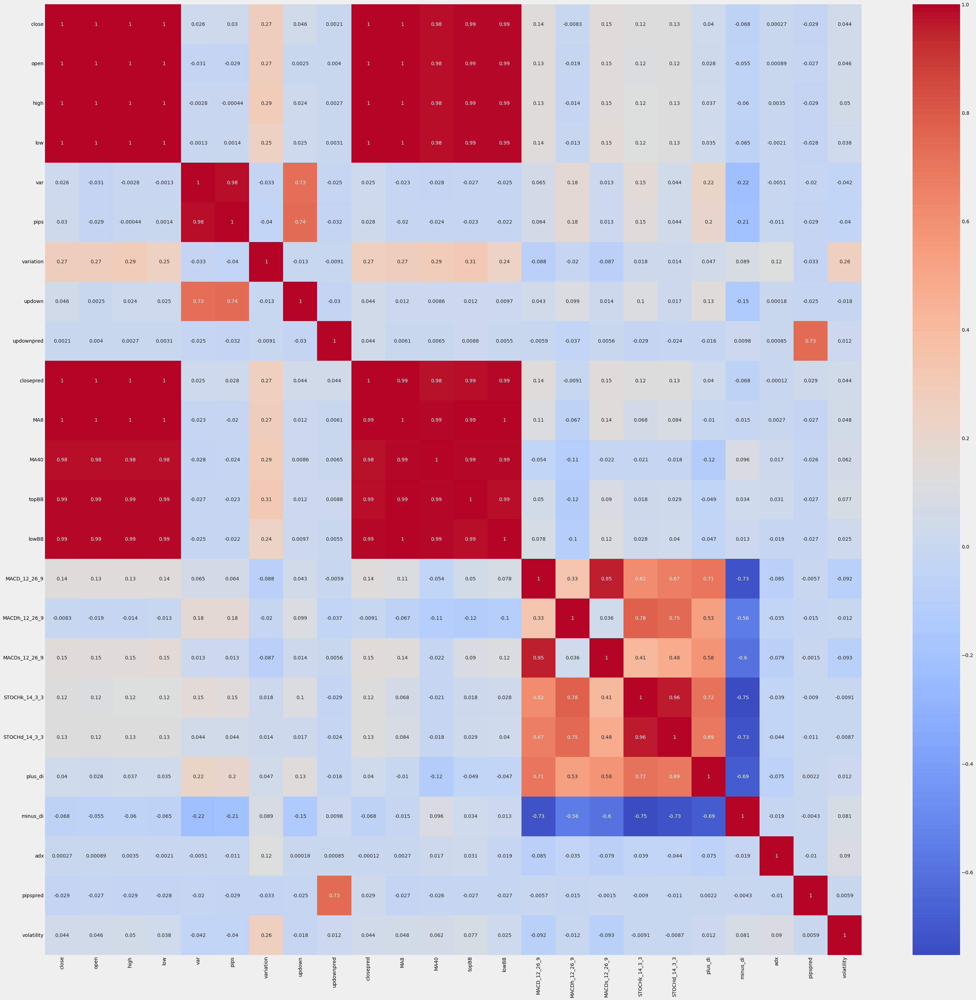

In [368]:
plt.figure(figsize=(46,46))
sns.heatmap(df.corr(),annot=True,cmap='coolwarm')

Probemos ahora a predecir los pips a ver que si mejora.

## 9. Predicción pips con GARCH

In [369]:
# Reparto de datos en train y test de close sin estandarizar
# ==============================================================================
from sklearn.model_selection import train_test_split

Xc_train, Xc_test, yc_train, yc_test = train_test_split(
                                        df.drop(['updownpred', 'closepred', 'pipspred'],axis=1), 
                                        df['pipspred'], 
                                        test_size=0.125,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [370]:
print("Partición de entrenamento")
print("-----------------------")
display(yc_train.describe())
display(Xc_train.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(yc_test.describe())
display(Xc_test.describe())

Partición de entrenamento
-----------------------


count    2915.000000
mean       -0.613379
std        68.320903
min      -343.000000
25%       -38.000000
50%         1.000000
75%        37.000000
max       325.000000
Name: pipspred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,volatility
count,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000
mean,1.226582,1.226642,1.231760,1.221506,-0.004957,-0.600000,102.544425,0.510806,1.226890,1.228362,1.246429,1.208004,-0.000637,-0.000002,-0.000636,48.420035,48.404618,20.913207,20.895442,23.040946,0.000030
std,0.115183,0.115245,0.115818,0.114329,0.546941,68.328172,54.371201,0.499969,0.115260,0.115753,0.118701,0.112966,0.007541,0.002229,0.007119,28.465760,27.660977,6.561173,6.626051,9.674255,0.000059
min,1.038700,1.038900,1.041900,1.034100,-2.620000,-343.000000,7.000000,0.000000,1.042863,1.055165,1.051756,1.028013,-0.028755,-0.008264,-0.024847,0.956122,2.553780,4.436544,4.128963,8.533306,0.000000
25%,1.121700,1.121800,1.126350,1.118100,-0.320000,-38.000000,65.000000,0.000000,1.122387,1.119984,1.139722,1.108672,-0.004734,-0.001305,-0.004572,21.724466,22.465893,16.097824,16.135717,15.790604,0.000002
50%,1.199300,1.199200,1.206000,1.194600,0.000000,1.000000,90.000000,1.000000,1.201037,1.201000,1.224404,1.181514,-0.000419,0.000024,-0.000364,46.982158,47.165156,20.556575,20.411127,20.606893,0.000009
75%,1.328000,1.328350,1.333900,1.321950,0.300000,37.000000,126.000000,1.000000,1.327075,1.327651,1.348243,1.303974,0.004140,0.001295,0.003920,75.381917,74.154596,25.233946,25.203499,27.999138,0.000032
max,1.514000,1.513200,1.514500,1.504200,3.070000,325.000000,523.000000,1.000000,1.503675,1.492110,1.525421,1.482627,0.026802,0.007576,0.024768,97.823224,97.082733,46.445948,46.624375,60.616949,0.000912


 
Partición de test
-----------------------


count    417.000000
mean      -6.417266
std       50.038096
min     -153.000000
25%      -33.000000
50%       -5.000000
75%       26.000000
max      172.000000
Name: pipspred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,volatility
count,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000
mean,1.143739,1.144379,1.147936,1.140243,-0.041894,-6.407674,76.928058,0.458034,1.145443,1.152749,1.161502,1.132763,-0.003073,-0.000120,-0.002953,41.359318,41.396371,17.538680,22.925396,23.072455,0.000020
std,0.060284,0.060113,0.059373,0.060932,0.447643,50.042210,33.839477,0.498834,0.059359,0.054143,0.055546,0.061886,0.004381,0.001632,0.004111,27.484827,26.699322,5.263098,6.235224,6.396587,0.000010
min,1.001600,1.001800,1.006500,0.995200,-1.490000,-153.000000,25.000000,0.000000,1.009012,1.028538,1.027128,0.986085,-0.014312,-0.004731,-0.011777,2.641847,4.088684,6.502440,9.568814,10.944818,0.000008
25%,1.102700,1.103600,1.107000,1.097000,-0.280000,-33.000000,53.000000,0.000000,1.102475,1.121885,1.129261,1.088337,-0.005958,-0.001174,-0.005847,15.937681,15.832141,13.502669,18.410790,17.630634,0.000014
50%,1.159400,1.159600,1.161700,1.156300,-0.030000,-5.000000,70.000000,0.000000,1.159800,1.170135,1.170783,1.152567,-0.003275,-0.000084,-0.003226,36.075949,35.366135,16.938561,22.187648,23.014825,0.000016
75%,1.191500,1.191800,1.194600,1.187700,0.240000,26.000000,92.000000,1.000000,1.192600,1.199168,1.210466,1.179258,-0.000115,0.001073,-0.000270,64.669739,64.556962,20.861255,27.763757,27.929590,0.000027
max,1.232500,1.232700,1.235000,1.226500,1.610000,172.000000,221.000000,1.000000,1.226300,1.217798,1.235974,1.214813,0.006988,0.004349,0.007419,94.698071,94.237700,31.276586,38.194580,38.147375,0.000046


In [371]:
escala = StandardScaler()
a = escala.fit_transform(df.drop(["updownpred", 'closepred', 'pipspred'],axis=1))
dfstd = pd.DataFrame(a, columns= df.drop(["updownpred",'closepred', 'pipspred'],axis=1).columns)
aux1 = pd.DataFrame(df['updownpred'])
aux1.reset_index(inplace=True)
aux2 = pd.DataFrame(df['closepred'])
aux2.reset_index(inplace=True)
aux3 = pd.DataFrame(df['pipspred'])
aux3.reset_index(inplace=True)
dfstd['updownpred']=aux1['updownpred']
dfstd['closepred']=aux2['closepred']
dfstd['pipspred']=aux3['pipspred']
dfstd.index = df.index
dfstd.describe()

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,volatility,updownpred,closepred,pipspred
count,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3.332000e+03,3332.000000,3332.000000,3332.000000
mean,5.124619e-17,-7.279758e-16,4.863390e-16,1.161003e-15,2.537319e-17,6.799783e-17,2.720246e-16,5.724379e-17,-1.830802e-15,1.679596e-15,-8.562578e-16,-4.712783e-16,8.008467e-17,1.809277e-17,-1.142877e-16,-1.708900e-16,1.606192e-16,3.965082e-18,-8.763165e-17,3.562951e-17,-7.285422e-17,0.504202,1.216080,-1.339736
std,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,1.000150e+00,0.500057,0.113144,66.330879
min,-1.896358e+00,-1.895795e+00,-1.887979e+00,-1.924124e+00,-4.874531e+00,-5.151274e+00,-1.744978e+00,-1.008439e+00,-1.836805e+00,-1.688534e+00,-1.796141e+00,-1.919321e+00,-3.828445e+00,-3.812427e+00,-3.488497e+00,-1.638263e+00,-1.627603e+00,-2.466875e+00,-2.574681e+00,-1.556175e+00,-5.220250e-01,0.000000,1.001600,-343.000000
25%,-8.404390e-01,-8.400788e-01,-8.427620e-01,-8.362519e-01,-5.796587e-01,-5.415997e-01,-6.867116e-01,-1.008439e+00,-8.374103e-01,-8.767266e-01,-8.404572e-01,-8.184211e-01,-5.541706e-01,-5.886569e-01,-5.670278e-01,-9.357778e-01,-9.317103e-01,-7.367239e-01,-7.085008e-01,-7.549728e-01,-4.724336e-01,0.000000,1.121075,-37.250000
50%,-2.775765e-01,-2.774280e-01,-2.898257e-01,-2.691696e-01,1.788876e-02,2.000411e-02,-2.331689e-01,9.916317e-01,-2.894014e-01,-2.882583e-01,-3.342877e-01,-2.410643e-01,2.070266e-02,1.515182e-02,2.310740e-02,-6.763816e-02,-5.523409e-02,-6.667562e-02,-8.299976e-02,-2.372530e-01,-3.061575e-01,1.000000,1.184750,0.000000
75%,8.777497e-01,8.772543e-01,8.813180e-01,8.710041e-01,5.594161e-01,5.627622e-01,4.471452e-01,9.916317e-01,8.841966e-01,8.762324e-01,8.928383e-01,8.740435e-01,6.201328e-01,5.819437e-01,6.172233e-01,9.459776e-01,9.225471e-01,6.690172e-01,6.557115e-01,5.308962e-01,4.064250e-02,1.000000,1.315500,36.000000
max,2.631283e+00,2.623084e+00,2.577707e+00,2.607193e+00,5.750610e+00,4.919903e+00,8.006191e+00,9.916317e-01,2.538090e+00,2.423426e+00,2.492907e+00,2.565443e+00,3.818940e+00,3.509459e+00,3.746914e+00,1.768626e+00,1.793406e+00,3.988198e+00,3.853564e+00,4.029104e+00,1.601656e+01,1.000000,1.514000,325.000000


In [372]:
# Reparto de datos en train y test de close estandarizado
# ==============================================================================
from sklearn.model_selection import train_test_split

Xc_train_std, Xc_test_std, yc_train_std, yc_test_std = train_test_split(
                                        dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1), 
                                        dfstd['pipspred'], 
                                        test_size=0.125,
                                        random_state = 43,
                                        shuffle      = False
                                    )

In [373]:
print("Partición de entrenamento")
print("-----------------------")
display(yc_train_std.describe())
display(Xc_train_std.describe())
print(" ")

print("Partición de test")
print("-----------------------")
display(yc_test_std.describe())
display(Xc_test_std.describe())

Partición de entrenamento
-----------------------


count    2915.000000
mean       -0.613379
std        68.320903
min      -343.000000
25%       -38.000000
50%         1.000000
75%        37.000000
max       325.000000
Name: pipspred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,volatility
count,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000,2915.000000
mean,0.091611,0.090971,0.092220,0.090537,0.008632,0.010958,0.060584,0.013209,0.090150,0.083937,0.091486,0.085049,0.041961,0.006857,0.042291,0.031079,0.031742,0.064893,-0.038430,-0.000423,0.022012
std,1.017769,1.018341,1.018125,1.017802,1.021323,1.030157,1.027486,0.999973,1.019382,1.026744,1.021720,1.020307,1.038011,1.030455,1.038193,1.001162,1.001053,1.008175,1.002317,1.037435,1.065312
min,-1.568537,-1.567968,-1.576787,-1.577821,-4.874531,-5.151274,-1.744978,-1.008439,-1.537429,-1.452344,-1.584162,-1.540630,-3.828445,-3.812427,-3.488497,-1.638263,-1.627603,-2.466875,-2.574681,-1.556175,-0.522025
25%,-0.835137,-0.835440,-0.834411,-0.830020,-0.579659,-0.552907,-0.648916,-1.008439,-0.834094,-0.877392,-0.826992,-0.812117,-0.521889,-0.595623,-0.531745,-0.907825,-0.906983,-0.675028,-0.758429,-0.777926,-0.486133
50%,-0.149452,-0.151511,-0.134230,-0.148987,0.017889,0.035081,-0.176476,0.991632,-0.138497,-0.158765,-0.098093,-0.154209,0.071969,0.018791,0.081964,-0.019493,-0.013115,0.010094,-0.111692,-0.261443,-0.353243
75%,0.987760,0.989696,0.990103,0.984732,0.578090,0.577839,0.503838,0.991632,0.976204,0.964651,0.967847,0.951851,0.699515,0.606177,0.706695,0.979348,0.963635,0.728808,0.613246,0.531277,0.062830
max,2.631283,2.623084,2.577707,2.607193,5.750610,4.919903,8.006191,0.991632,2.538090,2.423426,2.492907,2.565443,3.818940,3.509459,3.746914,1.768626,1.793406,3.988198,3.853564,4.029104,16.016557


 
Partición de test
-----------------------


count    417.000000
mean      -6.417266
std       50.038096
min     -153.000000
25%      -33.000000
50%       -5.000000
75%       26.000000
max      172.000000
Name: pipspred, dtype: float64

,close,open,high,low,var,pips,variation,updown,MA8,MA40,topBB,lowBB,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,STOCHk_14_3_3,STOCHd_14_3_3,plus_di,minus_di,adx,volatility
count,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000,417.000000
mean,-0.640401,-0.635922,-0.644653,-0.632891,-0.060342,-0.076602,-0.423505,-0.092339,-0.630187,-0.586757,-0.639526,-0.594527,-0.293322,-0.047931,-0.295632,-0.217252,-0.221887,-0.453629,0.268640,0.002956,-0.153876
std,0.532676,0.531178,0.521931,0.542442,0.835900,0.754467,0.639485,0.997704,0.524986,0.480256,0.478110,0.558949,0.602980,0.754331,0.599484,0.966662,0.966250,0.808716,0.943197,0.685949,0.181117
min,-1.896358,-1.895795,-1.887979,-1.924124,-2.764442,-2.286718,-1.404821,-1.008439,-1.836805,-1.688534,-1.796141,-1.919321,-1.840333,-2.179152,-1.582471,-1.578975,-1.572055,-2.149434,-1.751799,-1.297572,-0.382119
25%,-1.003024,-0.996260,-1.004511,-1.017861,-0.504965,-0.477524,-0.875688,-1.008439,-1.010204,-0.860527,-0.917031,-0.995784,-0.690420,-0.535226,-0.717614,-1.111350,-1.147059,-1.073794,-0.414281,-0.580607,-0.263078
50%,-0.502015,-0.501428,-0.523659,-0.489949,-0.038131,-0.055379,-0.554428,-1.008439,-0.503210,-0.432542,-0.559639,-0.415656,-0.321167,-0.031294,-0.335456,-0.403072,-0.440122,-0.545842,0.157041,-0.003224,-0.223180
75%,-0.218374,-0.216899,-0.234444,-0.210414,0.466049,0.411996,-0.138681,0.991632,-0.213120,-0.175020,-0.218068,-0.174588,0.113919,0.503556,0.095685,0.602593,0.616296,0.056910,1.000534,0.523819,-0.025069
max,0.143908,0.144505,0.120701,0.134999,3.024299,2.613181,2.299111,0.991632,0.084929,-0.009769,0.001496,0.146546,1.091584,2.017857,1.216931,1.658712,1.690444,1.657307,2.578396,1.619541,0.306659


### 7.1 Regresión lineal

##### Dataset sin estandarizar

In [374]:
# Creamos un nuevo objeto de Regresión Lineal
regr = LinearRegression()
regr.fit(Xc_train, yc_train)

# Los coeficientes
print('Coefficients: \n', regr.coef_)


Coefficients: 
 [ 5.37626755e+02  5.37626783e+02 -8.77434217e+02 -8.77434212e+02
  3.22917874e+01 -2.81245544e-01 -4.84002401e-02 -3.23626473e+00
  1.53419649e+01  5.66651058e+02  7.88912259e+01  2.21858335e+00
  1.03317572e+03  7.88922120e+02  2.44253602e+02  2.44792389e-01
 -3.21756716e-01  3.89954582e-01 -6.04426098e-01 -1.77810105e-01
  1.27324345e+04]


In [375]:
# Accuracy del modelo en train
predicciones = regr.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[-11.56067647   4.126836   -12.20420055 ...  -1.63557175  -1.28941527
   3.28528299]
Mean Absolute Error 49.96244504291404
Mean squared error: 4624.707582901307
Root Mean squared error: 68.00520261642713
Variance score: 0.01
Acertamos exactamente el 0.72 % de las predicciones.
Acertamos con un margen de 5 pips el 6.861 % de las predicciones.
Acertamos con un margen de 10 pips el 14.34 % de las predicciones.
Acertamos con un margen de 25 pips el 35.403 % de las predicciones.
Acertamos con un margen de 50 pips el 61.201 % de las predicciones.


In [376]:
# Accuracy de test del modelo en test
y_pred = regr.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 39.1050390145923
Mean squared error: 2575.2105154601563
Root Mean squared error: 50.74653205353206
Variance score: -0.03
Acertamos exactamente el 0.48 % de las predicciones.
Acertamos con un margen de 5 pips el 8.153 % de las predicciones.
Acertamos con un margen de 10 pips el 17.746 % de las predicciones.
Acertamos con un margen de 25 pips el 40.767 % de las predicciones.
Acertamos con un margen de 50 pips el 69.784 % de las predicciones.


In [377]:
y_pred = regr.predict(df.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspredv = pd.DataFrame()
pipspredv.index = df.index
pipspredv['real'] = df['pipspred']
pipspredv['log'] = y_pred
pipspredv

,real,log
date,,
2009-11-02,-57.0,-11.560676
2009-11-03,147.0,4.126836
2009-11-04,10.0,-12.204201
2009-11-05,-20.0,-3.179831
2009-11-06,110.0,-2.803198
...,...,...
2022-08-03,81.0,0.823711
2022-08-04,-66.0,-1.038960
2022-08-05,16.0,0.794530


In [378]:
metricas(pipspredv['real'], pipspredv['log'])

Mean Absolute Error 48.60364002676454
Mean squared error: 4368.212901892015
Root Mean squared error: 66.09245722389215
Variance score: 0.01
Acertamos exactamente el 0.69 % de las predicciones.
Acertamos con un margen de 5 pips el 7.023 % de las predicciones.
Acertamos con un margen de 10 pips el 14.766 % de las predicciones.
Acertamos con un margen de 25 pips el 36.074 % de las predicciones.
Acertamos con un margen de 50 pips el 62.275 % de las predicciones.


##### Dataset estandarizado

In [379]:
# Creamos un nuevo objeto de Regresión Lineal
regr = LinearRegression()
regr.fit(Xc_train_std, yc_train_std)

# Los coeficientes
print('Coefficients: \n', regr.coef_)


Coefficients: 
 [ 60.29731706  61.38974529 -98.6154211  -99.74487341  17.29297294
 -18.62238344  -2.61692311  -1.61807523   1.73469174  63.88287509
   9.16542802   0.24563632   4.76964838   2.5214817    4.25761678
   6.96011211  -8.89074585   2.53781159  -3.99569991  -1.65810839
   0.70239485]


In [380]:
# Accuracy del modelo en train
predicciones = regr.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[-11.56067647   4.126836   -12.20420055 ...  -1.63557175  -1.28941527
   3.28528299]
Mean Absolute Error 49.96244504291404
Mean squared error: 4624.707582901307
Root Mean squared error: 68.00520261642713
Variance score: 0.01
Acertamos exactamente el 0.72 % de las predicciones.
Acertamos con un margen de 5 pips el 6.861 % de las predicciones.
Acertamos con un margen de 10 pips el 14.34 % de las predicciones.
Acertamos con un margen de 25 pips el 35.403 % de las predicciones.
Acertamos con un margen de 50 pips el 61.201 % de las predicciones.


In [381]:
# Accuracy de test del modelo en test
y_pred = regr.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 39.105039014592265
Mean squared error: 2575.2105154601372
Root Mean squared error: 50.746532053531865
Variance score: -0.03
Acertamos exactamente el 0.48 % de las predicciones.
Acertamos con un margen de 5 pips el 8.153 % de las predicciones.
Acertamos con un margen de 10 pips el 17.746 % de las predicciones.
Acertamos con un margen de 25 pips el 40.767 % de las predicciones.
Acertamos con un margen de 50 pips el 69.784 % de las predicciones.


In [382]:
y_pred = regr.predict(dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspredv['log_std'] = y_pred
pipspredv

,real,log,log_std
date,,,
2009-11-02,-57.0,-11.560676,-11.560676
2009-11-03,147.0,4.126836,4.126836
2009-11-04,10.0,-12.204201,-12.204201
2009-11-05,-20.0,-3.179831,-3.179831
2009-11-06,110.0,-2.803198,-2.803198
...,...,...,...
2022-08-03,81.0,0.823711,0.823711
2022-08-04,-66.0,-1.038960,-1.038960
2022-08-05,16.0,0.794530,0.794530


Observemos que nos ha salido el mismo modelo, por lo que no vamos a considerarlo en nuestro análisis.

In [383]:
pipspredv=pipspredv.drop('log_std',axis=1)

### 5.2 Adaptative boosting

##### Dataset sin estandarizar

In [384]:
# Creamos un nuevo objeto de Regresión Lineal
lr = LinearRegression()
ada_model = AdaBoostRegressor(n_estimators=1000, base_estimator=lr, learning_rate=0.01, random_state=0)
ada_model.fit(Xc_train,yc_train)

AdaBoostRegressor(base_estimator=LinearRegression(), learning_rate=0.01,
                  n_estimators=1000, random_state=0)

In [385]:
# Accuracy del modelo en train
predicciones = ada_model.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[-36.93701532 -18.88856004 -34.06877205 ...  -7.41435204  -3.71099692
   3.58163651]
Mean Absolute Error 50.610827393197205
Mean squared error: 4690.015653243861
Root Mean squared error: 68.48368895761867
Variance score: -0.01
Acertamos exactamente el 0.892 % de las predicciones.
Acertamos con un margen de 5 pips el 6.621 % de las predicciones.
Acertamos con un margen de 10 pips el 15.06 % de las predicciones.
Acertamos con un margen de 25 pips el 34.889 % de las predicciones.
Acertamos con un margen de 50 pips el 60.686 % de las predicciones.


In [386]:
# Accuracy de test del modelo en test
y_pred = ada_model.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 39.84027109776818
Mean squared error: 2678.1896913572027
Root Mean squared error: 51.751228887411
Variance score: -0.07
Acertamos exactamente el 0.959 % de las predicciones.
Acertamos con un margen de 5 pips el 7.674 % de las predicciones.
Acertamos con un margen de 10 pips el 17.506 % de las predicciones.
Acertamos con un margen de 25 pips el 40.528 % de las predicciones.
Acertamos con un margen de 50 pips el 69.065 % de las predicciones.


In [387]:
y_pred = ada_model.predict(df.drop(['updownpred', 'closepred','pipspred'],axis=1))
pipspredv['adap'] = y_pred
pipspredv

,real,log,adap
date,,,
2009-11-02,-57.0,-11.560676,-36.937015
2009-11-03,147.0,4.126836,-18.888560
2009-11-04,10.0,-12.204201,-34.068772
2009-11-05,-20.0,-3.179831,-28.591094
2009-11-06,110.0,-2.803198,-18.346398
...,...,...,...
2022-08-03,81.0,0.823711,13.332835
2022-08-04,-66.0,-1.038960,11.163837
2022-08-05,16.0,0.794530,11.258718


In [388]:
metricas(pipspredv['real'], pipspredv['adap'])

Mean Absolute Error 49.2628916263323
Mean squared error: 4438.235513355885
Root Mean squared error: 66.62008340850291
Variance score: -0.01
Acertamos exactamente el 0.9 % de las predicciones.
Acertamos con un margen de 5 pips el 6.753 % de las predicciones.
Acertamos con un margen de 10 pips el 15.366 % de las predicciones.
Acertamos con un margen de 25 pips el 35.594 % de las predicciones.
Acertamos con un margen de 50 pips el 61.735 % de las predicciones.


##### Dataset estandarizado

In [389]:
# Creamos un nuevo objeto de Regresión Lineal
lr = LinearRegression()
ada_model = AdaBoostRegressor(n_estimators=1000, base_estimator=lr, learning_rate=0.01, random_state=0)
ada_model.fit(Xc_train_std,yc_train_std)

AdaBoostRegressor(base_estimator=LinearRegression(), learning_rate=0.01,
                  n_estimators=1000, random_state=0)

In [390]:
# Accuracy del modelo en train
predicciones = ada_model.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[-37.45573042 -19.14496073 -35.38050422 ...  -7.70901621  -3.77675982
   3.69721159]
Mean Absolute Error 50.65013375604894
Mean squared error: 4693.835927174328
Root Mean squared error: 68.51157513277832
Variance score: -0.01
Acertamos exactamente el 0.549 % de las predicciones.
Acertamos con un margen de 5 pips el 6.792 % de las predicciones.
Acertamos con un margen de 10 pips el 14.889 % de las predicciones.
Acertamos con un margen de 25 pips el 34.751 % de las predicciones.
Acertamos con un margen de 50 pips el 60.583 % de las predicciones.


In [391]:
# Accuracy de test del modelo en test
y_pred = ada_model.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 39.89424965668721
Mean squared error: 2685.3761040179215
Root Mean squared error: 51.820614662679574
Variance score: -0.08
Acertamos exactamente el 0.959 % de las predicciones.
Acertamos con un margen de 5 pips el 7.914 % de las predicciones.
Acertamos con un margen de 10 pips el 17.506 % de las predicciones.
Acertamos con un margen de 25 pips el 40.288 % de las predicciones.
Acertamos con un margen de 50 pips el 69.065 % de las predicciones.


In [392]:
y_pred = ada_model.predict(dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspredv['adap_std'] = y_pred
pipspredv

,real,log,adap,adap_std
date,,,,
2009-11-02,-57.0,-11.560676,-36.937015,-37.455730
2009-11-03,147.0,4.126836,-18.888560,-19.144961
2009-11-04,10.0,-12.204201,-34.068772,-35.380504
2009-11-05,-20.0,-3.179831,-28.591094,-29.693599
2009-11-06,110.0,-2.803198,-18.346398,-19.106229
...,...,...,...,...
2022-08-03,81.0,0.823711,13.332835,14.174144
2022-08-04,-66.0,-1.038960,11.163837,11.501888
2022-08-05,16.0,0.794530,11.258718,11.860497


In [393]:
metricas(pipspredv['real'], pipspredv['adap_std'])

Mean Absolute Error 49.304034215402524
Mean squared error: 4442.477059750492
Root Mean squared error: 66.65190964819007
Variance score: -0.01
Acertamos exactamente el 0.6 % de las predicciones.
Acertamos con un margen de 5 pips el 6.933 % de las predicciones.
Acertamos con un margen de 10 pips el 15.216 % de las predicciones.
Acertamos con un margen de 25 pips el 35.444 % de las predicciones.
Acertamos con un margen de 50 pips el 61.645 % de las predicciones.


Observamos que tienen resultados parecidos, pero los resultados del dataset sin estandarizar son un poco mejores, nos quedaremos con ese.

In [394]:
pipspredv = pipspredv.drop('adap_std', axis = 1)

### 5.3 Random Forest

##### Dataset sin estandarizar

In [395]:
model = RandomForestRegressor(n_jobs=-1, random_state=0)
model.fit (Xc_train, yc_train)
print ('Number of Trees used in the model : ', model.n_estimators)

Number of Trees used in the model :  100


In [396]:
# Accuracy del modelo en train
predicciones = model.predict(Xc_train)
print(predicciones)
metricas(yc_train, predicciones)

[-26.69  97.57   1.89 ... -50.52   3.9   19.  ]
Mean Absolute Error 19.099766723842194
Mean squared error: 678.163116981132
Root Mean squared error: 26.041565179173315
Variance score: 0.85
Acertamos exactamente el 1.955 % de las predicciones.
Acertamos con un margen de 5 pips el 18.834 % de las predicciones.
Acertamos con un margen de 10 pips el 36.81 % de las predicciones.
Acertamos con un margen de 25 pips el 71.767 % de las predicciones.
Acertamos con un margen de 50 pips el 93.242 % de las predicciones.


In [397]:
# Accuracy de test del modelo en test
y_pred = model.predict(Xc_test)
metricas(yc_test, y_pred)

Mean Absolute Error 40.80916067146283
Mean squared error: 2874.425326139083
Root Mean squared error: 53.61366734461543
Variance score: -0.15
Acertamos exactamente el 1.199 % de las predicciones.
Acertamos con un margen de 5 pips el 9.592 % de las predicciones.
Acertamos con un margen de 10 pips el 17.266 % de las predicciones.
Acertamos con un margen de 25 pips el 39.568 % de las predicciones.
Acertamos con un margen de 50 pips el 66.906 % de las predicciones.


In [398]:
y_pred = model.predict(df.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspredv['rand'] = y_pred
pipspredv

,real,log,adap,rand
date,,,,
2009-11-02,-57.0,-11.560676,-36.937015,-26.69
2009-11-03,147.0,4.126836,-18.888560,97.57
2009-11-04,10.0,-12.204201,-34.068772,1.89
2009-11-05,-20.0,-3.179831,-28.591094,-14.96
2009-11-06,110.0,-2.803198,-18.346398,54.13
...,...,...,...,...
2022-08-03,81.0,0.823711,13.332835,42.97
2022-08-04,-66.0,-1.038960,11.163837,44.76
2022-08-05,16.0,0.794530,11.258718,41.03


In [399]:
metricas(pipspredv['real'], pipspredv['rand'])

Mean Absolute Error 21.816698679471784
Mean squared error: 953.0254642857135
Root Mean squared error: 30.871110512673713
Variance score: 0.78
Acertamos exactamente el 1.861 % de las predicciones.
Acertamos con un margen de 5 pips el 17.677 % de las predicciones.
Acertamos con un margen de 10 pips el 34.364 % de las predicciones.
Acertamos con un margen de 25 pips el 67.737 % de las predicciones.
Acertamos con un margen de 50 pips el 89.946 % de las predicciones.


##### Dataset estandarizado

In [400]:
model = RandomForestRegressor(n_jobs=-1, random_state=0)
model.fit (Xc_train_std, yc_train_std)
print ('Number of Trees used in the model : ', model.n_estimators)

Number of Trees used in the model :  100


In [401]:
# Accuracy del modelo en train
predicciones = model.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[-29.02 101.18   0.44 ... -50.05   3.09  14.14]
Mean Absolute Error 19.128627787307035
Mean squared error: 679.5876341337907
Root Mean squared error: 26.068901667193245
Variance score: 0.85
Acertamos exactamente el 2.196 % de las predicciones.
Acertamos con un margen de 5 pips el 18.388 % de las predicciones.
Acertamos con un margen de 10 pips el 36.569 % de las predicciones.
Acertamos con un margen de 25 pips el 72.178 % de las predicciones.
Acertamos con un margen de 50 pips el 93.105 % de las predicciones.


In [402]:
# Accuracy de test del modelo en test
y_pred = model.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 40.731894484412464
Mean squared error: 2865.8888839328492
Root Mean squared error: 53.533997458931175
Variance score: -0.15
Acertamos exactamente el 1.199 % de las predicciones.
Acertamos con un margen de 5 pips el 8.873 % de las predicciones.
Acertamos con un margen de 10 pips el 18.705 % de las predicciones.
Acertamos con un margen de 25 pips el 40.288 % de las predicciones.
Acertamos con un margen de 50 pips el 67.386 % de las predicciones.


In [403]:
y_pred = model.predict(dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspredv['rand_std'] = y_pred
pipspredv

,real,log,adap,rand,rand_std
date,,,,,
2009-11-02,-57.0,-11.560676,-36.937015,-26.69,-29.02
2009-11-03,147.0,4.126836,-18.888560,97.57,101.18
2009-11-04,10.0,-12.204201,-34.068772,1.89,0.44
2009-11-05,-20.0,-3.179831,-28.591094,-14.96,-14.96
2009-11-06,110.0,-2.803198,-18.346398,54.13,59.05
...,...,...,...,...,...
2022-08-03,81.0,0.823711,13.332835,42.97,45.08
2022-08-04,-66.0,-1.038960,11.163837,44.76,45.81
2022-08-05,16.0,0.794530,11.258718,41.03,43.91


In [404]:
metricas(pipspredv['real'], pipspredv['rand_std'])

Mean Absolute Error 21.832277911164464
Mean squared error: 953.2033667767101
Root Mean squared error: 30.873991753200787
Variance score: 0.78
Acertamos exactamente el 2.071 % de las predicciones.
Acertamos con un margen de 5 pips el 17.197 % de las predicciones.
Acertamos con un margen de 10 pips el 34.334 % de las predicciones.
Acertamos con un margen de 25 pips el 68.187 % de las predicciones.
Acertamos con un margen de 50 pips el 89.886 % de las predicciones.


Observamos que tienen resultados parecidos, pero los resultados del dataset estandarizado son un poco mejores, nos quedaremos con ese.

In [405]:
pipspredv = pipspredv.drop('rand', axis = 1)

### 6.4 Red neuronal

In [406]:
# Espacio de búsqueda de cada hiperparámetro
# ==============================================================================
param_distributions = {
    'modelo__hidden_layer_sizes': [(100, 150), (100,150,200), (100,200,300,400)],
    'modelo__alpha': np.logspace(-3, 2, 10),
    'modelo__learning_rate_init': [0.001, 0.01],
}

# Pipeline que definirá el modelo
# ==============================================================================
pipe = Pipeline([('modelo', MLPRegressor(solver = 'adam', activation = 'identity', learning_rate = 'adaptive', max_iter= 200, random_state=0))])

# Búsqueda por validación cruzada
# ==============================================================================
grid = RandomizedSearchCV(
        estimator  = pipe,
        param_distributions = param_distributions,
        n_iter     = 50,
        scoring    = 'neg_mean_squared_error',
        n_jobs     = multiprocessing.cpu_count() - 1,
        cv         = 5, 
        verbose    = 0,
        random_state = 43,
        return_train_score = True
       )

grid.fit(X = Xc_train_std, y = yc_train_std)

# Resultados del grid
# ==============================================================================
resultados = pd.DataFrame(grid.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False)\
    .head(10)

,param_modelo__learning_rate_init,param_modelo__hidden_layer_sizes,param_modelo__alpha,mean_test_score,std_test_score,mean_train_score,std_train_score
9,0.01,"(100, 200, 300, 400)",0.001,-4666.702112,2814.417282,-4657.058673,705.634013
38,0.01,"(100, 200, 300, 400)",100.0,-4668.265104,2819.555771,-4648.095666,709.305364
24,0.01,"(100, 200, 300, 400)",0.16681,-4669.678548,2819.630234,-4656.873297,698.333648
27,0.01,"(100, 150, 200)",2.154435,-4670.663042,2806.391830,-4645.966436,704.163324
48,0.01,"(100, 200, 300, 400)",0.046416,-4674.258201,2806.357675,-4657.780047,709.407723
15,0.01,"(100, 200, 300, 400)",27.825594,-4674.295750,2818.206681,-4645.054861,703.412803
30,0.01,"(100, 150)",100.0,-4674.911439,2813.919085,-4640.990513,703.348913
45,0.01,"(100, 200, 300, 400)",0.003594,-4675.001602,2806.276685,-4667.621610,719.404525
23,0.01,"(100, 150, 200)",0.012915,-4680.846298,2819.407492,-4646.584736,703.426579
32,0.01,"(100, 150, 200)",0.003594,-4680.990434,2819.409041,-4646.046306,703.176495


In [407]:
neural_final = grid.best_estimator_
neural_final['modelo'].get_params()

{'activation': 'identity',
 'alpha': 0.001,
 'batch_size': 'auto',
 'beta_1': 0.9,
 'beta_2': 0.999,
 'early_stopping': False,
 'epsilon': 1e-08,
 'hidden_layer_sizes': (100, 200, 300, 400),
 'learning_rate': 'adaptive',
 'learning_rate_init': 0.01,
 'max_fun': 15000,
 'max_iter': 200,
 'momentum': 0.9,
 'n_iter_no_change': 10,
 'nesterovs_momentum': True,
 'power_t': 0.5,
 'random_state': 0,
 'shuffle': True,
 'solver': 'adam',
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': False,
 'warm_start': False}

In [408]:
# Accuracy del modelo en train
predicciones = neural_final.predict(Xc_train_std)
print(predicciones)
metricas(yc_train_std, predicciones)

[-1.31979606 -0.89590617 -1.8491987  ...  0.22137309  0.46578102
  0.57766444]
Mean Absolute Error 50.12519835923295
Mean squared error: 4660.851278295121
Root Mean squared error: 68.27042755318821
Variance score: 0.00
Acertamos exactamente el 0.72 % de las predicciones.
Acertamos con un margen de 5 pips el 6.998 % de las predicciones.
Acertamos con un margen de 10 pips el 14.786 % de las predicciones.
Acertamos con un margen de 25 pips el 35.54 % de las predicciones.
Acertamos con un margen de 50 pips el 61.612 % de las predicciones.


In [409]:
# Accuracy de test del modelo en test
y_pred = neural_final.predict(Xc_test_std)
metricas(yc_test_std, y_pred)

Mean Absolute Error 38.889994340877024
Mean squared error: 2542.0591646630824
Root Mean squared error: 50.41883739896312
Variance score: -0.02
Acertamos exactamente el 0.719 % de las predicciones.
Acertamos con un margen de 5 pips el 9.113 % de las predicciones.
Acertamos con un margen de 10 pips el 16.547 % de las predicciones.
Acertamos con un margen de 25 pips el 41.247 % de las predicciones.
Acertamos con un margen de 50 pips el 68.825 % de las predicciones.


In [410]:
y_pred = neural_final.predict(dfstd.drop(['updownpred', 'closepred', 'pipspred'],axis=1))
pipspredv['neur'] = y_pred
pipspredv

,real,log,adap,rand_std,neur
date,,,,,
2009-11-02,-57.0,-11.560676,-36.937015,-29.02,-1.319796
2009-11-03,147.0,4.126836,-18.888560,101.18,-0.895906
2009-11-04,10.0,-12.204201,-34.068772,0.44,-1.849199
2009-11-05,-20.0,-3.179831,-28.591094,-14.96,-0.878083
2009-11-06,110.0,-2.803198,-18.346398,59.05,-0.674133
...,...,...,...,...,...
2022-08-03,81.0,0.823711,13.332835,45.08,0.113522
2022-08-04,-66.0,-1.038960,11.163837,45.81,-0.216608
2022-08-05,16.0,0.794530,11.258718,43.91,0.411109


In [411]:
metricas(pipspredv['real'], pipspredv['neur'])

Mean Absolute Error 48.7191119019537
Mean squared error: 4395.684318095674
Root Mean squared error: 66.29995715002894
Variance score: 0.00
Acertamos exactamente el 0.72 % de las predicciones.
Acertamos con un margen de 5 pips el 7.263 % de las predicciones.
Acertamos con un margen de 10 pips el 15.006 % de las predicciones.
Acertamos con un margen de 25 pips el 36.255 % de las predicciones.
Acertamos con un margen de 50 pips el 62.515 % de las predicciones.


## 10. Desarrollo del algoritmo de inversión

### 10.1 Pips con alto riesgo

In [412]:
pipspred['close']=df['close']
pipspred

,real,log,adap,rand_std,neur,close
date,,,,,,
2009-11-02,-57.0,-12.099413,-35.545174,-25.70,-2.207966,1.4769
2009-11-03,147.0,4.372881,-20.080623,95.74,-0.282412,1.4715
2009-11-04,10.0,-12.004921,-34.446334,4.03,-3.586680,1.4878
2009-11-05,-20.0,-4.173512,-27.684022,-8.36,-0.671060,1.4881
2009-11-06,110.0,-2.680121,-19.589078,64.90,0.926440,1.4849
...,...,...,...,...,...,...
2022-08-03,81.0,0.640999,14.251208,38.36,0.816834,1.0164
2022-08-04,-66.0,-1.322604,11.786955,43.19,-0.943163,1.0243
2022-08-05,16.0,0.629437,11.183961,40.68,1.119773,1.0181


In [413]:
def implement_strategy3(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if (log[i] > 0 and rand[i] > 0 and adap[i] > 0) or (log[i] > 0 and rand[i] > 0 and neural[i] > 0) or (neural[i] > 0 and rand[i] > 0 and adap[i] > 0) or (log[i] > 0 and neural[i] > 0 and adap[i] > 0):
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif (log[i] < 0 and rand[i] < 0 and adap[i] < 0) or (log[i] < 0 and rand[i] < 0 and neural[i] < 0) or (neural[i] < 0 and rand[i] < 0 and adap[i] < 0) or (log[i] < 0 and neural[i] < 0 and adap[i] < 0):
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy3(pipspred['close'], pipspred['log'], pipspred['adap'], pipspred['rand_std'], pipspred['neur'])

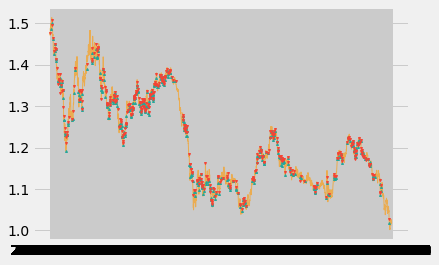

In [414]:
plt.figure()
plt.plot(pipspred.index, pipspred['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(pipspred.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(pipspred.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [415]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(pipspred['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
        
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(pipspred.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(pipspred.index)

frames = [pipspred['close'], pipspred['log'], pipspred['adap'], pipspred['rand_std'], pipspred['neur'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand_std,neur,algor_signal,algor_position
date,,,,,,,
2009-11-02,1.4769,-12.099413,-35.545174,-25.70,-2.207966,-1,0
2009-11-03,1.4715,4.372881,-20.080623,95.74,-0.282412,0,0
2009-11-04,1.4878,-12.004921,-34.446334,4.03,-3.586680,0,0
2009-11-05,1.4881,-4.173512,-27.684022,-8.36,-0.671060,0,0
2009-11-06,1.4849,-2.680121,-19.589078,64.90,0.926440,0,0
...,...,...,...,...,...,...,...
2022-08-03,1.0164,0.640999,14.251208,38.36,0.816834,0,1
2022-08-04,1.0243,-1.322604,11.786955,43.19,-0.943163,0,1
2022-08-05,1.0181,0.629437,11.183961,40.68,1.119773,0,1


In [416]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(pipspred['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/pipspred['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 3 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : 141180.21
Profit percentage of the algoritmic 3 strategy : 141%


In [431]:
pipspredv['close']=df['close']
pipspred2 = pipspred.loc['2021-01-01':]
pipspred2

,real,log,adap,rand_std,neur,close
date,,,,,,
2021-01-01,17.0,3.085376,3.832376,18.32,2.658372,1.2212
2021-01-04,47.0,-1.768440,-0.915057,-1.86,0.506907,1.2248
2021-01-05,29.0,0.504191,-4.297257,-29.27,0.534003,1.2294
2021-01-06,-57.0,3.351295,-3.697479,-7.99,0.332983,1.2325
2021-01-07,-55.0,3.410137,-0.233550,-9.67,1.633942,1.2270
...,...,...,...,...,...,...
2022-08-03,81.0,0.640999,14.251208,38.36,0.816834,1.0164
2022-08-04,-66.0,-1.322604,11.786955,43.19,-0.943163,1.0243
2022-08-05,16.0,0.629437,11.183961,40.68,1.119773,1.0181


In [432]:
pipspred['close']=df['close']
pipspred

,real,log,adap,rand_std,neur,close
date,,,,,,
2009-11-02,-57.0,-12.099413,-35.545174,-25.70,-2.207966,1.4769
2009-11-03,147.0,4.372881,-20.080623,95.74,-0.282412,1.4715
2009-11-04,10.0,-12.004921,-34.446334,4.03,-3.586680,1.4878
2009-11-05,-20.0,-4.173512,-27.684022,-8.36,-0.671060,1.4881
2009-11-06,110.0,-2.680121,-19.589078,64.90,0.926440,1.4849
...,...,...,...,...,...,...
2022-08-03,81.0,0.640999,14.251208,38.36,0.816834,1.0164
2022-08-04,-66.0,-1.322604,11.786955,43.19,-0.943163,1.0243
2022-08-05,16.0,0.629437,11.183961,40.68,1.119773,1.0181


In [433]:
def implement_strategy3(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if (log[i] > 0 and rand[i] > 0 and adap[i] > 0) or (log[i] > 0 and rand[i] > 0 and neural[i] > 0) or (neural[i] > 0 and rand[i] > 0 and adap[i] > 0) or (log[i] > 0 and neural[i] > 0 and adap[i] > 0):
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif (log[i] < 0 and rand[i] < 0 and adap[i] < 0) or (log[i] < 0 and rand[i] < 0 and neural[i] < 0) or (neural[i] < 0 and rand[i] < 0 and adap[i] < 0) or (log[i] < 0 and neural[i] < 0 and adap[i] < 0):
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy3(pipspred2['close'], pipspred2['log'], pipspred2['adap'], pipspred2['rand_std'], pipspred2['neur'])

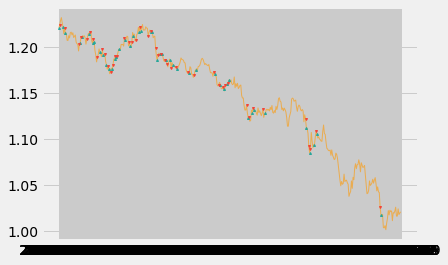

In [434]:
plt.figure()
plt.plot(pipspred2.index, pipspred2['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(pipspred2.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(pipspred2.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [435]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(pipspred2['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
        
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(pipspred2.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(pipspred2.index)

frames = [pipspred2['close'], pipspred2['log'], pipspred2['adap'], pipspred2['rand_std'], pipspred2['neur'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand_std,neur,algor_signal,algor_position
date,,,,,,,
2021-01-01,1.2212,3.085376,3.832376,18.32,2.658372,1,1
2021-01-04,1.2248,-1.768440,-0.915057,-1.86,0.506907,-1,0
2021-01-05,1.2294,0.504191,-4.297257,-29.27,0.534003,0,0
2021-01-06,1.2325,3.351295,-3.697479,-7.99,0.332983,0,0
2021-01-07,1.2270,3.410137,-0.233550,-9.67,1.633942,0,0
...,...,...,...,...,...,...,...
2022-08-03,1.0164,0.640999,14.251208,38.36,0.816834,0,1
2022-08-04,1.0243,-1.322604,11.786955,43.19,-0.943163,0,1
2022-08-05,1.0181,0.629437,11.183961,40.68,1.119773,0,1


In [436]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(pipspred2['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/pipspred2['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 3 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : -14601.81
Profit percentage of the algoritmic 3 strategy : -15%


### 5.2 Binario con bajo riesgo

In [437]:
pipspred

,real,log,adap,rand_std,neur,close
date,,,,,,
2009-11-02,-57.0,-12.099413,-35.545174,-25.70,-2.207966,1.4769
2009-11-03,147.0,4.372881,-20.080623,95.74,-0.282412,1.4715
2009-11-04,10.0,-12.004921,-34.446334,4.03,-3.586680,1.4878
2009-11-05,-20.0,-4.173512,-27.684022,-8.36,-0.671060,1.4881
2009-11-06,110.0,-2.680121,-19.589078,64.90,0.926440,1.4849
...,...,...,...,...,...,...
2022-08-03,81.0,0.640999,14.251208,38.36,0.816834,1.0164
2022-08-04,-66.0,-1.322604,11.786955,43.19,-0.943163,1.0243
2022-08-05,16.0,0.629437,11.183961,40.68,1.119773,1.0181


In [438]:
def implement_strategy4(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if log[i] > 0 and rand[i] > 0 and adap[i] > 0 and neural[i] > 0:
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif log[i] < 0 and rand[i] < 0 and adap[i] < 0 and neural[i] < 0:
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy4(pipspred['close'], pipspred['log'], pipspred['adap'], pipspred['rand_std'], pipspred['neur'])

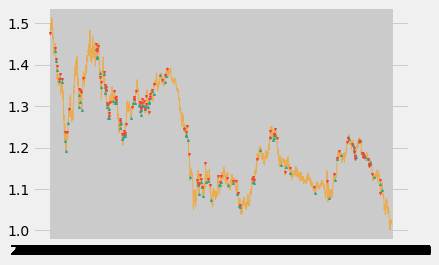

In [439]:
plt.figure()
plt.plot(pipspred.index, pipspred['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(pipspred.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(pipspred.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [440]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(pipspred['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(pipspred.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(pipspred.index)

frames = [pipspred['close'], pipspred['log'], pipspred['adap'], pipspred['rand_std'], pipspred['neur'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand_std,neur,algor_signal,algor_position
date,,,,,,,
2009-11-02,1.4769,-12.099413,-35.545174,-25.70,-2.207966,-1,0
2009-11-03,1.4715,4.372881,-20.080623,95.74,-0.282412,0,0
2009-11-04,1.4878,-12.004921,-34.446334,4.03,-3.586680,0,0
2009-11-05,1.4881,-4.173512,-27.684022,-8.36,-0.671060,0,0
2009-11-06,1.4849,-2.680121,-19.589078,64.90,0.926440,0,0
...,...,...,...,...,...,...,...
2022-08-03,1.0164,0.640999,14.251208,38.36,0.816834,0,1
2022-08-04,1.0243,-1.322604,11.786955,43.19,-0.943163,0,1
2022-08-05,1.0181,0.629437,11.183961,40.68,1.119773,0,1


In [441]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(pipspred['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/pipspred['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 4 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 4 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 4 strategy by investing $100k in EURUSD : 118812.32
Profit percentage of the algoritmic 4 strategy : 118%


### 10. Pips con alto riesgo y GARCH

In [442]:
pipspredv['close']=df['close']
pipspredv

,real,log,adap,rand_std,neur,close
date,,,,,,
2009-11-02,-57.0,-11.560676,-36.937015,-29.02,-1.319796,1.4769
2009-11-03,147.0,4.126836,-18.888560,101.18,-0.895906,1.4715
2009-11-04,10.0,-12.204201,-34.068772,0.44,-1.849199,1.4878
2009-11-05,-20.0,-3.179831,-28.591094,-14.96,-0.878083,1.4881
2009-11-06,110.0,-2.803198,-18.346398,59.05,-0.674133,1.4849
...,...,...,...,...,...,...
2022-08-03,81.0,0.823711,13.332835,45.08,0.113522,1.0164
2022-08-04,-66.0,-1.038960,11.163837,45.81,-0.216608,1.0243
2022-08-05,16.0,0.794530,11.258718,43.91,0.411109,1.0181


In [443]:
def implement_strategy3(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if (log[i] > 0 and rand[i] > 0 and adap[i] > 0) or (log[i] > 0 and rand[i] > 0 and neural[i] > 0) or (neural[i] > 0 and rand[i] > 0 and adap[i] > 0) or (log[i] > 0 and neural[i] > 0 and adap[i] > 0):
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif (log[i] < 0 and rand[i] < 0 and adap[i] < 0) or (log[i] < 0 and rand[i] < 0 and neural[i] < 0) or (neural[i] < 0 and rand[i] < 0 and adap[i] < 0) or (log[i] < 0 and neural[i] < 0 and adap[i] < 0):
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy3(pipspredv['close'], pipspredv['log'], pipspredv['adap'], pipspredv['rand_std'], pipspredv['neur'])

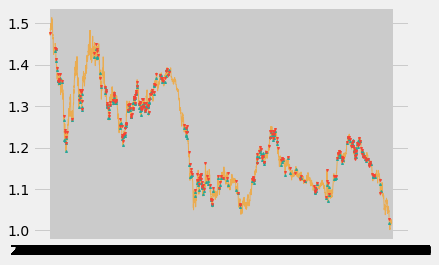

In [444]:
plt.figure()
plt.plot(pipspredv.index, pipspredv['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(pipspredv.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(pipspredv.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [445]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(pipspredv['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
        
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(pipspredv.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(pipspredv.index)

frames = [pipspredv['close'], pipspredv['log'], pipspredv['adap'], pipspredv['rand_std'], pipspredv['neur'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand_std,neur,algor_signal,algor_position
date,,,,,,,
2009-11-02,1.4769,-11.560676,-36.937015,-29.02,-1.319796,-1,0
2009-11-03,1.4715,4.126836,-18.888560,101.18,-0.895906,0,0
2009-11-04,1.4878,-12.204201,-34.068772,0.44,-1.849199,0,0
2009-11-05,1.4881,-3.179831,-28.591094,-14.96,-0.878083,0,0
2009-11-06,1.4849,-2.803198,-18.346398,59.05,-0.674133,0,0
...,...,...,...,...,...,...,...
2022-08-03,1.0164,0.823711,13.332835,45.08,0.113522,0,1
2022-08-04,1.0243,-1.038960,11.163837,45.81,-0.216608,0,1
2022-08-05,1.0181,0.794530,11.258718,43.91,0.411109,0,1


In [446]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(pipspredv['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/pipspredv['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 3 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 3 strategy by investing $100k in EURUSD : 128713.34
Profit percentage of the algoritmic 3 strategy : 128%


In [447]:
pipspredv['close']=df['close']
pipspredv

,real,log,adap,rand_std,neur,close
date,,,,,,
2009-11-02,-57.0,-11.560676,-36.937015,-29.02,-1.319796,1.4769
2009-11-03,147.0,4.126836,-18.888560,101.18,-0.895906,1.4715
2009-11-04,10.0,-12.204201,-34.068772,0.44,-1.849199,1.4878
2009-11-05,-20.0,-3.179831,-28.591094,-14.96,-0.878083,1.4881
2009-11-06,110.0,-2.803198,-18.346398,59.05,-0.674133,1.4849
...,...,...,...,...,...,...
2022-08-03,81.0,0.823711,13.332835,45.08,0.113522,1.0164
2022-08-04,-66.0,-1.038960,11.163837,45.81,-0.216608,1.0243
2022-08-05,16.0,0.794530,11.258718,43.91,0.411109,1.0181


### 5.2 Binario con bajo riesgo

In [448]:
pipspredv

,real,log,adap,rand_std,neur,close
date,,,,,,
2009-11-02,-57.0,-11.560676,-36.937015,-29.02,-1.319796,1.4769
2009-11-03,147.0,4.126836,-18.888560,101.18,-0.895906,1.4715
2009-11-04,10.0,-12.204201,-34.068772,0.44,-1.849199,1.4878
2009-11-05,-20.0,-3.179831,-28.591094,-14.96,-0.878083,1.4881
2009-11-06,110.0,-2.803198,-18.346398,59.05,-0.674133,1.4849
...,...,...,...,...,...,...
2022-08-03,81.0,0.823711,13.332835,45.08,0.113522,1.0164
2022-08-04,-66.0,-1.038960,11.163837,45.81,-0.216608,1.0243
2022-08-05,16.0,0.794530,11.258718,43.91,0.411109,1.0181


In [449]:
def implement_strategy4(close, log, adap, rand, neural):
    buy_price = []
    sell_price = []
    algor_signal = []
    signal = 0
    
    for i in range(len(close)):
        if log[i] > 0 and rand[i] > 0 and adap[i] > 0 and neural[i] > 0:
            if signal != 1:
                buy_price.append(close[i])
                sell_price.append(np.nan)
                signal = 1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        elif log[i] < 0 and rand[i] < 0 and adap[i] < 0 and neural[i] < 0:
            if signal != -1:
                buy_price.append(np.nan)
                sell_price.append(close[i])
                signal = -1
                algor_signal.append(signal)
            else:
                buy_price.append(np.nan)
                sell_price.append(np.nan)
                algor_signal.append(0)
        else:
            buy_price.append(np.nan)
            sell_price.append(np.nan)
            algor_signal.append(0)
            
    return buy_price, sell_price, algor_signal

buy_price, sell_price, algor_signal = implement_strategy4(pipspredv['close'], pipspredv['log'], pipspredv['adap'], pipspredv['rand_std'], pipspredv['neur'])

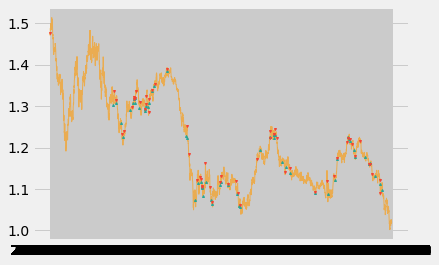

In [450]:
plt.figure()
plt.plot(pipspredv.index, pipspredv['close'], linewidth = 1, color = '#ff9800', alpha = 0.6, animated = True)
plt.plot(pipspredv.index, buy_price, marker = '^', color = '#26a69a', markersize = 2, linewidth = 0, label = 'BUY SIGNAL')
plt.plot(pipspredv.index, sell_price, marker = 'v', color = '#f44336', markersize = 2, linewidth = 0, label = 'SELL SIGNAL')
plt.show()

In [451]:
position = []
for i in range(len(algor_signal)):
    if algor_signal[i] > 1:
        position.append(0)
    else:
        position.append(1)
        
for i in range(len(pipspredv['close'])):
    if algor_signal[i] == 1:
        position[i] = 1
    elif algor_signal[i] == -1:
        position[i] = 0
    else:
        position[i] = position[i-1]
algor_signal = pd.DataFrame(algor_signal).rename(columns = {0:'algor_signal'}).set_index(pipspredv.index)
position = pd.DataFrame(position).rename(columns = {0:'algor_position'}).set_index(pipspredv.index)

frames = [pipspredv['close'], pipspredv['log'], pipspredv['adap'], pipspredv['rand_std'], pipspredv['neur'], algor_signal, position]
strategy = pd.concat(frames, join = 'inner', axis = 1)

strategy

,close,log,adap,rand_std,neur,algor_signal,algor_position
date,,,,,,,
2009-11-02,1.4769,-11.560676,-36.937015,-29.02,-1.319796,-1,0
2009-11-03,1.4715,4.126836,-18.888560,101.18,-0.895906,0,0
2009-11-04,1.4878,-12.204201,-34.068772,0.44,-1.849199,0,0
2009-11-05,1.4881,-3.179831,-28.591094,-14.96,-0.878083,0,0
2009-11-06,1.4849,-2.803198,-18.346398,59.05,-0.674133,0,0
...,...,...,...,...,...,...,...
2022-08-03,1.0164,0.823711,13.332835,45.08,0.113522,0,1
2022-08-04,1.0243,-1.038960,11.163837,45.81,-0.216608,0,1
2022-08-05,1.0181,0.794530,11.258718,43.91,0.411109,0,1


In [452]:
import math
from termcolor import colored as cl
algor_ret = pd.DataFrame(np.diff(pipspredv['close'])).rename(columns = {0:'returns'})
algor_strategy_ret = []

for i in range(len(algor_ret)):
    returns = algor_ret['returns'][i]*strategy['algor_position'][i]
    algor_strategy_ret.append(returns)
    
algor_strategy_ret_df = pd.DataFrame(algor_strategy_ret).rename(columns = {0:'algor_returns'})
investment_value = 100000
number_of_stocks = math.floor(investment_value/pipspredv['close'][-1])
algor_investment_ret = []

for i in range(len(algor_strategy_ret_df['algor_returns'])):
    returns = number_of_stocks*algor_strategy_ret_df['algor_returns'][i]
    algor_investment_ret.append(returns)

algor_investment_ret_df = pd.DataFrame(algor_investment_ret).rename(columns = {0:'investment_returns'})
total_investment_ret = round(sum(algor_investment_ret_df['investment_returns']), 2)
profit_percentage = math.floor((total_investment_ret/investment_value)*100)
print(cl('Profit gained from the algoritmic 4 strategy by investing $100k in EURUSD : {}'.format(total_investment_ret), attrs = ['bold']))
print(cl('Profit percentage of the algoritmic 4 strategy : {}%'.format(profit_percentage), attrs = ['bold']))

Profit gained from the algoritmic 4 strategy by investing $100k in EURUSD : 48006.76
Profit percentage of the algoritmic 4 strategy : 48%
